<h2 style="text-align:center">
Instituto Nacional de Pesquisas Espaciais, INPE <br>
Pós-Graduação em Computação Aplicada, CAP <br>

Name: Cesar Augusto de Moraes Costa

Institution: INPE.

Course: PhD in Applied Computing.

Subject: Geoinformatic.

Date: 27 may. 2025.

### Patches

In [1]:
import os
import numpy as np
from skimage import io, img_as_ubyte
from skimage.util import view_as_blocks
from skimage.io import imsave

def create_patches(image_path, output_dir, patch_size=64):
    # Carrega a imagem (pode ter múltiplos canais)
    img = io.imread(image_path)
    print(f"Imagem carregada: {img.shape}, dtype: {img.dtype}")

    # Se imagem for 2D, converte para 3D (canal único)
    if img.ndim == 2:
        img = img[..., np.newaxis]
    
    h, w, c = img.shape

    # Ajusta o tamanho para múltiplos exatos do patch_size
    h_crop = h - (h % patch_size)
    w_crop = w - (w % patch_size)
    img_cropped = img[:h_crop, :w_crop, :]
    print(f"Imagem recortada para múltiplos de {patch_size}: {img_cropped.shape}")

    # Divide a imagem em blocos (patches)
    blocks = view_as_blocks(img_cropped, block_shape=(patch_size, patch_size, c))
    print(f"Shape dos blocos: {blocks.shape}")

    n_rows, n_cols = blocks.shape[:2]

    # Cria diretório de saída se não existir
    os.makedirs(output_dir, exist_ok=True)

    patch_id = 0
    for i in range(n_rows):
        for j in range(n_cols):
            # Extrai patch, shape: (patch_size, patch_size, c)
            patch = blocks[i, j, 0]

            # Normaliza patch se float com valores fora do intervalo [0,1]
            if np.issubdtype(patch.dtype, np.floating):
                patch_min, patch_max = patch.min(), patch.max()
                if patch_min < 0 or patch_max > 1:
                    patch = (patch - patch_min) / (patch_max - patch_min)

            # Salva patch como uint8
            out_path = os.path.join(output_dir, f"patch_p{patch_id:04d}.tif")
            imsave(out_path, img_as_ubyte(patch))
            patch_id += 1

    print(f"{patch_id} patches salvos em {output_dir}")
    return n_rows, n_cols, h_crop, w_crop, c


In [2]:
image_path = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/raster_out_concatenate_charter_4t.tif'
output_dir = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_cenas'

# Criar patches - para remontar: n_rows, n_cols, h_crop, w_crop, c
n_rows, n_cols, h_crop, w_crop, c = create_patches(image_path, output_dir)



Imagem carregada: (2200, 3036, 12), dtype: float32
Imagem recortada para múltiplos de 64: (2176, 3008, 12)
Shape dos blocos: (34, 47, 1, 64, 64, 12)
1598 patches salvos em /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_cenas


In [3]:
image_path = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/floods_classes.tif'
output_dir = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes'

n_rows, n_cols, h_crop, w_crop, c = create_patches(image_path, output_dir)


Imagem carregada: (2200, 3036), dtype: float32
Imagem recortada para múltiplos de 64: (2176, 3008, 1)
Shape dos blocos: (34, 47, 1, 64, 64, 1)


/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p0000.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p0001.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p0002.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p0003.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p0004.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/

1598 patches salvos em /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes


/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p1225.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p1226.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p1234.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p1242.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/ipykernel_5245/4209738163.py:47: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes/patch_p1243.tif is a low contrast image
  imsave(out_path, img_as_ubyte(patch))
/tmp/

In [4]:
import os
import glob
import numpy as np
from skimage.io import imread

# Caminho para o diretório dos patches
output_dir = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_cenas'

# Lista de arquivos .tif ordenados
patch_files = sorted(glob.glob(os.path.join(output_dir, '*.tif')))

# Leitura dos patches
patches = [imread(f) for f in patch_files]
patches_array = np.array(patches)

# Se for imagem 2D (grayscale), adiciona eixo do canal
if patches_array.ndim == 3:
    patches_array = patches_array[..., np.newaxis]  # shape (N, 64, 64, 1)

print("Shape dos patches:", patches_array.shape)


Shape dos patches: (1598, 64, 64, 12)


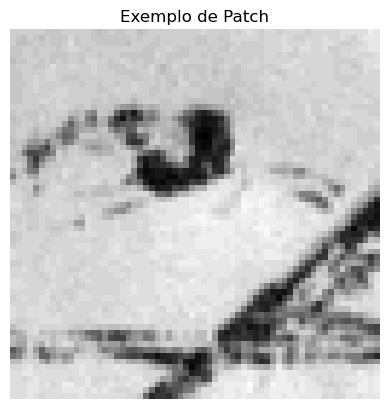

In [5]:
import matplotlib.pyplot as plt

plt.imshow(patches_array[44,:,:,0].squeeze(), cmap='gray')  # ou sem .squeeze() para RGB
plt.title("Exemplo de Patch")
plt.axis('off')
plt.show()


In [6]:
def reconstruct_image(patch_dir, n_rows, n_cols, patch_size=64):
    import glob
    from skimage.io import imread

    patch_files = sorted(glob.glob(os.path.join(patch_dir, '*.tif')))
    patches = [imread(p) for p in patch_files]
    patches = np.array(patches)

    if patches.ndim == 3:
        patches = patches[..., np.newaxis]

    h_patch, w_patch, c = patches[0].shape
    img = np.zeros((n_rows * h_patch, n_cols * w_patch, c), dtype=patches[0].dtype)

    for idx, patch in enumerate(patches):
        i = idx // n_cols
        j = idx % n_cols
        img[i*patch_size:(i+1)*patch_size, j*patch_size:(j+1)*patch_size, :] = patch

    return img


In [7]:
# Reconstruir imagem
reconstructed = reconstruct_image(output_dir, n_rows, n_cols)

# Salvar imagem reconstruída
# from skimage.io import imsave
# imsave('/home/cesar/geoinformatica/ConvLSTM_TempCNN/floods_classes_reconstructed.tif', reconstructed)

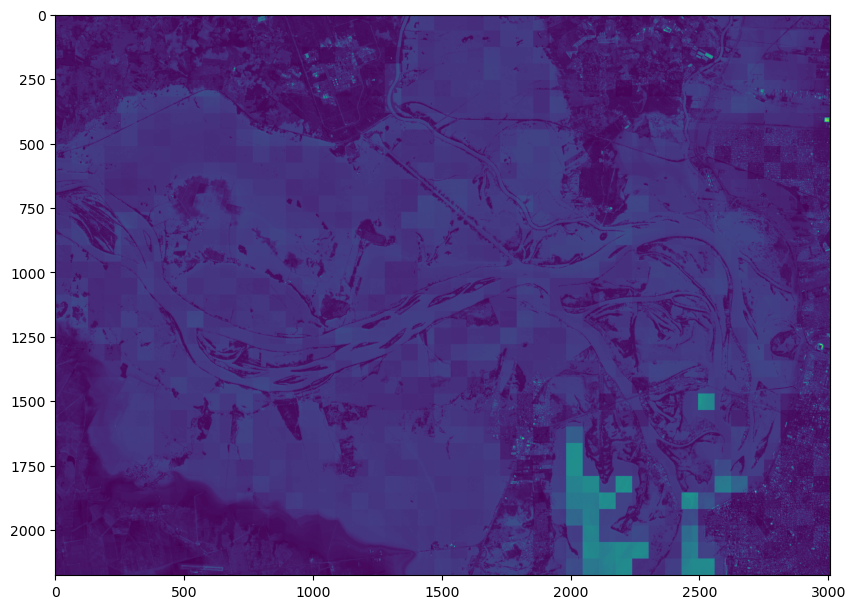

In [8]:
plt.figure(figsize=(10, 10))
plt.imshow(reconstructed[:,:,0])

In [9]:
##################################################################################

### Cross-validation K-fold
Verificação do desempenho em cada parte dos dados. Fazer novamente com mais GPU

----

## Leitura e visualização dos dados

###  Bibliotecas necessárias
<hr style="border:1px solid #7D26CD">

In [10]:
# Leitura das imagens
from skimage import io

import numpy as np
import time

import pandas as pd
from tensorflow.keras.preprocessing import image

# Machine Learning
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix
# Gráficos
import matplotlib.pyplot as plt
import random

tf.__version__

2025-06-04 00:17:22.865355: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-04 00:17:23.432281: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-06-04 00:17:23.645486: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-06-04 00:17:23.709740: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-06-04 00:17:24.129309: I tensorflow/core/platform/cpu_feature_guar

'2.17.0'

In [11]:
seed = 42
np.random.seed = seed
random.seed = seed
tf.random.set_seed(42)

In [12]:
import os
import glob
import numpy as np
from skimage import io

def read_image(image_path, mask=False):
    img = io.imread(image_path)
    if mask:
        # Para labels, apenas mantém a imagem original
        return img
    else:
        # Para imagens, normaliza para [0,1]
        return img / 255.0

def load_patches_and_labels(image_dir, label_dir):
    # Lista e ordena os arquivos para garantir a ordem correta
    image_paths = sorted(glob.glob(os.path.join(image_dir, '*.tif')))
    label_paths = sorted(glob.glob(os.path.join(label_dir, '*.tif')))

    # Lê os patches e armazena numa lista
    images = [read_image(patch_path, mask=False) for patch_path in image_paths]

    # Lê os labels e armazena numa lista
    labels = []
    for label_path in label_paths:
        mask = read_image(label_path, mask=True)
        # Opcional: binariza ou ajusta máscara, aqui garante que zeros continuem zeros
        mask = np.where(mask > 0, 1, 0)  
        labels.append(mask)

    # Converte listas em arrays numpy
    images = np.array(images)  # Forma: (num_patches, altura, largura, canais)
    labels = np.array(labels)  # Forma: (num_patches, altura, largura) ou (num_patches, altura, largura, 1)

    # Se os labels não tiverem canal, adiciona uma dimensão para compatibilidade com modelos
    if labels.ndim == 3:
        labels = labels[..., np.newaxis]

    print(f'Imagens shape: {images.shape}')
    print(f'Labels shape: {labels.shape}')

    return images, labels


# Exemplo de uso:a
sentinel2 = [
    '/home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_cenas',
    '/home/cesar/geoinformatica/ConvLSTM_TempCNN/Patches/patches_classes'
]

X, y = load_patches_and_labels(sentinel2[0], sentinel2[1])


Imagens shape: (1598, 64, 64, 12)
Labels shape: (1598, 64, 64, 1)


In [13]:
len(X), len(y)

(1598, 1598)

## Data augmentation

In [14]:
# Função para aplicar aumento de dados nos patches de cenas e classes
def data_augmentation(patche_cena, patche_classe, num_augmentations):
    augmented_cenas = []
    augmented_classes = []
    cont = len(patche_cena)
    for i in range(len(patche_cena)):
        cont -= 1
        # Replicar a amostra original tantas vezes quantas forem as augmentações desejadas
        for _ in range(num_augmentations):
            cena = patche_cena[i]
            classe = patche_classe[i]

            # Aplicar as transformações de aumento de dados
            # rotação aleatória no intervalo de -50 a 30 graus
            angle = np.random.randint(-50, 30)
            augmented_cena = np.rot90(cena, k=angle // 90, axes=(0, 1))
            augmented_classe = np.rot90(classe, k=angle // 90, axes=(0, 1))

            # espelhamento horizontal aleatório
            if np.random.rand() < 0.5:
                augmented_cena = np.fliplr(augmented_cena)
                augmented_classe = np.fliplr(augmented_classe)

            # espelhamento vertical aleatório
            if np.random.rand() < 0.5:
                augmented_cena = np.flipud(augmented_cena)
                augmented_classe = np.flipud(augmented_classe)
            
            if cont > len(patche_cena)/2 and np.count_nonzero(classe == 0):
                # adiciona amostras aumentadas às listas
                augmented_cenas.append(augmented_cena)
                augmented_classes.append(augmented_classe)
            # else:
            #     # adiciona amostras aumentadas às listas
            #     augmented_cenas.append(augmented_cena)
            #     augmented_classes.append(augmented_classe)
            

    # Transformar as listas em arrays numpy
    augmented_cenas = np.array(augmented_cenas)
    augmented_classes = np.array(augmented_classes)

    return augmented_cenas, augmented_classes


# Função para aplicar aumento de dados nos patches de cenas e classes
def data_augmentation_scenes(patche_cena, patche_classe, num_augmentations):
    augmented_cenas = []
    augmented_classes = []
    cont = len(patche_cena)
    for i in range(len(patche_cena)):
        cont -= 1
        # Replicar a amostra original tantas vezes quantas forem as augmentações desejadas
        for _ in range(num_augmentations):
            cena = patche_cena[i]
            classe = patche_classe[i]

            # Aplicar as transformações de aumento de dados
            # rotação aleatória no intervalo de -50 a 30 graus
            angle = np.random.randint(-50, 30)
            augmented_cena = np.rot90(cena, k=angle // 90, axes=(0, 1))
            augmented_classe = np.rot90(classe, k=angle // 90, axes=(0, 1))

            # 4. Ajuste de brilho (apenas nas cenas)
            if np.random.rand() < 0.5:
                factor = np.random.uniform(0.7, 1.3)
                augmented_cena = np.clip(augmented_cena * factor, 0, 255)

            # 5. Ajuste de contraste (apenas nas cenas)
            if np.random.rand() < 0.5:
                factor = np.random.uniform(0.8, 1.2)
                mean = augmented_cena.mean(axis=(0, 1), keepdims=True)
                augmented_cena = np.clip((augmented_cena - mean) * factor + mean, 0, 255)

            # 6. Adicionar ruído gaussiano (apenas nas cenas)
            if np.random.rand() < 0.5:
                noise = np.random.normal(0, 0.025, augmented_cena.shape)
                augmented_cena = np.clip(augmented_cena + noise, 0, 255)
            
            if np.count_nonzero(classe == 0):
                # adiciona amostras aumentadas às listas
                augmented_cenas.append(augmented_cena)
                augmented_classes.append(augmented_classe)
            # elif np.count_nonzero(classe == 0):
            #     # adiciona amostras aumentadas às listas
            #     augmented_cenas.append(augmented_cena)
            #     augmented_classes.append(augmented_classe)
            

    # Transformar as listas em arrays numpy
    augmented_cenas = np.array(augmented_cenas)
    augmented_classes = np.array(augmented_classes)

    return augmented_cenas, augmented_classes

# Transforma dataset original em array e faz divisão para augmentation e teste
# 50% test/train
patche_cena_ = np.array(X)
patche_classe_ = np.array(y)
len_patches = int(len(patche_classe_) * 0.38)
print(len_patches)
# teste separado
patche_cena_test = patche_cena_[:len_patches]
patche_classe_test = patche_classe_[:len_patches]
print('Ds para teste: ', patche_classe_test.shape)

patche_cena = patche_cena_[len_patches:]
patche_classe = patche_classe_[len_patches:]
print('Ds para augmentation: ', patche_classe.shape)

# Embaralha dados -- ficou melhor
from sklearn.utils import shuffle
def embaralha(x, y, seed=42):
  x, y = shuffle(x, y, random_state=seed)
  return x, y

patche_cena, patche_classe = embaralha(patche_cena, patche_classe)

# Definir o número de augmentações desejadas para cada amostra
num_augmentations = 4

# Aplicar o aumento de dados
patche_cena_augmented, patche_classe_augmented = data_augmentation(patche_cena, patche_classe, num_augmentations)

# Verifique as dimensões dos arrays resultantes
print('Dados aumentados:')
print(patche_cena_augmented.shape)
print(patche_classe_augmented.shape)

# Juntar os dados aumentados com os dados originais
print('Dados aumentados mais dados originais:')
patche_cena_combined_ = np.concatenate((patche_cena, patche_cena_augmented), axis=0)
patche_classe_combined_ = np.concatenate((patche_classe, patche_classe_augmented), axis=0)

# Aplicar mais aumento de dados
patche_cena_augmented, patche_classe_augmented = data_augmentation_scenes(patche_cena, patche_classe, num_augmentations)

patche_cena_combined = np.concatenate((patche_cena_combined_, patche_cena_augmented), axis=0)
patche_classe_combined = np.concatenate((patche_classe_combined_, patche_classe_augmented), axis=0)

# Verifique as dimensões dos arrays resultantes
print(patche_cena_combined.shape)
print(patche_classe_combined.shape)


607
Ds para teste:  (607, 64, 64, 1)
Ds para augmentation:  (991, 64, 64, 1)
Dados aumentados:
(1712, 64, 64, 12)
(1712, 64, 64, 1)
Dados aumentados mais dados originais:
(6143, 64, 64, 12)
(6143, 64, 64, 1)


In [15]:
import numpy as np

# Contar os valores únicos e suas ocorrências
unique, counts = np.unique(patche_classe_combined, return_counts=True)
print('Dataset de treinamento com aumento de dados.')
# Exibir os resultados
for value, count in zip(unique, counts):
    print(f'Número de pixels com valor {value}: {count}')

Dataset de treinamento com aumento de dados.
Número de pixels com valor 0: 14076838
Número de pixels com valor 1: 11084890


In [16]:
import numpy as np

# Contar os valores únicos e suas ocorrências
unique, counts = np.unique(patche_classe_test, return_counts=True)
print('Dataset de test.')
# Exibir os resultados
for value, count in zip(unique, counts):
    print(f'Número de pixels com valor {value}: {count}')

Dataset de test.
Número de pixels com valor 0: 1194076
Número de pixels com valor 1: 1292196


In [17]:
# variáveis para contar inundações e não inundações nos patches
floods = 0
no_floods = 0

for i in range(len(patche_classe)):

  classe = patche_classe[i]
  # print(classe)
  # Verifica valor diferente de 0 na matriz para inundações
  if np.any(classe != 0):
    floods += 1
  else:
    no_floods += 1
#quantidade de inundações e não inundações
print(f'Dataset original \nNúmeros de inundações: {floods}; Número de não-inundações: {no_floods}.')

Dataset original 
Números de inundações: 794; Número de não-inundações: 197.


In [18]:
# variáveis para contar inundações e não inundações nos patches
floods = 0
no_floods = 0

for i in range(len(patche_classe_test)):

  classe_test = patche_classe_test[i]
  # print(classe_test)
  # Verifica valor diferente de 0 na matriz para inundações
  if np.any(classe_test != 0):
    floods += 1
  else:
    no_floods += 1
#quantidade de inundações e não inundações
print(f'Dataset separado de test \nNúmeros de inundações: {floods}; Número de não-inundações: {no_floods}.')

Dataset separado de test 
Números de inundações: 434; Número de não-inundações: 173.


In [19]:
# variáveis para contar 
landslide = 0
no_landslide = 0

for i in range(len(patche_classe_combined)):

  classe = patche_classe_combined[i]
  # print(classe)
  # Verifica valor diferente de 0 na matriz 
  if np.any(classe != 0):
    landslide += 1
  else:
    no_landslide += 1
#quantidade de inudações e não inudações
print(f'Data augmentation \nNúmeros de inundação: {landslide}; Número de não-inudações: {no_landslide}.')


Data augmentation 
Números de inundação: 4774; Número de não-inudações: 1369.


### Visualizar patches das cenas e classes

In [20]:
patche_cena_combined.shape, patche_classe_combined.shape

((6143, 64, 64, 12), (6143, 64, 64, 1))

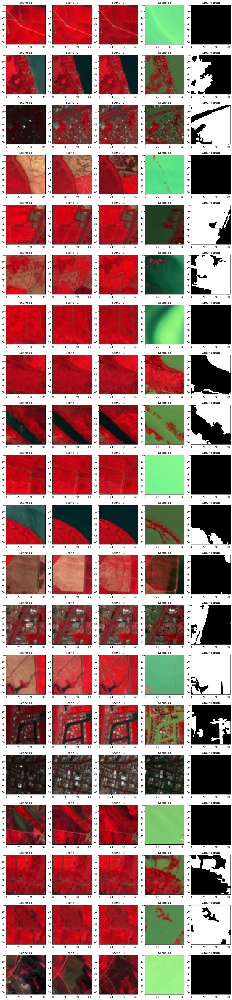

In [21]:
import matplotlib.pyplot as plt
import numpy as np

# Original
# Função para visualização das imagens
def visualize_images(num_rows, random_indices):
    fig, axes = plt.subplots(num_rows, 5, figsize=(14, 3*num_rows))

    for i in range(num_rows):
        idx = random_indices[i]

        # # Stack 
        image_t1 = np.stack([patche_cena[idx, :, :, 11], patche_cena[idx, :, :, 10],
                                 patche_cena[idx, :, :, 9]], axis=2)
        
        image_t2 = np.stack([patche_cena[idx, :, :, 8], patche_cena[idx, :, :, 7],
                                 patche_cena[idx, :, :, 6]], axis=2)

        image_t3 = np.stack([patche_cena[idx, :, :, 5], patche_cena[idx, :, :, 4],
                                 patche_cena[idx, :, :, 3]], axis=2)

        image_t4 = np.stack([patche_cena[idx, :, :, 2], patche_cena[idx, :, :, 1],
                                 patche_cena[idx, :, :, 0]], axis=2)

        # Normalização das imagens RGB
        image_t1 = image_t1 / image_t1.max()
        image_t2 = image_t2 / image_t2.max()
        image_t3 = image_t3 / image_t3.max()
        image_t4 = image_t4 / image_t4.max()

        # Predições
        ground_truth = np.squeeze(patche_classe[idx])

        # Plotar as imagens
        axes[i, 0].imshow(image_t1, cmap='gray')
        axes[i, 0].set_title('Scene T1')
        # axes[i, 0].axis('off')
        
        axes[i, 1].imshow(image_t2, cmap='gray')
        axes[i, 1].set_title('Scene T2')
        # axes[i, 0].axis('off')
        
        axes[i, 2].imshow(image_t3, cmap='gray')
        axes[i, 2].set_title('Scene T3')
        # axes[i, 2].axis('off')
        
        axes[i, 3].imshow(image_t4, cmap='gray')
        axes[i, 3].set_title('Scene T4')
        # axes[i, 3].axis('off')
        
        axes[i, 4].imshow(ground_truth, cmap='gray')
        axes[i, 4].set_title('Ground truth')
        # axes[i, 2].axis('off')


    plt.tight_layout()
    plt.show()

# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
indices = [31,32,33,34,35,36,40,41,42,43,45,46,47,48,55,56,57,58,59,88]
random_indices = np.random.randint(0, patche_cena.shape[0], num_samples)

# Visualizar as cenas e as classes lado a lado
visualize_images(num_samples, indices)


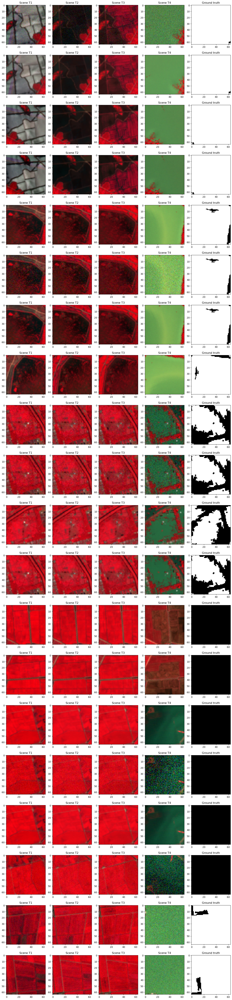

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

#Augmentarion
# Função para visualização das imagens
def visualize_images(num_rows, random_indices):
    fig, axes = plt.subplots(num_rows, 5, figsize=(14, 3*num_rows))

    for i in range(num_rows):
        idx = random_indices[i]

        # # Stack 
        image_t1 = np.stack([patche_cena_augmented[idx, :, :, 11], patche_cena_augmented[idx, :, :, 10],
                                 patche_cena_augmented[idx, :, :, 9]], axis=2)
        
        image_t2 = np.stack([patche_cena_augmented[idx, :, :, 8], patche_cena_augmented[idx, :, :, 7],
                                 patche_cena_augmented[idx, :, :, 6]], axis=2)

        image_t3 = np.stack([patche_cena_augmented[idx, :, :, 5], patche_cena_augmented[idx, :, :, 4],
                                 patche_cena_augmented[idx, :, :, 3]], axis=2)

        image_t4 = np.stack([patche_cena_augmented[idx, :, :, 2], patche_cena_augmented[idx, :, :, 1],
                                 patche_cena_augmented[idx, :, :, 0]], axis=2)

        # Normalização das imagens RGB
        image_t1 = image_t1 / image_t1.max()
        image_t2 = image_t2 / image_t2.max()
        image_t3 = image_t3 / image_t3.max()
        image_t4 = image_t4 / image_t4.max()

        # Predições
        ground_truth = np.squeeze(patche_classe_augmented[idx])

        # Plotar as imagens
        axes[i, 0].imshow(image_t1, cmap='gray')
        axes[i, 0].set_title('Scene T1')
        # axes[i, 0].axis('off')
        
        axes[i, 1].imshow(image_t2, cmap='gray')
        axes[i, 1].set_title('Scene T2')
        # axes[i, 0].axis('off')
        
        axes[i, 2].imshow(image_t3, cmap='gray')
        axes[i, 2].set_title('Scene T3')
        # axes[i, 2].axis('off')
        
        axes[i, 3].imshow(image_t4, cmap='gray')
        axes[i, 3].set_title('Scene T4')
        # axes[i, 3].axis('off')
        
        axes[i, 4].imshow(ground_truth, cmap='gray')
        axes[i, 4].set_title('Ground truth')
        # axes[i, 2].axis('off')

        
    plt.tight_layout()
    plt.show()

# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
indices = [32,33,34,35,40,41,42,43,44,45,46,47,48,49,56,57,58,59,88,89]
random_indices = np.random.randint(0, patche_cena.shape[0], num_samples)

# Visualizar as cenas e as classes lado a lado
visualize_images(num_samples, indices)


In [23]:
del unique, counts, X, y, patche_cena_combined_, patche_classe_combined_,  len_patches

del patche_cena_augmented, patche_classe_augmented

## Tensorflow Keras
### Modelo de Segmentação Semântica utilizando Keras para classificação pixel a pixel de patches de imagens bitempotais de inundações da catastrofe do Rio Grande do Sul em 2024. A ideia desse projeto foi utilizar a  arquitetura de Segmentação Semântica TempCNN, usada para classificação de uso e cobertura da Terra, aplicanda neste estudo para o domínio de desastre de inundação.
<hr style="border:1px solid #7D26CD">

In [21]:
patche_cena_combined.shape, patche_classe_combined.shape

((6143, 64, 64, 12), (6143, 64, 64, 1))

## Construção da rede neural

#### Função de perda de entropia cruzada.
##### É usada quando houver duas ou mais classes de rótulos. Esperando que os rótulos sejam fornecidos como ```números inteiros```. Se você quiser fornecer rótulos usando representação one-hot (propenso a criar muitos preditores), use CategoricalCrossentropy loss. Deve haver \# classes valores de ponto flutuante por recurso para y_pred e um único valor de ponto flutuante por recurso para y_true [4].

## Treinamento com validação de 20%

In [20]:
np.unique(patche_classe_combined)  

array([0, 1])

In [21]:
def criar_diretorio(caminho):
  if not os.path.exists(caminho):
    os.makedirs(caminho)
path_modelo = 'modelos'
criar_diretorio(path_modelo)

In [22]:
############### TempCNN
from tensorflow.keras.backend import clear_session

# Limpar a sessão atual do Keras
clear_session()


In [23]:
import tensorflow as tf
from tensorflow.keras import backend as K

# Fechar a sessão do TensorFlow
K.clear_session()

# Resetar a memória da GPU
tf.config.experimental.reset_memory_stats('GPU:0')


I0000 00:00:1749007087.796670    5245 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1749007088.178326    5245 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1749007088.182391    5245 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1749007088.206097    5245 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

In [24]:
import tensorflow as tf

def iou(y_true, y_pred):
    # Caso y_pred esteja em formato de probabilidade, convertemos para rótulos de classe
    if y_pred.shape[-1] > 1:
        y_pred = tf.argmax(y_pred, axis=-1)
        y_pred = tf.expand_dims(y_pred, axis=-1)  # Expandir para corresponder a y_true

    if y_true.shape[-1] > 1:
        y_true = tf.argmax(y_true, axis=-1)
        y_true = tf.expand_dims(y_true, axis=-1)  # Expandir para corresponder a y_pred

    y_true = tf.cast(y_true, tf.int64)
    y_pred = tf.cast(y_pred, tf.int64)

    # Calcular interseção e união
    intersection = tf.reduce_sum(tf.cast(tf.logical_and(tf.equal(y_true, 1), tf.equal(y_pred, 1)), tf.float32))
    union = tf.reduce_sum(tf.cast(tf.logical_or(tf.equal(y_true, 1), tf.equal(y_pred, 1)), tf.float32))

    return intersection / (union + tf.keras.backend.epsilon())

tf.keras.utils.get_custom_objects().update({"iou": iou})

In [25]:
import tensorflow as tf
from tensorflow.keras import backend as K

def dice_coef(y_true, y_pred):
    """
    Calcula o Dice Coefficient (F1-Score) para segmentação.
    Compatível com formatos one-hot ou class labels.
    
    Args:
        y_true: Ground truth (rótulos reais)
        y_pred: Predições do modelo (probabilidades ou classes)
    
    Returns:
        Dice coefficient score
    """
    # Converter para classes se necessário (para one-hot encoding)
    if y_pred.shape[-1] > 1:
        y_pred = tf.argmax(y_pred, axis=-1)
    if y_true.shape[-1] > 1:
        y_true = tf.argmax(y_true, axis=-1)
    
    # Converter para float32 e achatar os tensores
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    
    # Criar máscaras binárias para a classe positiva (assumindo classe 1)
    y_true_pos = tf.cast(tf.equal(y_true, 1), tf.float32)
    y_pred_pos = tf.cast(tf.equal(y_pred, 1), tf.float32)
    
    # Calcular interseção e soma
    intersection = tf.reduce_sum(y_true_pos * y_pred_pos)
    sum_counts = tf.reduce_sum(y_true_pos) + tf.reduce_sum(y_pred_pos)
    
    # Calcular Dice score com suavização para evitar divisão por zero
    dice = (2. * intersection + K.epsilon()) / (sum_counts + K.epsilon())
    
    return dice

# Registrar a métrica para uso no modelo
tf.keras.utils.get_custom_objects().update({"dice_coef": dice_coef})

In [26]:
import numpy as np
from tensorflow.keras.utils import to_categorical


def one_hot_encode_labels(labels, num_classes):
    return to_categorical(labels, num_classes)

def reshape_data(X, target_channels):
    """
    Reorganiza os dados para a forma desejada com base no número de canais.
    """
    # Verifique a forma atual
    n_samples = X.shape[0]
    height = X.shape[1]
    width = X.shape[2]
    current_channels = X.shape[3]

    # Verifique se o número de canais especificado é compatível
    if current_channels != target_channels:
        raise ValueError("O número de canais especificado não é compatível com a forma dos dados.")

    # Adicione uma dimensão de tempo fictícia se necessário (por exemplo, para uma rede com dimensão temporal)
    return X.reshape(n_samples, 1, height, width, current_channels)  # Adiciona uma dimensão de tempo


In [27]:
patche_cena_test.shape #(607, 64, 64, 12)

(607, 64, 64, 12)

## Treino e validação para apresentar desempenho - TempCNN e ConvLSTM

In [30]:
import keras
from keras import layers
from keras import optimizers
from keras.regularizers import l2
from keras.layers import Input, Dense, Activation, BatchNormalization, Dropout, Flatten, Lambda, SpatialDropout1D, Concatenate, Conv3D
from keras.layers import Conv1D, Conv2D, AveragePooling1D, MaxPooling1D, GlobalMaxPooling1D, GlobalAveragePooling1D, GRU, Bidirectional
from keras.callbacks import Callback, ModelCheckpoint, History, EarlyStopping
from keras.models import Model, load_model
from keras.utils import to_categorical
from keras import backend as K
import time
import numpy as np

def softmax(X, nbclasses, **params):
    kernel_regularizer = params.setdefault("kernel_regularizer", l2(1.e-5))
    kernel_initializer = params.setdefault("kernel_initializer", "glorot_uniform")
    return Dense(nbclasses, activation='softmax',
                 kernel_initializer=kernel_initializer,
                 kernel_regularizer=kernel_regularizer)(X)


def conv3d_bn_relu_drop(x, nbunits, kernel_size, kernel_regularizer, dropout_rate):
    x = Conv3D(nbunits, kernel_size, padding='same', kernel_regularizer=kernel_regularizer)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = Dropout(dropout_rate)(x)
    return x

def Archi_TempCNN(input_shape, nbclasses):
    l2_rate = 1.e-6
    dropout_rate = 0.2

    nb_conv = 3
    nbunits_conv = 64

    X_input = Input(input_shape)
    X = X_input
    for _ in range(nb_conv):
        X = conv3d_bn_relu_drop(X, nbunits=nbunits_conv, kernel_size=(3, 3, 3), kernel_regularizer=l2(l2_rate), dropout_rate=dropout_rate)

    # Camada SOFTMAX
    out = softmax(X, nbclasses, kernel_regularizer=l2(l2_rate))

    # Criar o modelo
    return Model(inputs=X_input, outputs=out, name='Archi_TempCNN')



In [31]:
import numpy as np
from tensorflow.keras.utils import to_categorical

# Dimensões
nbclasses = 2  # Número de classes
n_bands = 12
l_patche = 64
input_shape = (1, l_patche, l_patche, n_bands)  # Ajuste conforme necessário


# Reshape patche_cena_combined 
patche_cena_combined_reshape = patche_cena_combined.reshape(patche_cena_combined.shape[0],patche_cena_combined.shape[1],patche_cena_combined.shape[2],patche_cena_combined.shape[3])
# patche_cena_combined_reshape_.shape 

# One-hot encoding das labels - patche_classe_combined
y_train_onehot_ = one_hot_encode_labels(patche_classe_combined, nbclasses)
print('Forma de y_train após onehot:', y_train_onehot_.shape)

# Aplicar a função
X_train_reshaped = reshape_data(patche_cena_combined_reshape, n_bands)
print('Forma de X_train após reshape:', X_train_reshaped.shape)

def one_hot_encode_labels(labels, num_classes):
    return np.expand_dims(to_categorical(labels, num_classes=num_classes), axis=1)


# Divida os dados restantes em treino (80%) e validação (20%)
X_train, X_val = np.split(
    patche_cena_combined_reshape,
    [int(.8 * len(patche_cena_combined_reshape))]  # 80% dos dados para treino
)
y_train, y_val = np.split(
    patche_classe_combined,
    [int(.8 * len(patche_classe_combined))]  # 80% dos rótulos para treino
)

# Verificar tamanhos
print(f"Tamanho do conjunto de treino: {len(X_train)}")
print(f"Tamanho do conjunto de validação: {len(X_val)}")


print("Forma original de patche_cena_combined_reshape:", patche_cena_combined_reshape.shape)
print('X_train: ', X_train.shape)

# One-hot encoding das labels
nbclasses = 2  # Ajuste o número de classes conforme necessário

y_train_onehot = one_hot_encode_labels(y_train, nbclasses)
y_val_onehot = one_hot_encode_labels(y_val, nbclasses)

def reshape_data(X, target_channels):
    """
    Reorganiza os dados para a forma desejada com base no número de canais.
    """
    # Verifique a forma atual
    n_samples = X.shape[0]
    height = X.shape[1]
    width = X.shape[2]
    current_channels = X.shape[3]

    # Verifique se o número de canais especificado é compatível
    if current_channels != target_channels:
        raise ValueError("O número de canais especificado não é compatível com a forma dos dados.")

    # Adicione uma dimensão de tempo fictícia se necessário (por exemplo, para uma rede com dimensão temporal)
    return X.reshape(n_samples, 1, height, width, current_channels)  # Adiciona uma dimensão de tempo

n_bands = 12
# Aplicar a função
X_train_reshaped = reshape_data(X_train, n_bands)
X_val_reshaped = reshape_data(X_val, n_bands)

print('Forma de X_train após reshape:', X_train_reshaped.shape)
print('Forma de X_val após reshape:', X_val_reshaped.shape)

n_epochs=300

# Tamanho do conjunto de treino: 4914
# Tamanho do conjunto de validação: 1229
# Forma original de patche_cena_combined_reshape: (6143, 64, 64, 12)
# X_train:  (4914, 64, 64, 12)
# Forma de X_train após reshape: (4914, 1, 64, 64, 12)
# Forma de X_val após reshape: (1229, 1, 64, 64, 12)

Forma de y_train após onehot: (6143, 64, 64, 2)
Forma de X_train após reshape: (6143, 1, 64, 64, 12)
Tamanho do conjunto de treino: 4914
Tamanho do conjunto de validação: 1229
Forma original de patche_cena_combined_reshape: (6143, 64, 64, 12)
X_train:  (4914, 64, 64, 12)
Forma de X_train após reshape: (4914, 1, 64, 64, 12)
Forma de X_val após reshape: (1229, 1, 64, 64, 12)


In [36]:
# --- Average Pooling
from tensorflow.keras.optimizers import Adam
from keras.regularizers import l2
from keras.layers import Input, Dense, Activation, BatchNormalization, Dropout, Flatten, Lambda, SpatialDropout1D, Concatenate, Conv3D
from keras.layers import Conv1D, Conv2D, AveragePooling1D, MaxPooling1D, GlobalMaxPooling1D, GlobalAveragePooling1D, GRU, Bidirectional, AveragePooling3D
from keras.callbacks import Callback, ModelCheckpoint, History, EarlyStopping
from keras.models import Model, load_model
from keras.utils import to_categorical
from keras import backend as K
import time
import numpy as np
import json


def softmax(X, nbclasses, **params):
    kernel_regularizer = params.setdefault("kernel_regularizer", l2(1.e-5))
    kernel_initializer = params.setdefault("kernel_initializer", "glorot_uniform")
    return Dense(nbclasses, activation='softmax',
                 kernel_initializer=kernel_initializer,
                 kernel_regularizer=kernel_regularizer)(X)


def conv3d_bn_relu_drop(x, nbunits, kernel_size, kernel_regularizer, dropout_rate):
    x = Conv3D(nbunits, kernel_size, padding='same', kernel_regularizer=kernel_regularizer)(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = Dropout(dropout_rate)(x)
    return x

def Archi_TempCNN_with_AvgPool(input_shape, nbclasses):
    l2_rate = 1.e-4
    dropout_rate = 0.2

    nb_conv = 3
    nbunits_conv = 64

    X_input = Input(input_shape)
    X = X_input
    for _ in range(nb_conv):
        X = conv3d_bn_relu_drop(X, nbunits=nbunits_conv, kernel_size=(3, 3, 3), kernel_regularizer=l2(l2_rate), dropout_rate=dropout_rate)

    # --- Adicionando Average Pooling 3D --- 
    # Assumindo que a dimensão de profundidade (temporal) é 1 e queremos fazer pooling espacial.
    # Ajuste pool_size conforme necessário, por exemplo (1, 2, 2) para pooling espacial 2x2.
    X = AveragePooling3D(pool_size=(1, 2, 2), padding='same', name='avg_pool3d')(X)
    
    # --- Adicionando Flatten antes da camada Dense --- 
    X = Flatten(name='flatten')(X)

    # Camada SOFTMAX
    out = softmax(X, nbclasses, kernel_regularizer=l2(l2_rate))

    # Criar o modelo
    return Model(inputs=X_input, outputs=out, name='Archi_TempCNN_with_AvgPool')

print("Arquivo com a arquitetura TempCNN modificada (Archi_TempCNN_with_AvgPool) foi criado.")
print("A camada AveragePooling3D foi adicionada após as convoluções e uma camada Flatten antes da camada softmax.")



Arquivo com a arquitetura TempCNN modificada (Archi_TempCNN_with_AvgPool) foi criado.
A camada AveragePooling3D foi adicionada após as convoluções e uma camada Flatten antes da camada softmax.


In [37]:
callbacks = [ModelCheckpoint(path_modelo + '/modelo_tempcnn_{epoch:02d}.keras', verbose=1, save_best_only=True),
             EarlyStopping(monitor='val_loss', patience=75)]
# Definir o input_shape e o número de classes
l_patche = 64
n_bands = 12
input_shape = (1, l_patche, l_patche, n_bands)  # Ajuste conforme necessário
nbclasses = 2  # Ajuste conforme necessário

# Criar o modelo TempCNN
model_tempcnn = Archi_TempCNN(input_shape, nbclasses)

# Compilar o modelo
model_tempcnn.compile(optimizer=Adam(learning_rate=1e-3),
              loss='categorical_crossentropy',
              metrics=['accuracy', iou, dice_coef])

# Exibir o resumo do modelo
model_tempcnn.summary()

# Treinar o modelo
history_tempcnn = model_tempcnn.fit(X_train_reshaped, y_train_onehot,
                    validation_data=(X_val_reshaped, y_val_onehot),
                    epochs=n_epochs,  # Ajuste o número de épocas conforme necessário
                    batch_size=32,  # Ajuste o tamanho do batch conforme necessário
                    callbacks=callbacks,
                    verbose=1)



# Salva o histórico em um arquivo JSON
with open('historico_treinamento_tempcnn.json', 'w') as f:
    json.dump(history_tempcnn.history, f)  # history.history é um dicionário

# # Carrega o histórico
# with open('historico_treinamento.json', 'r') as f:
#     history = json.load(f)


Model: "Archi_TempCNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 1, 64, 64, 12)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d (Conv3D)                 │ (None, 1, 64, 64, 64)  │        20,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1, 64, 64, 64)  │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_1 (Conv3D)               │ (None, 1, 64, 64, 64)  │       110,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 1, 64, 64, 64)  │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3d_2 (Conv3D)               │ (None, 1, 64, 64, 64)  │       110,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 1, 64, 64, 64)  │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1, 64, 64, 2)   │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 243,010 (949.26 KB)

 Trainable params: 242,626 (947.76 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/300


I0000 00:00:1748956793.884127  354323 service.cc:146] XLA service 0x7fa860013500 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1748956793.884993  354323 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 3050 Laptop GPU, Compute Capability 8.6
2025-06-03 10:19:54.101008: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-06-03 10:19:54.516053: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8902


  2/154 ━━━━━━━━━━━━━━━━━━━━ 11s 77ms/step - accuracy: 0.5488 - dice_coef: 0.5396 - iou: 0.3717 - loss: 0.8327

I0000 00:00:1748956801.450726  354323 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


154/154 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.8645 - dice_coef: 0.8476 - iou: 0.7452 - loss: 0.3430
Epoch 1: val_loss improved from inf to 0.76606, saving model to modelos/modelo_tempcnn_01.keras
154/154 ━━━━━━━━━━━━━━━━━━━━ 28s 127ms/step - accuracy: 0.8647 - dice_coef: 0.8478 - iou: 0.7455 - loss: 0.3426 - val_accuracy: 0.4710 - val_dice_coef: 0.5945 - val_iou: 0.4320 - val_loss: 0.7661
Epoch 2/300
153/154 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.9063 - dice_coef: 0.8905 - iou: 0.8036 - loss: 0.2590
Epoch 2: val_loss improved from 0.76606 to 0.58014, saving model to modelos/modelo_tempcnn_02.keras
154/154 ━━━━━━━━━━━━━━━━━━━━ 10s 66ms/step - accuracy: 0.9063 - dice_coef: 0.8905 - iou: 0.8036 - loss: 0.2590 - val_accuracy: 0.6302 - val_dice_coef: 0.6736 - val_iou: 0.5170 - val_loss: 0.5801
Epoch 3/300
153/154 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.9082 - dice_coef: 0.8925 - iou: 0.8068 - loss: 0.2520
Epoch 3: val_loss improved from 0.58014 to 0.30343, saving 

In [30]:
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from sklearn.metrics import roc_curve, auc
import numpy as np

def plot_metric(histories, metric_name, title, colors):
    plt.figure(figsize=(9, 5))
    
    # Mapeamento de nomes de métricas para labels
    metric_labels = {
        'accuracy': 'Accuracy',
        'loss': 'Loss',
        'iou': 'IoU',
        'dice_coef': 'Dice Coefficient'
    }
    
    y_label = metric_labels.get(metric_name, metric_name)
    
    for idx, (model_name, history_dict) in enumerate(histories.items()):
        if metric_name in history_dict:
            plt.plot(history_dict[metric_name], colors[idx][0], 
                    linewidth=2, label=f'{model_name} Training')
            plt.plot(history_dict[f'val_{metric_name}'], colors[idx][1], 
                    linewidth=2, linestyle='--', label=f'{model_name} Validation')
    
    plt.legend(fontsize=10, framealpha=0.9)
    plt.title(title, fontsize=12, pad=15, fontweight='bold')
    
    # Nomes dos eixos
    plt.xlabel('Epochs', fontsize=11, fontweight='bold', labelpad=10)
    plt.ylabel(y_label, fontsize=11, fontweight='bold', labelpad=10)
    
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.gca().yaxis.set_major_locator(MaxNLocator(integer=False))
    plt.grid(True, linestyle=':', alpha=0.7)
    plt.tight_layout()
    plt.show()

def evaluate_and_plot(y_true, model_predictions, histories=None, title="Model Comparison"):
    plt.figure(figsize=(10, 7))
    plt.title(f'ROC Curve - {title}', fontsize=13, pad=20, fontweight='bold')
    
    for model_name, y_pred in model_predictions.items():
        fpr, tpr, _ = roc_curve(y_true.ravel(), y_pred.ravel())
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, linewidth=2.5, 
                label=f'{model_name} (AUC = {roc_auc:.3f})')
    
    plt.plot([0, 1], [0, 1], 'k--', linewidth=1.5, alpha=0.5)
    
    plt.xlabel('False Positive Rate (FPR)', 
              fontsize=11, fontweight='bold', labelpad=10)
    plt.ylabel('True Positive Rate (TPR)', 
              fontsize=11, fontweight='bold', labelpad=10)
    
    plt.legend(fontsize=10, loc='lower right', framealpha=0.9)
    plt.grid(True, linestyle=':', alpha=0.5)
    plt.xlim([-0.01, 1.01])
    plt.ylim([-0.01, 1.01])
    plt.tight_layout()
    plt.show()
    
    if histories:
        colors = [
            ('#1f77b4', '#aec7e8'),  # Azul
            ('#ff7f0e', '#ffbb78'),   # Laranja
            ('#2ca02c', '#98df8a'),   # Verde
            ('#9467bd', '#c5b0d5')    # Roxo
        ]
        
        plot_metric(histories, 'accuracy', 'Training and Validation Accuracy', colors)
        plot_metric(histories, 'loss', 'Training and Validation Loss', colors)
        
        # Verifica se IoU existe em algum dos históricos
        if any('iou' in h for h in histories.values()):
            plot_metric(histories, 'iou', 'Intersection over Union (IoU)', colors)
        
        # Verifica se dice_coef existe em algum dos históricos
        if any('dice_coef' in h for h in histories.values()):
            plot_metric(histories, 'dice_coef', 'Training and Validation Dice Coefficient', colors)

In [31]:
from tensorflow.keras.utils import CustomObjectScope
from tensorflow.keras.models import load_model
import json


# # Carrega o histórico
with open('historico_treinamento_tempcnn.json', 'r') as f:
    history_tempcnn = json.load(f)

model_tempcnn = load_model('/home/cesar/geoinformatica/ConvLSTM_TempCNN/ultimos_notebooks/modelos/modelo_tempcnn_214.keras')

print(history_tempcnn.keys())

dict_keys(['accuracy', 'dice_coef', 'iou', 'loss', 'val_accuracy', 'val_dice_coef', 'val_iou', 'val_loss'])


19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step


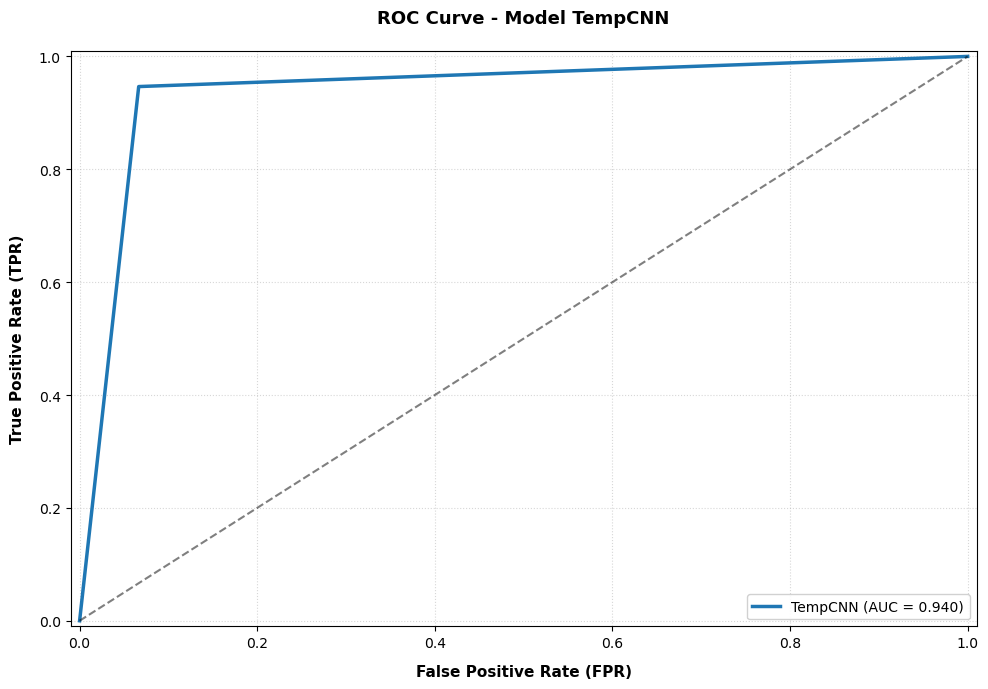

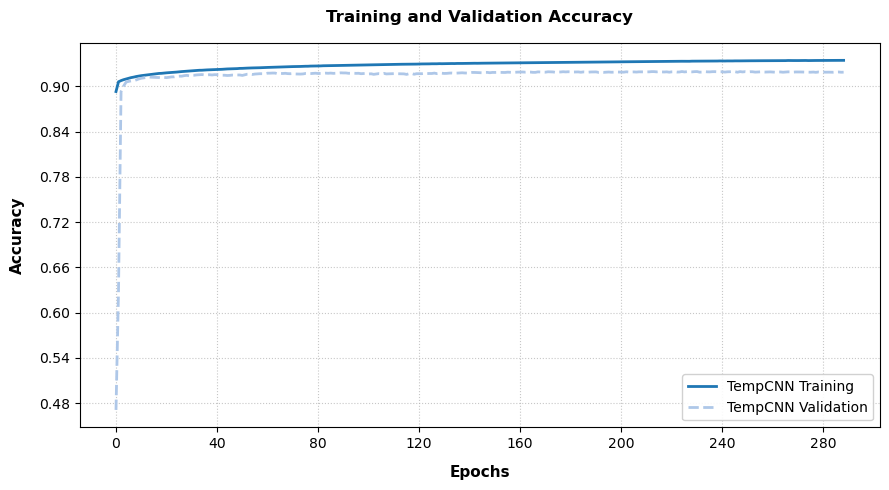

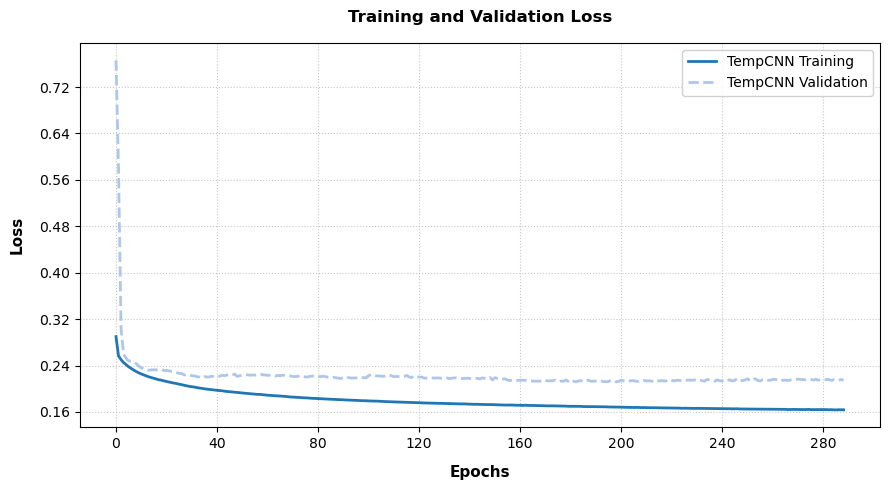

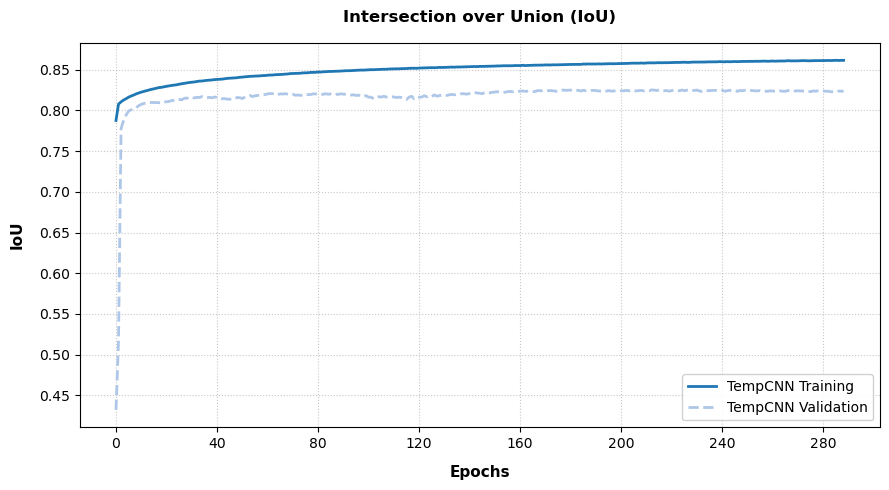

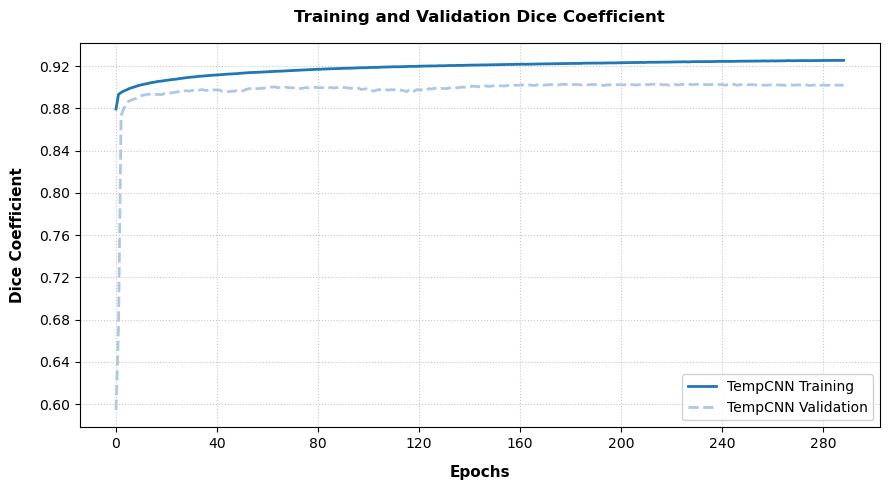

In [36]:
n_bands = 12
# Apply the reshape function
patche_cena_test_reshaped = reshape_data(patche_cena_test, n_bands)

# TempCNN
y_pred_tempcnn = model_tempcnn.predict(patche_cena_test_reshaped)
y_pred_argmax_tempcnn = np.argmax(y_pred_tempcnn, axis=-1)  # Predictions in terms of class

# Dictionary with model predictions
all_results = {
    'TempCNN': y_pred_argmax_tempcnn,  # model_tempcnn.predict(patche_cena_test_reshaped),
}

# Dictionary with training histories (optional)
histories = {
    # 'TempCNN': history_tempcnn.history,
    'TempCNN': history_tempcnn, # json salvo Epoch 289
}

# Evaluate and plot results
evaluate_and_plot(patche_classe_test, all_results, histories, title="Model TempCNN")

In [ ]:
# --- carregar modelo e historico tempcnn 

In [ ]:
#### ConvLSTM  #############################

In [32]:
### Treinamento ConvLSTM
# Reshape patche_cena_combined
patche_cena_combined_reshape = patche_cena_combined.reshape(patche_cena_combined.shape[0],patche_cena_combined.shape[1],patche_cena_combined.shape[2],patche_cena_combined.shape[3])

# One-hot encoding das labels
nbclasses = 2  # Ajuste o número de classes conforme necessário

y_train_onehot = one_hot_encode_labels(patche_classe_combined, nbclasses)

n_bands = 12
# Aplicar a função
X_train_reshaped = reshape_data(patche_cena_combined_reshape, n_bands)

print('Forma de y_train após onehot:', y_train_onehot.shape)
print('Forma de X_train após reshape:', X_train_reshaped.shape)

Forma de y_train após onehot: (6143, 64, 64, 2)
Forma de X_train após reshape: (6143, 1, 64, 64, 12)


In [37]:
import numpy as np
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import ConvLSTM2D, BatchNormalization, Conv2D, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.regularizers import l2
import json


callbacks = [ModelCheckpoint(path_modelo + '/modelo_convlstm_{epoch:02d}.keras', verbose=1, save_best_only=True),
             EarlyStopping(monitor='val_loss', patience=10)]
# Função para one-hot encoding
def one_hot_encode_labels(labels, num_classes):
    return to_categorical(labels, num_classes)

# Dimensões
nbclasses = 2  # Número de classes
n_bands = 12
l_patche = 64
input_shape = (1, l_patche, l_patche, n_bands)  # Ajuste conforme necessário

# One-hot encoding das labels - patche_classe_combined
y_train_onehot = one_hot_encode_labels(patche_classe_combined, nbclasses)
print('Forma de y_train após onehot:', y_train_onehot.shape)

# Aplicar a função - patche_cena_combined_reshape
X_train_reshaped = reshape_data(patche_cena_combined_reshape, n_bands)
print('Forma de X_train após reshape:', X_train_reshaped.shape)

Forma de y_train após onehot: (6143, 64, 64, 2)
Forma de X_train após reshape: (6143, 1, 64, 64, 12)


In [38]:
# Definir o modelo ConvLSTM
def build_conv_lstm_classification_model(input_shape):
    model = Sequential()
    
    # Primeira camada ConvLSTM
    # model.add(ConvLSTM2D(filters=64, kernel_size=(3, 3), input_shape=input_shape, padding='same', return_sequences=True))
    # model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=64, kernel_size=(3, 3), input_shape=input_shape, 
                     padding='same', return_sequences=True, 
                     kernel_regularizer=l2(1e-4)))
    model.add(Dropout(0.2))  # Reduz overfitting

    
    # Segunda camada ConvLSTM
    # model.add(ConvLSTM2D(filters=64, kernel_size=(3, 3), padding='same', return_sequences=False))
    # model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=64, kernel_size=(3, 3), input_shape=input_shape, 
                     padding='same', return_sequences=False, 
                     kernel_regularizer=l2(1e-4)))
    model.add(Dropout(0.2))  # Reduz overfitting
    
    # Camada Conv2D para reduzir para 2 canais (multiclasse por pixel)
    model.add(Conv2D(filters=2, kernel_size=(1, 1), activation='softmax', padding='same'))    
    
    # model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy', iou_metric]) #combined_loss
    model.compile(optimizer=Adam(learning_rate=1e-3), loss='categorical_crossentropy', metrics=['accuracy', iou, dice_coef])
    return model

# Criar o modelo
model_conv_lstm = build_conv_lstm_classification_model(input_shape)
model_conv_lstm.summary()

# Treinamento
X_train = X_train_reshaped 
y_train = y_train_onehot  

print("X_train shape:", X_train.shape)  
print("y_train shape:", y_train.shape)  

# Treinar o modelo
history_convlstm = model_conv_lstm.fit(X_train, y_train,
                    validation_split=0.2,
                    epochs=n_epochs,  
                    batch_size=32,  
                    callbacks=callbacks,
                    verbose=1)

# Salva o histórico em um arquivo JSON
with open('historico_treinamento_convlstm.json', 'w') as f:
    json.dump(history_convlstm.history, f)  # history.history é um dicionário


/home/cesar/anaconda3/envs/rsgislib/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv_lstm2d (ConvLSTM2D)        │ (None, 1, 64, 64, 64)  │       175,360 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1, 64, 64, 64)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_lstm2d_1 (ConvLSTM2D)      │ (None, 64, 64, 64)     │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 2)      │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 470,658 (1.80 MB)

 Trainable params: 470,658 (1.80 MB)

 Non-trainable params: 0 (0.00 B)

X_train shape: (6143, 1, 64, 64, 12)
y_train shape: (6143, 64, 64, 2)
Epoch 1/300
153/154 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.7521 - dice_coef: 0.6518 - iou: 0.5375 - loss: 0.4954

2025-06-03 12:25:41.598796: W external/local_tsl/tsl/framework/bfc_allocator.cc:291] Allocator (GPU_0_bfc) ran out of memory trying to allocate 554.00MiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.


154/154 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - accuracy: 0.7527 - dice_coef: 0.6527 - iou: 0.5386 - loss: 0.4947
Epoch 1: val_loss improved from inf to 0.28010, saving model to modelos/modelo_convlstm_01.keras
154/154 ━━━━━━━━━━━━━━━━━━━━ 29s 139ms/step - accuracy: 0.7533 - dice_coef: 0.6537 - iou: 0.5396 - loss: 0.4939 - val_accuracy: 0.9028 - val_dice_coef: 0.8824 - val_iou: 0.7924 - val_loss: 0.2801
Epoch 2/300
154/154 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.9049 - dice_coef: 0.8882 - iou: 0.7999 - loss: 0.2777
Epoch 2: val_loss improved from 0.28010 to 0.27153, saving model to modelos/modelo_convlstm_02.keras
154/154 ━━━━━━━━━━━━━━━━━━━━ 14s 93ms/step - accuracy: 0.9049 - dice_coef: 0.8882 - iou: 0.8000 - loss: 0.2777 - val_accuracy: 0.9031 - val_dice_coef: 0.8831 - val_iou: 0.7933 - val_loss: 0.2715
Epoch 3/300
154/154 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - accuracy: 0.9064 - dice_coef: 0.8900 - iou: 0.8027 - loss: 0.2696
Epoch 3: val_loss improved from 0.27153 to 0.26643, savi

In [28]:
from tensorflow.keras.utils import CustomObjectScope
from tensorflow.keras.models import load_model
import json


# Carrega o histórico convlstm
with open('historico_treinamento_convlstm.json', 'r') as f:
    history_convlstm = json.load(f)

model_conv_lstm = load_model('/home/cesar/geoinformatica/ConvLSTM_TempCNN/ultimos_notebooks/modelos/modelo_convlstm_199.keras')

print(history_convlstm.keys())

dict_keys(['accuracy', 'dice_coef', 'iou', 'loss', 'val_accuracy', 'val_dice_coef', 'val_iou', 'val_loss'])


19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 28ms/step


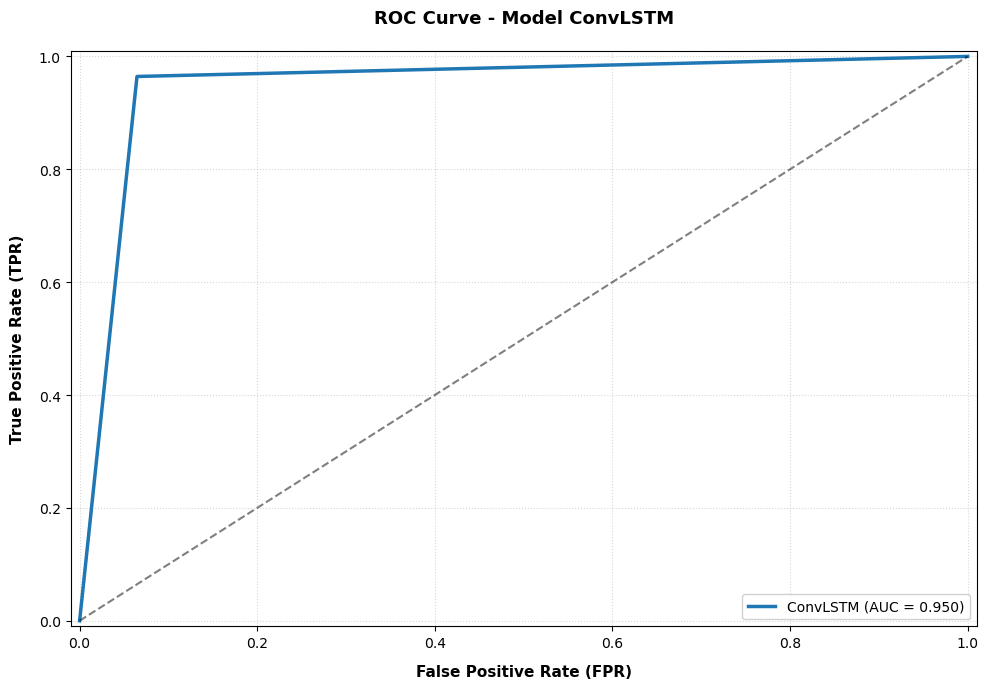

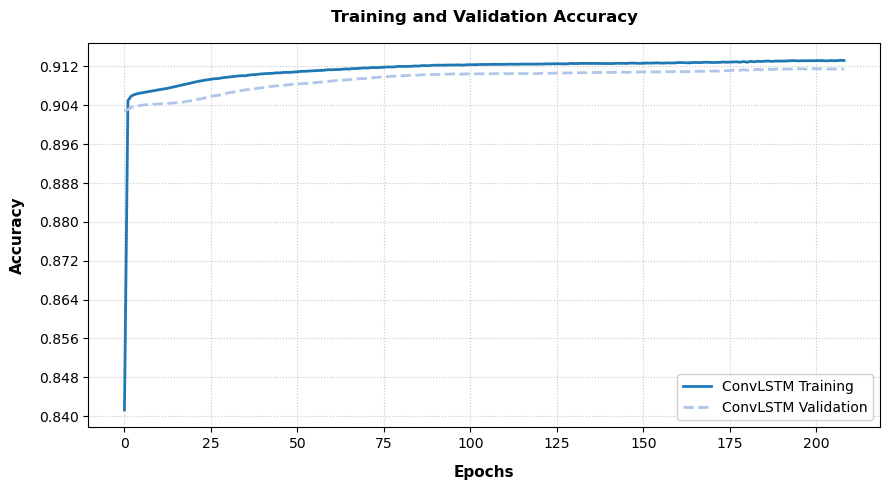

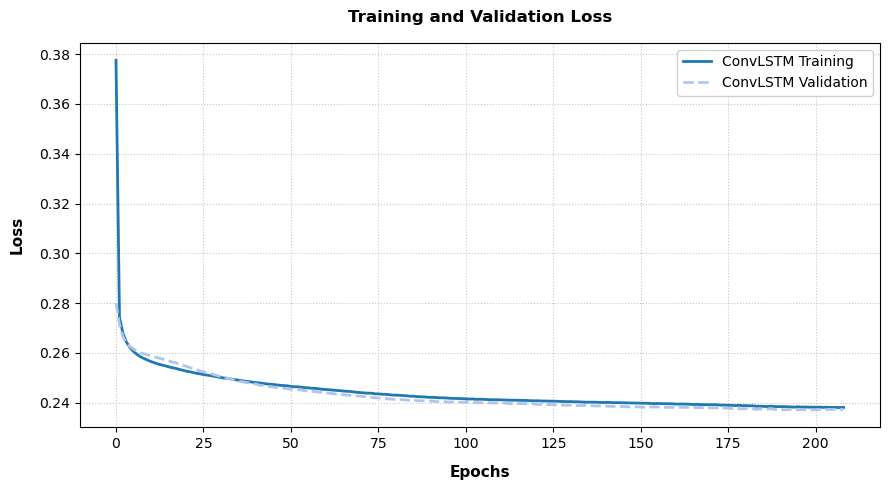

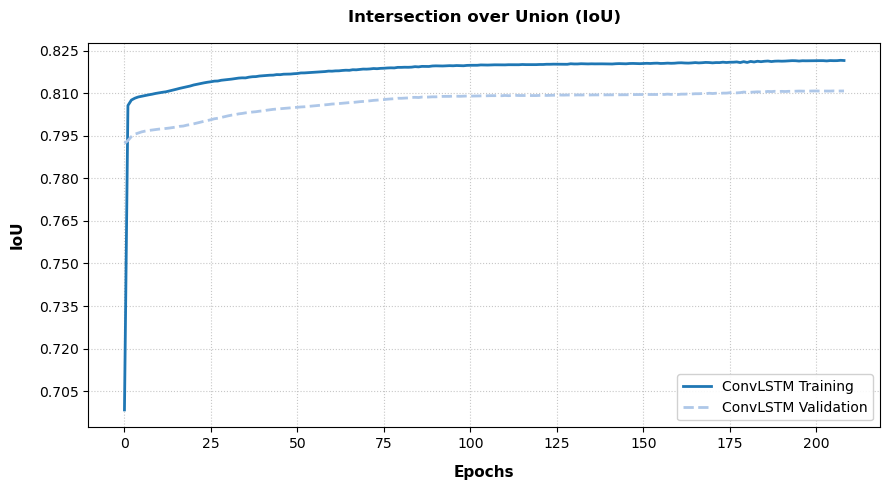

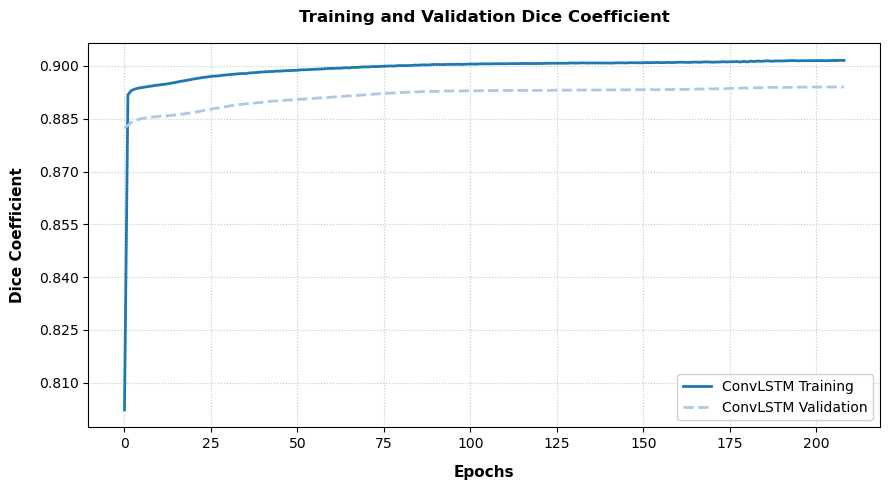

In [33]:
n_bands = 12
# Apply the reshape function
patche_cena_test_reshaped = reshape_data(patche_cena_test, n_bands)

# ConvLSTM
y_pred_convlstm = model_conv_lstm.predict(patche_cena_test_reshaped)
y_pred_argmax_convlstm = np.argmax(y_pred_convlstm, axis=-1)  # Predictions in terms of class

# Dictionary with model predictions
all_results = {
    'ConvLSTM': y_pred_argmax_convlstm,  # model_conv_lstm_classification.predict(patche_cena_test_reshaped),
}

# Dictionary with training histories (optional)
histories = {
    'ConvLSTM': history_convlstm,
    # 'ConvLSTM': history_convlstm.history,  #Epoch 209
}

# Evaluate and plot results
evaluate_and_plot(patche_classe_test, all_results, histories, title="Model ConvLSTM")

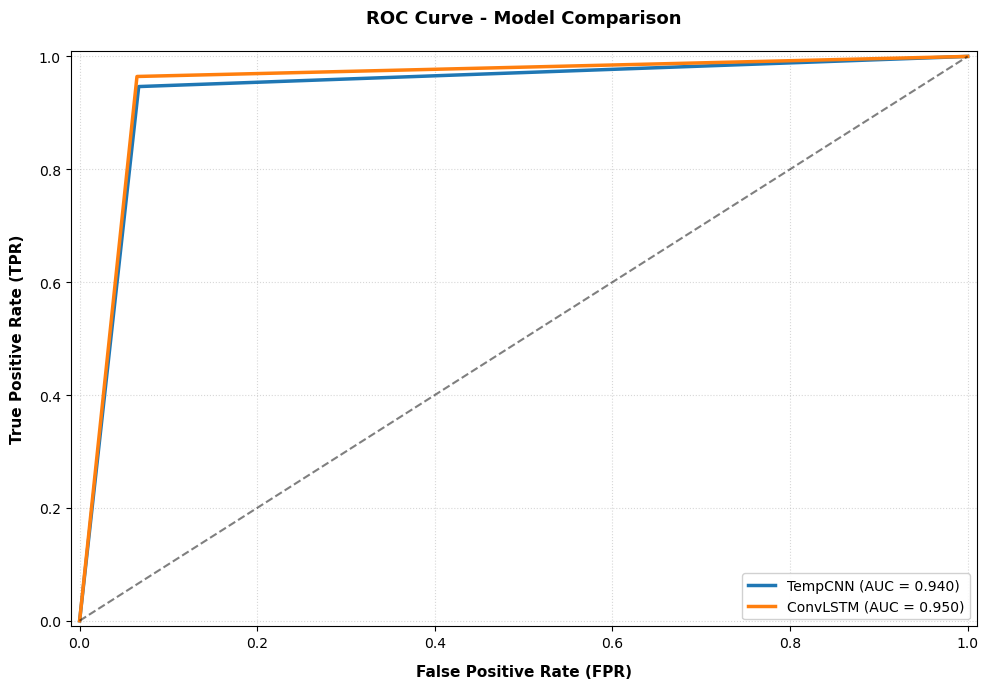

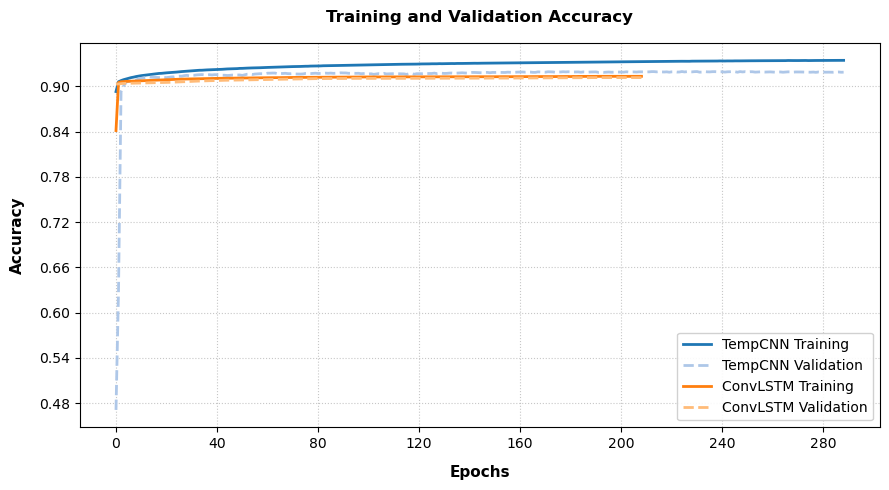

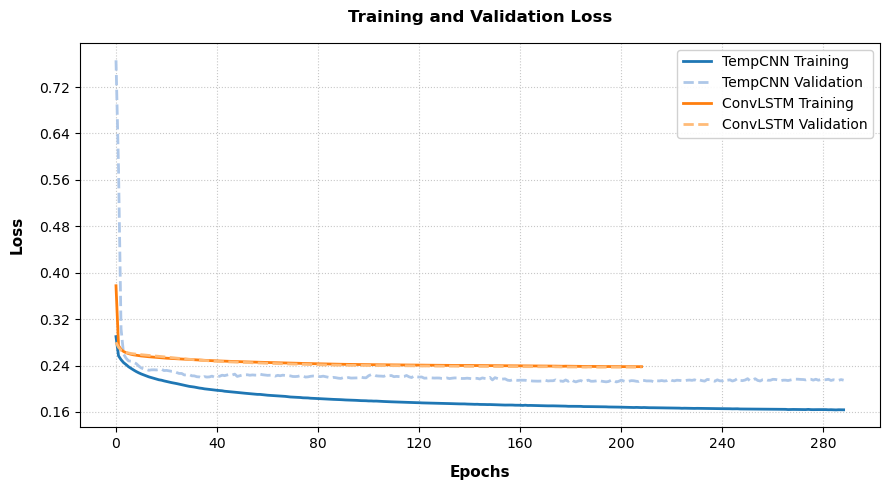

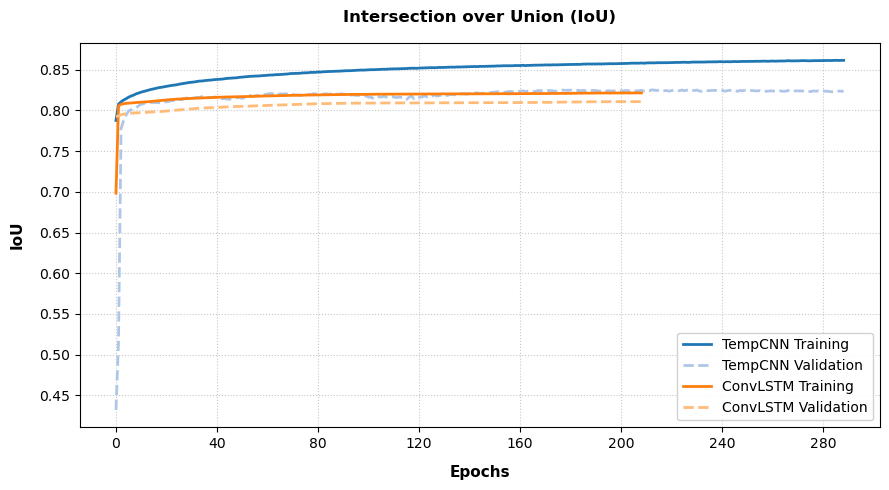

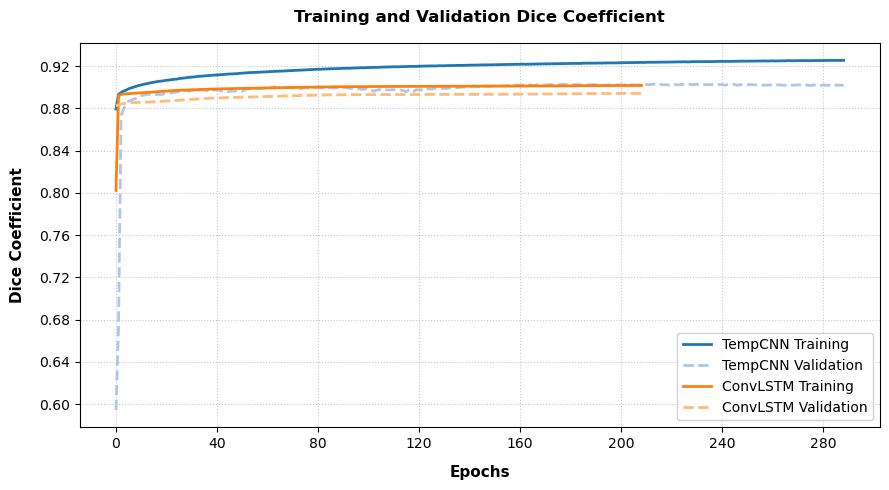

In [40]:
# Dictionary with model predictions
all_results = {
    'TempCNN': y_pred_argmax_tempcnn,  # model_tempcnn.predict(patche_cena_test_reshaped),
    'ConvLSTM': y_pred_argmax_convlstm,  # model_conv_lstm_classification.predict(patche_cena_test_reshaped),
}

# Dictionary with training histories (optional)
histories = {
    'TempCNN': history_tempcnn,
    'ConvLSTM': history_convlstm,
}

# Evaluate and plot results
evaluate_and_plot(patche_classe_test, all_results, histories, title="Model Comparison")

## F1-Score e Acurácia

In [41]:
# Teste separando patchs e labels do dataset
# F1-Score:
f1 = f1_score(list(patche_classe_test.flatten()), list(y_pred_argmax_tempcnn.flatten()), average='weighted')
print("F1-Score: ", f1)

# Accuracy:
acc = accuracy_score(list(patche_classe_test.flatten()), list(y_pred_argmax_tempcnn.flatten()))
print("Accuracy: ", acc)


F1-Score:  0.9402711219202594
Accuracy:  0.9402820769408978


In [42]:

# Teste separando patchs e labels do dataset
# F1-Score:
f1 = f1_score(list(patche_classe_test.flatten()), list(y_pred_argmax_convlstm.flatten()), average='weighted')
print("F1-Score: ", f1)

# Accuracy:
acc = accuracy_score(list(patche_classe_test.flatten()), list(y_pred_argmax_convlstm.flatten()))
print("Accuracy: ", acc)


F1-Score:  0.9504738177970785
Accuracy:  0.9505062197539127


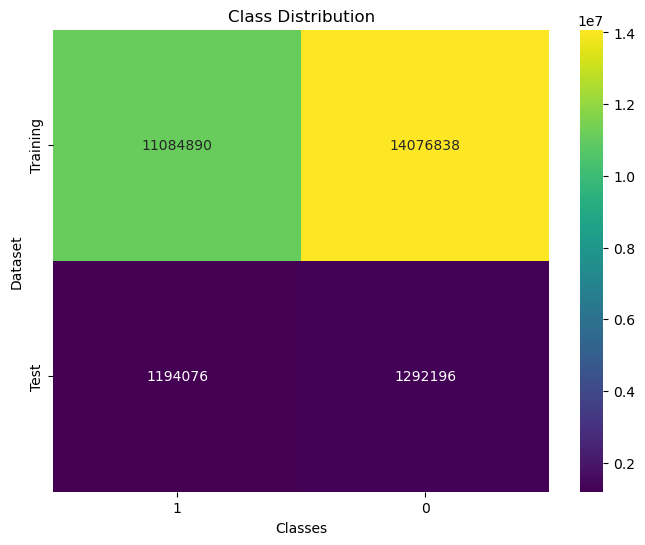

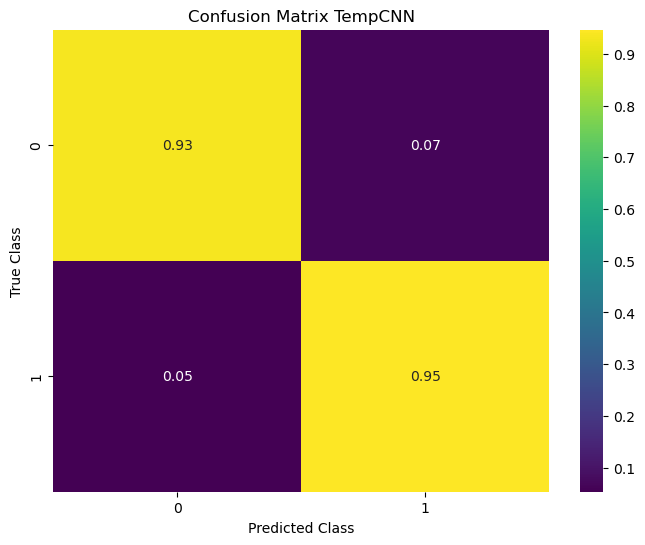

In [43]:
#### Gráficos
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

# Certifique-se de que os arrays sejam 1D usando .flatten()
train_counts = Counter(patche_classe_combined.flatten().tolist())
test_counts = Counter(patche_classe_test.flatten().tolist())

# Criar um heatmap para a distribuição
plt.figure(figsize=(8, 6))
sns.heatmap([list(train_counts.values()), list(test_counts.values())],
            annot=True, fmt='d', cmap='viridis', xticklabels=train_counts.keys(),
            yticklabels=['Training', 'Test'])
plt.title('Class Distribution')
plt.xlabel('Classes')
plt.ylabel('Dataset')
plt.show()
#Classes desbalanceado: normalizar os valores da matriz de confusão para visualizar proporções em vez de contagens absolutas
# Normalizar a matriz de confusão
cm_normalized = confusion_matrix(patche_classe_test.flatten(), y_pred_argmax_tempcnn.flatten(), normalize='true')

# Criar o heatmap com valores normalizados
plt.figure(figsize=(8, 6))
sns.heatmap(cm_normalized, annot=True, fmt=".2f", cmap='viridis', xticklabels=np.unique(patche_classe_test), yticklabels=np.unique(patche_classe_test))

# Configure the plot
plt.title('Confusion Matrix TempCNN') #(Normalized)
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.show()


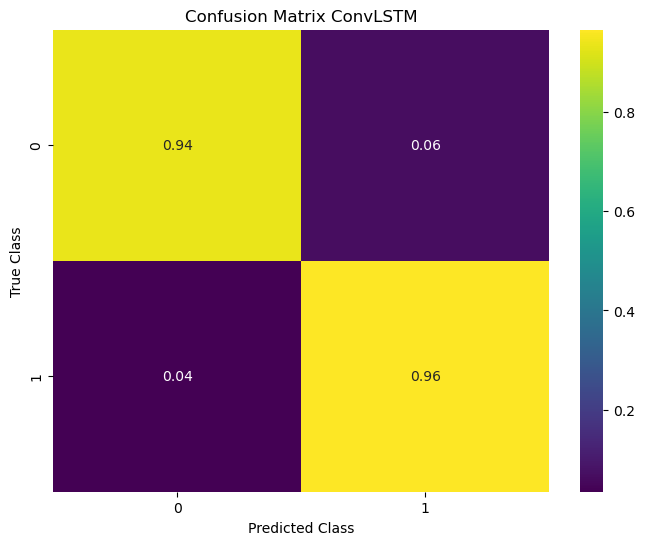

In [35]:
#Classes desbalanceado: normalizar os valores da matriz de confusão para visualizar proporções em vez de contagens absolutas
# Normalizar a matriz de confusão
import seaborn as sns

cm_normalized = confusion_matrix(patche_classe_test.flatten(), y_pred_argmax_convlstm.flatten(), normalize='true')

# Criar o heatmap com valores normalizados
plt.figure(figsize=(8, 6))
sns.heatmap(cm_normalized, annot=True, fmt=".2f", cmap='viridis', xticklabels=np.unique(patche_classe_test), yticklabels=np.unique(patche_classe_test))

# Configure the plot
plt.title('Confusion Matrix ConvLSTM') #(Normalized)
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.show()


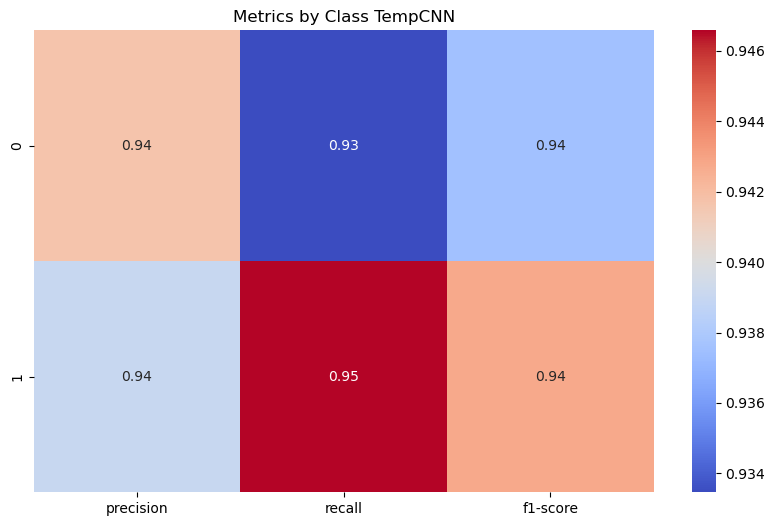

In [45]:
from sklearn.metrics import classification_report # não é muito interessante
import pandas as pd

# Relatório de classificação
report = classification_report(patche_classe_test.flatten(), y_pred_argmax_tempcnn.flatten(), output_dict=True)

# Converter o relatório para DataFrame
df_report = pd.DataFrame(report).transpose()

# Filtrar apenas classes (ignorar 'accuracy', etc.)
df_classes = df_report.iloc[:-3, :]

# Criar o heatmap das métricas
plt.figure(figsize=(10, 6))
sns.heatmap(df_classes[['precision', 'recall', 'f1-score']], annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Metrics by Class TempCNN')
plt.show()



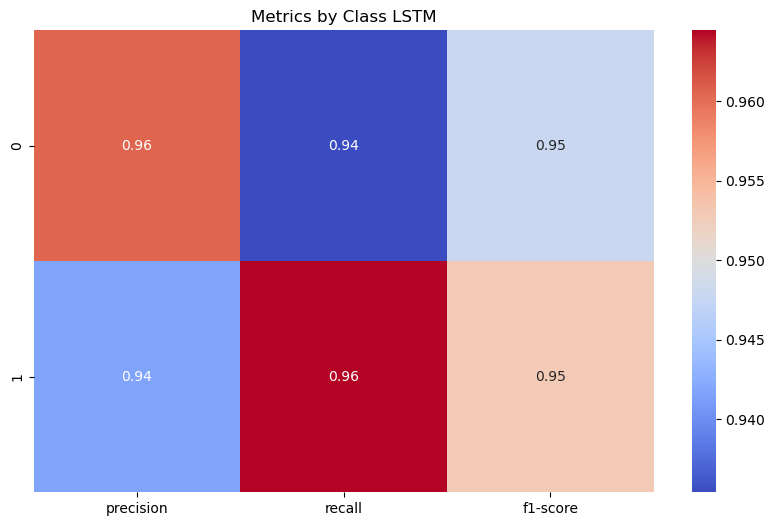

In [46]:

# Relatório de classificação
report = classification_report(patche_classe_test.flatten(), y_pred_argmax_convlstm.flatten(), output_dict=True)

# Converter o relatório para DataFrame
df_report = pd.DataFrame(report).transpose()

# Filtrar apenas classes (ignorar 'accuracy', etc.)
df_classes = df_report.iloc[:-3, :]

# Criar o heatmap das métricas
plt.figure(figsize=(10, 6))
sns.heatmap(df_classes[['precision', 'recall', 'f1-score']], annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Metrics by Class LSTM')
plt.show()

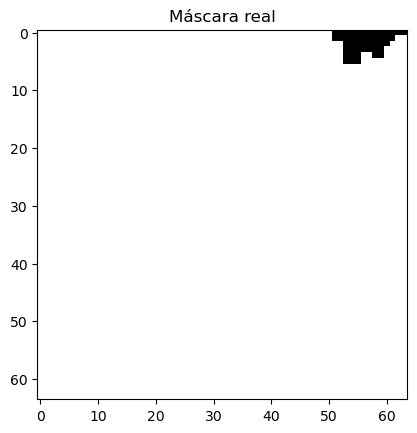

In [47]:
# Métrica IoU [2]
id_img_teste = 440   #600,1000, 1100, 1200
img_teste = patche_cena_test[id_img_teste]
ground_truth = patche_classe_test[id_img_teste]
plt.imshow(np.squeeze(ground_truth), cmap='gray')
plt.title('Máscara real');

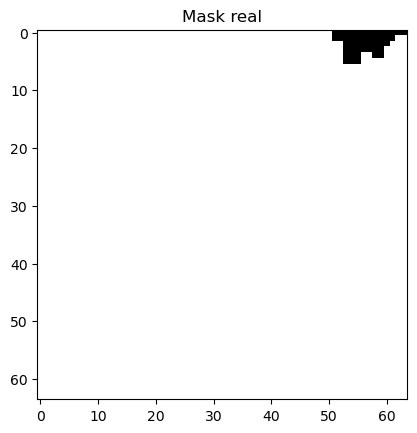

Forma da imagem de teste expandida: (1, 1, 64, 64, 12)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step
(1, 1, 64, 64)
(64, 64)


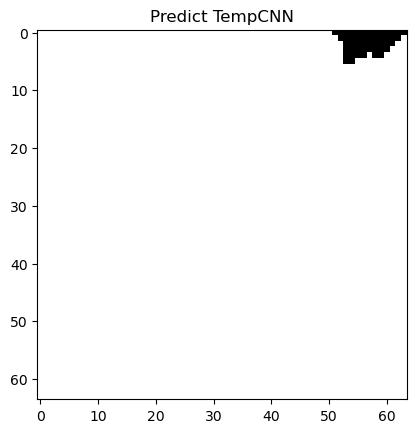

IoU: 0.9404358863830566


In [48]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.metrics import MeanIoU

# Configurações para remover as linhas brancas do grid
plt.rcParams['axes.grid'] = False

# Selecionar a imagem de teste
id_img_teste = 440   #600,1000, 1100, 1200
img_teste = patche_cena_test[id_img_teste]  # Forma: (64, 64, 12)
ground_truth = patche_classe_test[id_img_teste]  # Forma: (64, 64)

# Visualizar a máscara real
plt.imshow(np.squeeze(ground_truth), cmap='gray')
plt.title('Mask real')
plt.show()

# Expandir as dimensões da imagem de teste para o formato esperado pelo modelo
img_teste_expanded = np.expand_dims(img_teste, axis=0)  # Forma: (1, 64, 64, 12)
img_teste_expanded = np.expand_dims(img_teste_expanded, axis=0)  # Forma: (1, 1, 64, 64, 12)

# Verificar a forma da imagem expandida
print("Forma da imagem de teste expandida:", img_teste_expanded.shape)

# Realizar a predição
try:
    predictions = model_tempcnn.predict(img_teste_expanded)  # Forma: (1, 64, 64, num_classes)
except Exception as e:
    print("Erro ao realizar a predição:", e)
    raise

# Converter as predições para rótulos de classe
# Converter as predições para rótulos de classe
predictions = np.argmax(predictions, axis=-1)  # Forma: (1, 64, 64)
print(predictions.shape)
predictions = np.squeeze(predictions, axis=0)  # Forma: (64, 64)
predictions = np.squeeze(predictions, axis=0)  # Forma: (64, 64)
print(predictions.shape)

# Visualizar a predição
plt.imshow(predictions, cmap='gray')
plt.title('Predict TempCNN')
plt.show()


# Inicializar e calcular o IoU
iou_metric = MeanIoU(num_classes=2)
ground_truth = np.expand_dims(ground_truth, axis=-1)  # Forma: (64, 64, 1)
iou_metric.update_state(ground_truth, predictions)
iou_resultado = iou_metric.result().numpy()
print(f'IoU: {iou_resultado}')

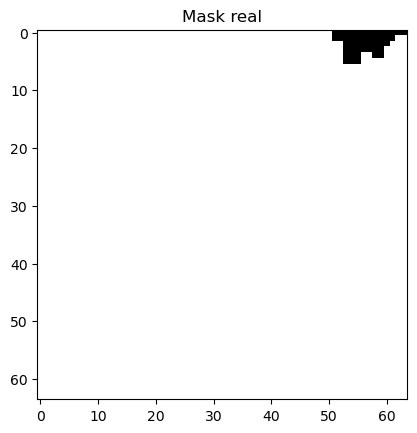

Forma da imagem de teste expandida: (1, 1, 64, 64, 12)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step
(1, 64, 64)
(64, 64)


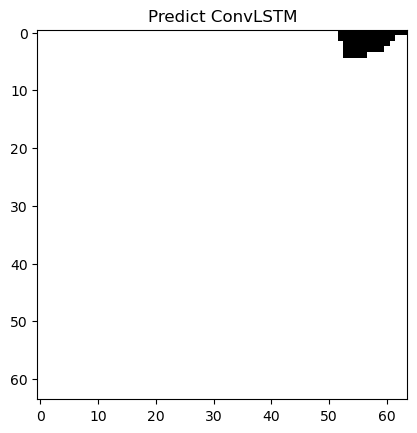

IoU: 0.915680468082428


In [49]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.metrics import MeanIoU

# Configurações para remover as linhas brancas do grid
# plt.rcParams['image.interpolation'] = 'nearest'
# plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['axes.grid'] = False

# Selecionar a imagem de teste
id_img_teste = 440   #600,1000, 1100, 1200
img_teste = patche_cena_test[id_img_teste]  # Forma: (64, 64, 12)
ground_truth = patche_classe_test[id_img_teste]  # Forma: (64, 64)

# Visualizar a máscara real
plt.imshow(np.squeeze(ground_truth), cmap='gray')
plt.title('Mask real')
plt.show()

# Expandir as dimensões da imagem de teste para o formato esperado pelo modelo
img_teste_expanded = np.expand_dims(img_teste, axis=0)  # Forma: (1, 64, 64, 12)
img_teste_expanded = np.expand_dims(img_teste_expanded, axis=0)  # Forma: (1, 1, 64, 64, 12)

# Verificar a forma da imagem expandida
print("Forma da imagem de teste expandida:", img_teste_expanded.shape)

# Realizar a predição
try:
    predictions = model_conv_lstm.predict(img_teste_expanded)  # Forma: (1, 64, 64, num_classes)
except Exception as e:
    print("Erro ao realizar a predição:", e)
    raise

# Converter as predições para rótulos de classe
predictions = np.argmax(predictions, axis=-1)  # Forma: (1, 64, 64)
print(predictions.shape)
predictions = np.squeeze(predictions, axis=0)  # Forma: (64, 64)
# predictions = np.squeeze(predictions, axis=0)  # Forma: (64, 64)
print(predictions.shape)

# Visualizar a predição
plt.imshow(predictions, cmap='gray')
plt.title('Predict ConvLSTM')
plt.show()


# Inicializar e calcular o IoU
iou_metric = MeanIoU(num_classes=2)
ground_truth = np.expand_dims(ground_truth, axis=-1)  # Forma: (64, 64, 1)
iou_metric.update_state(ground_truth, predictions)
iou_resultado = iou_metric.result().numpy()
print(f'IoU: {iou_resultado}')

Shape de patche_cena_test: (607, 64, 64, 12)
Shape de patche_classe_test: (607, 64, 64, 1)
Shape de test_img: (64, 64, 12)
Shape de ground_truth: (64, 64)
Model expected input shape: (None, 1, 64, 64, 12)
Shape de test_img_expanded: (1, 1, 64, 64, 12)
Shape de predictions: (64, 64)
Shape de difference: (64, 64)


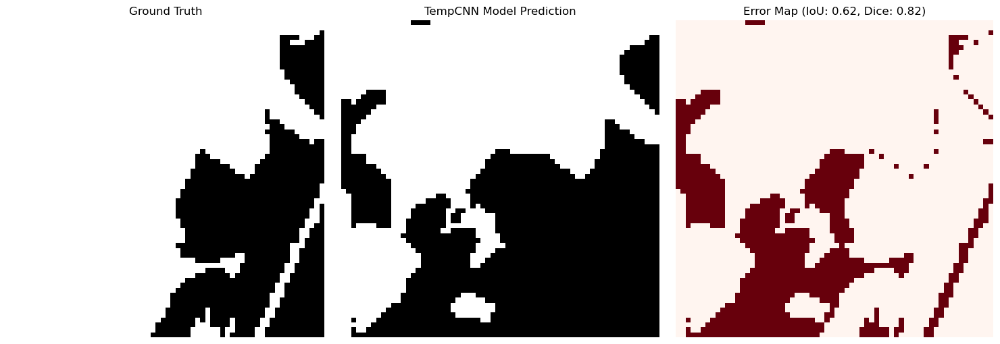


Metrics for image 477:
- IoU: 0.6197
- Dice Coefficient: 0.8226


In [50]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.metrics import MeanIoU

# Function to manually calculate Dice Coefficient
def dice_coefficient(y_true, y_pred):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1e-6) / (np.sum(y_true_f) + np.sum(y_pred_f) + 1e-6)

# Select test image
test_img_id = 477   #400, 423
test_img = patche_cena_test[test_img_id]
ground_truth = patche_classe_test[test_img_id]

# Verify input data
print(f"Shape de patche_cena_test: {patche_cena_test.shape}")
print(f"Shape de patche_classe_test: {patche_classe_test.shape}")
print(f"Shape de test_img: {test_img.shape}")
if np.any(np.isnan(test_img)) or np.any(np.isinf(test_img)):
    raise ValueError("test_img contains NaN or inf values")

# Convert ground truth if one-hot or remove extra dimensions
if len(ground_truth.shape) == 3 and ground_truth.shape[-1] == 2:  # One-hot (64, 64, 2)
    ground_truth = np.argmax(ground_truth, axis=-1)  # Shape: (64, 64)
else:
    ground_truth = np.squeeze(ground_truth)  # Remove extra dimensions (e.g., (64, 64, 1) -> (64, 64))

print(f"Shape de ground_truth: {ground_truth.shape}")

# Check model's expected input shape
model_input_shape = model_tempcnn.input_shape
print(f"Model expected input shape: {model_input_shape}")

# Prepare image for prediction
# Add batch and time dimensions to match (None, 1, 64, 64, 12)
test_img_expanded = np.expand_dims(test_img, axis=0)  # Shape: (1, 64, 64, 12)
test_img_expanded = np.expand_dims(test_img_expanded, axis=1)  # Shape: (1, 1, 64, 64, 12)
print(f"Shape de test_img_expanded: {test_img_expanded.shape}")

# Verify channel count
expected_channels = model_input_shape[-1]  # Should be 12
if test_img.shape[-1] != expected_channels:
    raise ValueError(f"test_img has {test_img.shape[-1]} channels, model expects {expected_channels}")

# Make prediction
predictions = model_tempcnn.predict(test_img_expanded, verbose=0)  # Shape: (1, 64, 64, 2) or similar
predictions = np.argmax(predictions, axis=-1)  # Shape: (1, 64, 64) or adjusted
predictions = np.squeeze(predictions)  # Shape: (64, 64)
print(f"Shape de predictions: {predictions.shape}")

# Visualize ground truth mask
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(ground_truth, cmap='gray')
plt.title('Ground Truth')
plt.axis('off')

# Visualize prediction
plt.subplot(1, 3, 2)
plt.imshow(predictions, cmap='gray')
plt.title('TempCNN Model Prediction')
plt.axis('off')

# Calculate metrics
iou_metric = MeanIoU(num_classes=2)
iou_metric.update_state(ground_truth, predictions)
iou_score = iou_metric.result().numpy()
dice_score = dice_coefficient(ground_truth, predictions)

# Difference map (errors)
difference = np.where(ground_truth != predictions, 1, 0)  # Shape: (64, 64)
print(f"Shape de difference: {difference.shape}")

# Visualize difference map
plt.subplot(1, 3, 3)
plt.imshow(difference, cmap='Reds')
plt.title(f'Error Map (IoU: {iou_score:.2f}, Dice: {dice_score:.2f})')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f'\nMetrics for image {test_img_id}:')
print(f'- IoU: {iou_score:.4f}')
print(f'- Dice Coefficient: {dice_score:.4f}')

Shape de patche_cena_test: (607, 64, 64, 12)
Shape de patche_classe_test: (607, 64, 64, 1)
Shape de test_img: (64, 64, 12)
Shape de ground_truth: (64, 64)
Model expected input shape: (None, 1, 64, 64, 12)
Shape de test_img_expanded: (1, 1, 64, 64, 12)
Shape de predictions: (64, 64)
Shape de difference: (64, 64)


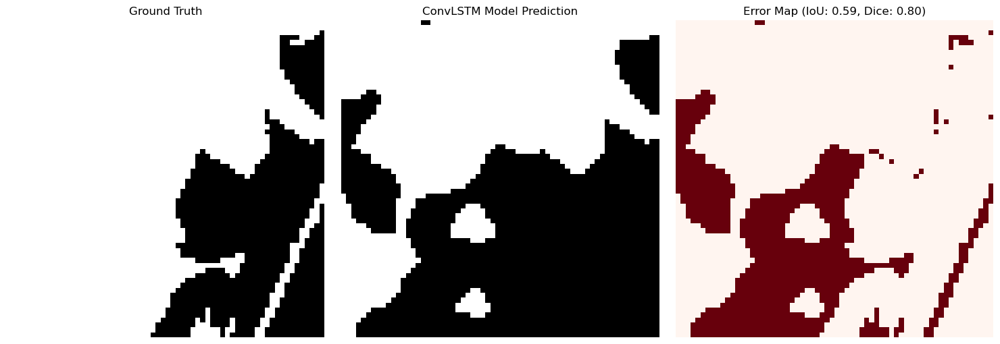


Metrics for image 477:
- IoU: 0.5939
- Dice Coefficient: 0.7999


In [51]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.metrics import MeanIoU

# Function to manually calculate Dice Coefficient
def dice_coefficient(y_true, y_pred):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1e-6) / (np.sum(y_true_f) + np.sum(y_pred_f) + 1e-6)

# Select test image
test_img_id = 477 #400, 423
test_img = patche_cena_test[test_img_id]
ground_truth = patche_classe_test[test_img_id]

# Verify input data
print(f"Shape de patche_cena_test: {patche_cena_test.shape}")
print(f"Shape de patche_classe_test: {patche_classe_test.shape}")
print(f"Shape de test_img: {test_img.shape}")
if np.any(np.isnan(test_img)) or np.any(np.isinf(test_img)):
    raise ValueError("test_img contains NaN or inf values")

# Convert ground truth if one-hot or remove extra dimensions
if len(ground_truth.shape) == 3 and ground_truth.shape[-1] == 2:  # One-hot (64, 64, 2)
    ground_truth = np.argmax(ground_truth, axis=-1)  # Shape: (64, 64)
else:
    ground_truth = np.squeeze(ground_truth)  # Remove extra dimensions (e.g., (64, 64, 1) -> (64, 64))

print(f"Shape de ground_truth: {ground_truth.shape}")

# Check model's expected input shape
model_input_shape = model_conv_lstm.input_shape
print(f"Model expected input shape: {model_input_shape}")

# Prepare image for prediction
# Add batch and time dimensions to match (None, 1, 64, 64, 12)
test_img_expanded = np.expand_dims(test_img, axis=0)  # Shape: (1, 64, 64, 12)
test_img_expanded = np.expand_dims(test_img_expanded, axis=1)  # Shape: (1, 1, 64, 64, 12)
print(f"Shape de test_img_expanded: {test_img_expanded.shape}")

# Verify channel count
expected_channels = model_input_shape[-1]  # Should be 12
if test_img.shape[-1] != expected_channels:
    raise ValueError(f"test_img has {test_img.shape[-1]} channels, model expects {expected_channels}")

# Make prediction
predictions = model_conv_lstm.predict(test_img_expanded, verbose=0)  # Shape: (1, 64, 64, 2) or similar
predictions = np.argmax(predictions, axis=-1)  # Shape: (1, 64, 64) or adjusted
predictions = np.squeeze(predictions)  # Shape: (64, 64)
print(f"Shape de predictions: {predictions.shape}")

# Visualize ground truth mask
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(ground_truth, cmap='gray')
plt.title('Ground Truth')
plt.axis('off')

# Visualize prediction
plt.subplot(1, 3, 2)
plt.imshow(predictions, cmap='gray')
plt.title('ConvLSTM Model Prediction')
plt.axis('off')

# Calculate metrics
iou_metric = MeanIoU(num_classes=2)
iou_metric.update_state(ground_truth, predictions)
iou_score = iou_metric.result().numpy()
dice_score = dice_coefficient(ground_truth, predictions)

# Difference map (errors)
difference = np.where(ground_truth != predictions, 1, 0)  # Shape: (64, 64)
print(f"Shape de difference: {difference.shape}")

# Visualize difference map
plt.subplot(1, 3, 3)
plt.imshow(difference, cmap='Reds')
plt.title(f'Error Map (IoU: {iou_score:.2f}, Dice: {dice_score:.2f})')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f'\nMetrics for image {test_img_id}:')
print(f'- IoU: {iou_score:.4f}')
print(f'- Dice Coefficient: {dice_score:.4f}')

In [52]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.metrics import MeanIoU

# def calcular_iou_global(ground_truth, predictions):
#     """
#     Calcula o IoU global para uma única imagem.
    
#     Args:
#         ground_truth (np.array): Máscara verdadeira.
#         predictions (np.array): Máscara predita.
        
#     Returns:
#         float: IoU global.
#     """
#     intersection = np.logical_and(ground_truth, predictions).sum()
#     union = np.logical_or(ground_truth, predictions).sum()
    
#     # Evita divisão por zero
#     if union == 0:
#         return 1.0 if intersection == 0 else 0.0
    
#     return intersection / union

def calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test):
    img_teste = patche_cena_test[id_img_teste]
    ground_truth = patche_classe_test[id_img_teste]

    # Cria uma instância do MeanIoU
    iou_resultado = MeanIoU(num_classes=2)

    # Expande as dimensões da imagem para a forma que o modelo espera
    img_test = np.expand_dims(img_teste, axis=0)  
    img_test = np.expand_dims(img_test, axis=0)  
    predictions = model.predict(img_test, verbose=0)

    # Obtém as predições de classe
    predictions = tf.argmax(predictions, axis=-1)
    predictions = predictions.numpy().reshape(64, 64)  # Converte para formato 2D

    # Reshape para ground_truth
    ground_truth = ground_truth.reshape(64, 64)

    # Atualiza o estado do MeanIoU com ground truth e predições
    iou_resultado.update_state(ground_truth, predictions)
    iou_mean = iou_resultado.result()

    # # Calcula o IoU global
    # iou_global = calcular_iou_global(ground_truth, predictions)

    # print(f'IoU Global para a imagem {id_img_teste}: {iou_global}')
    # print(f'IoU Mean para a imagem {id_img_teste}: {iou_mean}')
    
    return iou_mean.numpy() #,iou_global # Retorna IoU global e Mean IoU

def calcular_media_iou(model, patche_cena_test, patche_classe_test):
    # valores_iou_global = []
    valores_iou_mean = []
    
    for id_img_teste in range(len(patche_cena_test)):
        #iou_global,
        iou_mean = calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test)
        # valores_iou_global.append(iou_global)
        valores_iou_mean.append(iou_mean)

    # Calcula a média do IoU global e do Mean IoU
    # media_iou_global = np.mean(valores_iou_global)
    media_iou_mean = np.mean(valores_iou_mean)

    # print(f'Média do IoU Global para todas as imagens: {media_iou_global}')
    print(f'Média do Mean IoU para todas as imagens: {media_iou_mean}')
    return valores_iou_mean #,valores_iou_global,

#iou_global_tempcnn,
iou_mean_tempcnn=calcular_media_iou(model_tempcnn, patche_cena_test, patche_classe_test)


Média do Mean IoU para todas as imagens: 0.7476302981376648


In [53]:
#iou_global_convlstm, 
iou_mean_convlstm = calcular_media_iou(model_conv_lstm, patche_cena_test, patche_classe_test)


Média do Mean IoU para todas as imagens: 0.7863934636116028


#### mIoU de treinamento para colocar no heatmap

In [54]:
iou_mean_tempcnn_train = calcular_media_iou(model_tempcnn, patche_cena, patche_classe)

Média do Mean IoU para todas as imagens: 0.7480513453483582


In [55]:
iou_mean_convlstm_train = calcular_media_iou(model_conv_lstm, patche_cena, patche_classe)

Média do Mean IoU para todas as imagens: 0.7366211414337158


### mIoU calculo

In [56]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import confusion_matrix

def calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test, global_iou_metric=None):
    img_teste = patche_cena_test[id_img_teste]
    ground_truth = patche_classe_test[id_img_teste]

    # Verify shapes and values
    print(f"Imagem {id_img_teste} - Shape de img_teste: {img_teste.shape}")
    print(f"Imagem {id_img_teste} - Shape de ground_truth: {ground_truth.shape}")

    # Convert ground truth
    if len(ground_truth.shape) == 3 and ground_truth.shape[-1] == 2:  # One-hot (64, 64, 2)
        ground_truth = np.argmax(ground_truth, axis=-1)  # Shape: (64, 64)
    else:
        ground_truth = np.squeeze(ground_truth)  # Shape: (64, 64)

    # Check ground truth values
    unique_gt = np.unique(ground_truth)
    if not np.all(np.isin(unique_gt, [0, 1])):
        raise ValueError(f"Ground truth contains invalid values: {unique_gt}")

    print(f"Imagem {id_img_teste} - Valores únicos em ground_truth: {unique_gt}")

    # Prepare input for model
    img_test = np.expand_dims(img_teste, axis=0)  # Shape: (1, 64, 64, 12)
    img_test = np.expand_dims(img_test, axis=1)   # Shape: (1, 1, 64, 64, 12)
    
    # Make prediction
    predictions = model.predict(img_test, verbose=0)  # Shape: (1, 1, 64, 64, 2)
    predictions = tf.argmax(predictions, axis=-1)  # Shape: (1, 1, 64, 64)
    predictions = np.squeeze(predictions)  # Shape: (64, 64)
    
    print(f"Imagem {id_img_teste} - Valores únicos em predictions: {np.unique(predictions)}")

    # Calcular matriz de confusão
    cm = confusion_matrix(ground_truth.flatten(), predictions.flatten(), labels=[0, 1])
    print(f"Imagem {id_img_teste} - Matriz de confusão:\n{cm}")

    # Calcular IoU manualmente apenas para classes presentes no ground truth
    iou_values = []
    for cls in unique_gt:  # Apenas classes presentes no ground truth
        tp = cm[cls, cls]
        fp = cm[:, cls].sum() - tp
        fn = cm[cls, :].sum() - tp
        iou = tp / (tp + fp + fn + 1e-10)  # Evitar divisão por zero
        iou_values.append(iou)

    iou_mean = np.mean(iou_values) if iou_values else 0.0
    print(f'Imagem {id_img_teste} - Mean IoU: {iou_mean:.10f}')

    # Update global IoU if provided
    if global_iou_metric is not None:
        global_iou_metric.update_state(ground_truth, predictions)

    return iou_mean

def calcular_media_iou(model, patche_cena_test, patche_classe_test):
    valores_iou_mean = []
    
    # Initialize global IoU metric
    global_iou_metric = MeanIoU(num_classes=2)
    
    for id_img_teste in range(len(patche_cena_test)):
        iou_mean = calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test, global_iou_metric)
        valores_iou_mean.append(iou_mean)
    
    # Calculate mean of per-patch IoUs
    media_iou_mean = np.mean(valores_iou_mean)
    
    # Calculate global IoU
    global_iou = global_iou_metric.result().numpy()
    
    print(f'Média do Mean IoU para todas as imagens: {media_iou_mean:.10f}')
    print(f'Global Mean IoU para todas as imagens: {global_iou:.10f}')
    print(f"Primeiros 5 valores de iou_per_img_tempcnn: {valores_iou_mean[:5]}")
    
    return valores_iou_mean, global_iou

# Executar
iou_per_img_tempcnn, miou_tempcnn = calcular_media_iou(model_tempcnn, patche_cena_test, patche_classe_test)

Imagem 0 - Shape de img_teste: (64, 64, 12)
Imagem 0 - Shape de ground_truth: (64, 64, 1)
Imagem 0 - Valores únicos em ground_truth: [0]
Imagem 0 - Valores únicos em predictions: [0]
Imagem 0 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 0 - Mean IoU: 1.0000000000
Imagem 1 - Shape de img_teste: (64, 64, 12)
Imagem 1 - Shape de ground_truth: (64, 64, 1)
Imagem 1 - Valores únicos em ground_truth: [0]
Imagem 1 - Valores únicos em predictions: [0]
Imagem 1 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 1 - Mean IoU: 1.0000000000
Imagem 2 - Shape de img_teste: (64, 64, 12)
Imagem 2 - Shape de ground_truth: (64, 64, 1)
Imagem 2 - Valores únicos em ground_truth: [0]
Imagem 2 - Valores únicos em predictions: [0]
Imagem 2 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 2 - Mean IoU: 1.0000000000
Imagem 3 - Shape de img_teste: (64, 64, 12)
Imagem 3 - Shape de ground_truth: (64, 64, 1)
Imagem 3 - Valores únicos em ground_truth: [0]
Imagem 3 - Valores únicos em predictio

In [57]:
iou_per_img_convlstm, miou_convlstm = calcular_media_iou(model_conv_lstm, patche_cena_test, patche_classe_test)

Imagem 0 - Shape de img_teste: (64, 64, 12)
Imagem 0 - Shape de ground_truth: (64, 64, 1)
Imagem 0 - Valores únicos em ground_truth: [0]
Imagem 0 - Valores únicos em predictions: [0]
Imagem 0 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 0 - Mean IoU: 1.0000000000
Imagem 1 - Shape de img_teste: (64, 64, 12)
Imagem 1 - Shape de ground_truth: (64, 64, 1)
Imagem 1 - Valores únicos em ground_truth: [0]
Imagem 1 - Valores únicos em predictions: [0]
Imagem 1 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 1 - Mean IoU: 1.0000000000
Imagem 2 - Shape de img_teste: (64, 64, 12)
Imagem 2 - Shape de ground_truth: (64, 64, 1)
Imagem 2 - Valores únicos em ground_truth: [0]
Imagem 2 - Valores únicos em predictions: [0]
Imagem 2 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 2 - Mean IoU: 1.0000000000
Imagem 3 - Shape de img_teste: (64, 64, 12)
Imagem 3 - Shape de ground_truth: (64, 64, 1)
Imagem 3 - Valores únicos em ground_truth: [0]
Imagem 3 - Valores únicos em predictio

In [58]:
# print(iou_per_img_convlstm)

In [59]:
# miou treinos
iou_per_img_tempcnn_train, miou_tempcnn_train = calcular_media_iou(model_tempcnn, patche_cena_, patche_classe_)

Imagem 0 - Shape de img_teste: (64, 64, 12)
Imagem 0 - Shape de ground_truth: (64, 64, 1)
Imagem 0 - Valores únicos em ground_truth: [0]
Imagem 0 - Valores únicos em predictions: [0]
Imagem 0 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 0 - Mean IoU: 1.0000000000
Imagem 1 - Shape de img_teste: (64, 64, 12)
Imagem 1 - Shape de ground_truth: (64, 64, 1)
Imagem 1 - Valores únicos em ground_truth: [0]
Imagem 1 - Valores únicos em predictions: [0]
Imagem 1 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 1 - Mean IoU: 1.0000000000
Imagem 2 - Shape de img_teste: (64, 64, 12)
Imagem 2 - Shape de ground_truth: (64, 64, 1)
Imagem 2 - Valores únicos em ground_truth: [0]
Imagem 2 - Valores únicos em predictions: [0]
Imagem 2 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 2 - Mean IoU: 1.0000000000
Imagem 3 - Shape de img_teste: (64, 64, 12)
Imagem 3 - Shape de ground_truth: (64, 64, 1)
Imagem 3 - Valores únicos em ground_truth: [0]
Imagem 3 - Valores únicos em predictio

In [60]:
iou_per_img_convlstm_train, miou_convlstm_train = calcular_media_iou(model_conv_lstm, patche_cena_, patche_classe_)

Imagem 0 - Shape de img_teste: (64, 64, 12)
Imagem 0 - Shape de ground_truth: (64, 64, 1)
Imagem 0 - Valores únicos em ground_truth: [0]
Imagem 0 - Valores únicos em predictions: [0]
Imagem 0 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 0 - Mean IoU: 1.0000000000
Imagem 1 - Shape de img_teste: (64, 64, 12)
Imagem 1 - Shape de ground_truth: (64, 64, 1)
Imagem 1 - Valores únicos em ground_truth: [0]
Imagem 1 - Valores únicos em predictions: [0]
Imagem 1 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 1 - Mean IoU: 1.0000000000
Imagem 2 - Shape de img_teste: (64, 64, 12)
Imagem 2 - Shape de ground_truth: (64, 64, 1)
Imagem 2 - Valores únicos em ground_truth: [0]
Imagem 2 - Valores únicos em predictions: [0]
Imagem 2 - Matriz de confusão:
[[4096    0]
 [   0    0]]
Imagem 2 - Mean IoU: 1.0000000000
Imagem 3 - Shape de img_teste: (64, 64, 12)
Imagem 3 - Shape de ground_truth: (64, 64, 1)
Imagem 3 - Valores únicos em ground_truth: [0]
Imagem 3 - Valores únicos em predictio

In [61]:
def calcular_dice(id_img_teste, model, patche_cena_test, patche_classe_test):
    img_teste = patche_cena_test[id_img_teste]
    ground_truth = patche_classe_test[id_img_teste]
    
    # Prepara a imagem para predição
    img_test = np.expand_dims(np.expand_dims(img_teste, axis=0), axis=0)
    predictions = model.predict(img_test, verbose=0)
    
    # Converte predições para classes (0 ou 1)
    predictions = tf.argmax(predictions, axis=-1).numpy().reshape(64, 64)
    ground_truth = ground_truth.reshape(64, 64)
    
    # Calcula Dice
    intersection = np.sum(ground_truth * predictions)
    dice = (2. * intersection) / (np.sum(ground_truth) + np.sum(predictions) + 1e-6)
    
    return dice

def calcular_media_dice(model, patche_cena_test, patche_classe_test):
    valores_dice = []
    
    for id_img_teste in range(len(patche_cena_test)):
        dice = calcular_dice(id_img_teste, model, patche_cena_test, patche_classe_test)
        valores_dice.append(dice)
    
    media_dice = np.mean(valores_dice)
    print(f'Média do Dice Coefficient para todas as imagens: {media_dice:.4f}')
    return valores_dice

dice_mean_tempcnn = calcular_media_dice(model_tempcnn, patche_cena_test, patche_classe_test)

Média do Dice Coefficient para todas as imagens: 0.6365


In [62]:
dice_mean_convlstm = calcular_media_dice(model_conv_lstm, patche_cena_test, patche_classe_test)


Média do Dice Coefficient para todas as imagens: 0.6466


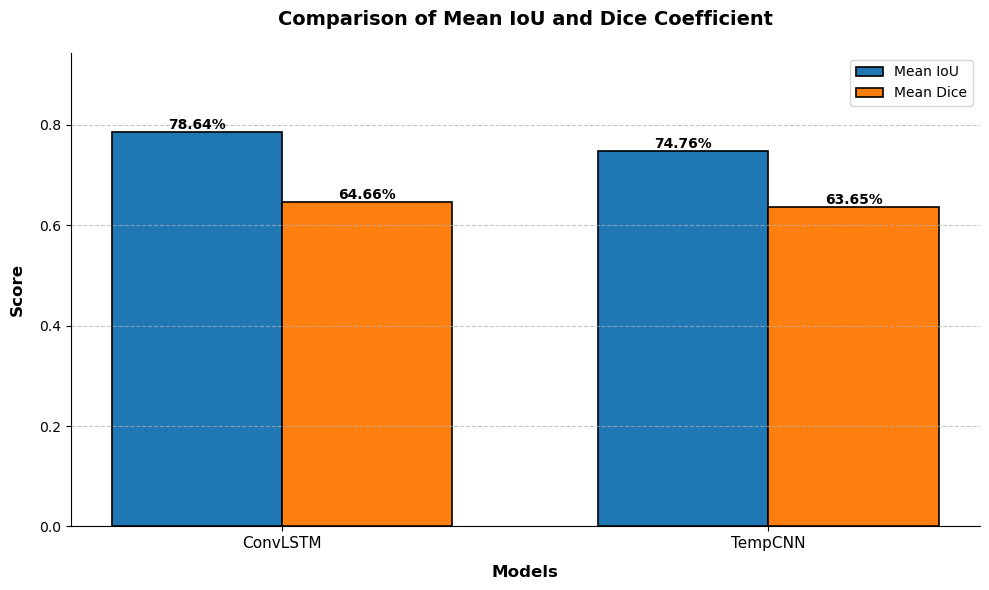

In [63]:
import matplotlib.pyplot as plt
import numpy as np

# Dados de exemplo
modelos = ['ConvLSTM', 'TempCNN']
media_ious = [np.mean(iou_mean_convlstm), np.mean(iou_mean_tempcnn)]
media_dices = [np.mean(dice_mean_convlstm), np.mean(dice_mean_tempcnn)]  # Substitua pelos seus dados

# Configurações do estilo
# plt.style.use('seaborn')
plt.figure(figsize=(10, 6))

# Cores personalizadas (azuis e laranjas)
cores_laranjas = ['#ff7f0e', '#ffbb78']  # Laranja principal e variante clara
cores_azuis = ['#1f77b4', '#aec7e8']  # Azul principal e variante clara

# Posições das barras
x = np.arange(len(modelos))
width = 0.35  # Largura das barras

# Barras para IoU (azuis)
bars_iou = plt.bar(x - width/2, media_ious, width, 
                   color=cores_azuis[0], edgecolor='black', linewidth=1.2, 
                   label='Mean IoU')

# Barras para Dice (laranjas)
bars_dice = plt.bar(x + width/2, media_dices, width, 
                    color=cores_laranjas[0], edgecolor='black', linewidth=1.2, 
                    label='Mean Dice')

# Adicionando valores nas barras
for bars in [bars_iou, bars_dice]:
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, height,
                 f'{height:.2%}',  # Formato porcentual
                 ha='center', va='bottom',
                 fontsize=10, fontweight='bold')

# Personalização do gráfico
plt.xlabel('Models', fontsize=12, fontweight='bold', labelpad=10)
plt.ylabel('Score', fontsize=12, fontweight='bold', labelpad=10)
plt.title('Comparison of Mean IoU and Dice Coefficient', fontsize=14, fontweight='bold', pad=20)
plt.xticks(x, modelos, fontsize=11)
plt.ylim(0, max(max(media_ious), max(media_dices)) * 1.2)  # Ajuste do eixo Y

# Grid e bordas
plt.grid(axis='y', linestyle='--', alpha=0.7)
for spine in ['top', 'right']:
    plt.gca().spines[spine].set_visible(False)

# Legenda
plt.legend(loc='upper right', frameon=True, fontsize=10)

plt.tight_layout()
plt.show()

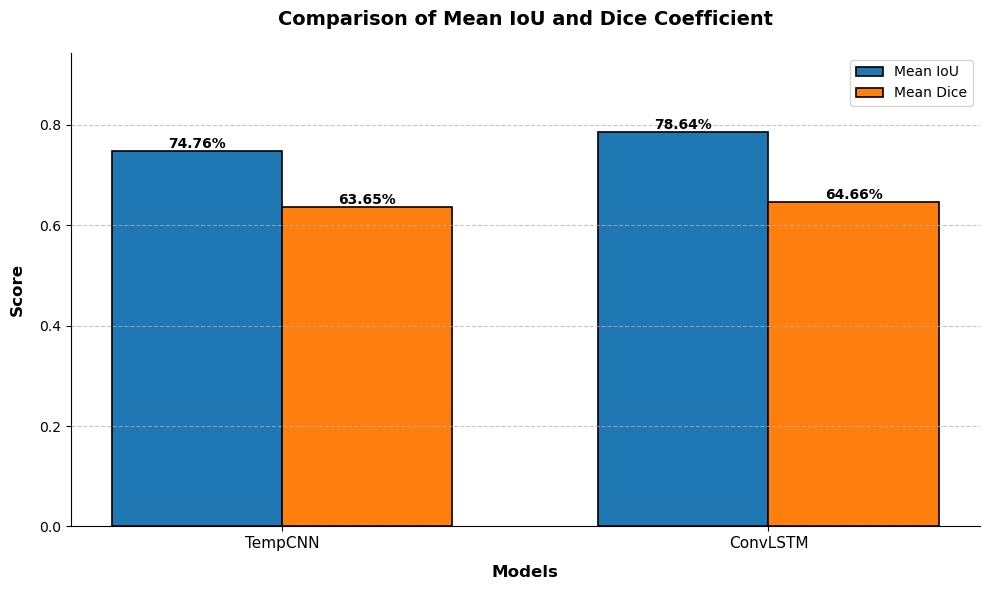

In [64]:
import matplotlib.pyplot as plt
import numpy as np

# Dados de exemplo
modelos = ['TempCNN', 'ConvLSTM']
media_ious = [np.mean(iou_mean_tempcnn), np.mean(iou_mean_convlstm)]
media_dices = [np.mean(dice_mean_tempcnn), np.mean(dice_mean_convlstm)]  # Substitua pelos seus dados

# Configurações do estilo
# plt.style.use('seaborn')
plt.figure(figsize=(10, 6))

# Cores personalizadas (azuis e laranjas)
cores_azuis = ['#1f77b4', '#aec7e8']  # Azul principal e variante clara
cores_laranjas = ['#ff7f0e', '#ffbb78']  # Laranja principal e variante clara

# Posições das barras
x = np.arange(len(modelos))
width = 0.35  # Largura das barras

# Barras para IoU (azuis)
bars_iou = plt.bar(x - width/2, media_ious, width, 
                   color=cores_azuis[0], edgecolor='black', linewidth=1.2, 
                   label='Mean IoU')

# Barras para Dice (laranjas)
bars_dice = plt.bar(x + width/2, media_dices, width, 
                    color=cores_laranjas[0], edgecolor='black', linewidth=1.2, 
                    label='Mean Dice')

# Adicionando valores nas barras
for bars in [bars_iou, bars_dice]:
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, height,
                 f'{height:.2%}',  # Formato porcentual
                 ha='center', va='bottom',
                 fontsize=10, fontweight='bold')

# Personalização do gráfico
plt.xlabel('Models', fontsize=12, fontweight='bold', labelpad=10)
plt.ylabel('Score', fontsize=12, fontweight='bold', labelpad=10)
plt.title('Comparison of Mean IoU and Dice Coefficient', fontsize=14, fontweight='bold', pad=20)
plt.xticks(x, modelos, fontsize=11)
plt.ylim(0, max(max(media_ious), max(media_dices)) * 1.2)  # Ajuste do eixo Y

# Grid e bordas
plt.grid(axis='y', linestyle='--', alpha=0.7)
for spine in ['top', 'right']:
    plt.gca().spines[spine].set_visible(False)

# Legenda
plt.legend(loc='upper right', frameon=True, fontsize=10)

plt.tight_layout()
plt.show()

In [65]:
### Gráficos ruins para mostrar

# indices = np.arange(len(patche_classe_test))

# plt.figure(figsize=(10, 5))
# plt.plot(indices, iou_per_img_tempcnn, marker='o', label='TempCNN', color='#1f77b4')  # Azul matplotlib
# # plt.plot(indices, iou_mean_convlstm, marker='s', label='ConvLSTM', color='#ff7f0e')  # Laranja matplotlib

# # Define o limite mínimo do eixo Y como 0
# plt.ylim(bottom=0)

# # Adiciona rótulos e título
# plt.xlabel('Test Image')
# plt.ylabel('IoU')
# plt.title('mIoU per Image TempCNN Model')
# plt.legend()
# plt.grid(True)
# plt.ion() # Enable interactive mode
# plt.show()

In [66]:
# plt.figure(figsize=(10, 5))
# plt.plot(indices, iou_per_img_convlstm, marker='s', label='ConvLSTM', color='#ff7f0e')  # Laranja matplotlib

# # Define o limite mínimo do eixo Y como 0
# plt.ylim(bottom=0)

# # Adiciona rótulos e título
# plt.xlabel('Test Image')
# plt.ylabel('IoU')
# plt.title('mIoU per Image ConvLSTM Model')
# plt.legend()
# plt.grid(True)
# plt.ion() # Enable interactive mode
# plt.show()

In [67]:

# # Criando um gráfico de linhas para visualizar os IoUs ao longo das imagens de teste
# plt.figure(figsize=(12, 6))

# # plt.plot(iou_temp_cnn, label="TempCNN", marker='o', linestyle='-', alpha=0.8)
# plt.plot(iou_global_tempcnn, label="TempCNN", marker='s', linestyle='--', alpha=0.8)
# plt.plot(iou_global_convlstm, label="ConvLSTM", marker='^', linestyle='-.', alpha=0.8)

# plt.xlabel("Test Image")
# plt.ylabel("Global IoU")
# plt.title("Global IoU Variation for Each Test Image")
# plt.legend()
# plt.grid(True)
# plt.ion()  # Ativa o modo interativo
# plt.savefig("iou_global_tempcnn_convlstm.png", dpi=300)
# plt.show()


In [68]:
# ######### Gráfico de grade valores mIoU ConvLSTM e TempCNN por imagem

In [69]:
### FAZER PARA CONVLSTM E TEMPCNN -> modelo_selecionado

In [70]:
# import numpy as np
# import matplotlib.pyplot as plt
# import matplotlib.colors as mcolors
# import matplotlib.patches as mpatches

# # Escolha qual modelo você quer visualizar: "ConvLSTM" ou "TempCNN"
# modelo_selecionado = "TempCNN" # Altere para "TempCNN" para ver o outro modelo

# # Combinação dos Dados e Configurações ---

# num_treino = 991
# num_teste = 607
# total_patches = num_treino + num_teste

# if modelo_selecionado == "ConvLSTM":
#     if len(iou_mean_convlstm_train) != num_treino or len(iou_mean_convlstm) != num_teste:
#         raise ValueError(f"Número de valores mIoU para ConvLSTM (treino: {len(iou_mean_convlstm_train)}, teste: {len(iou_mean_convlstm)}) não corresponde ao esperado ({num_treino}, {num_teste}).")
#     # Combinar treino e teste na ordem correta (p1 a p991 treino, p992 a p1598 teste)
#     miou_valores = np.concatenate((iou_mean_convlstm_train, iou_mean_convlstm))
#     plot_title = f"Heatmap de mIoU por Patch ({modelo_selecionado})"
# elif modelo_selecionado == "TempCNN":
#     if len(iou_mean_tempcnn_train) != num_treino or len(iou_mean_tempcnn) != num_teste:
#         raise ValueError(f"Número de valores mIoU para TempCNN (treino: {len(iou_mean_tempcnn_train)}, teste: {len(iou_mean_tempcnn)}) não corresponde ao esperado ({num_treino}, {num_teste}).")
#     # Combinar treino e teste
#     miou_valores = np.concatenate((iou_mean_tempcnn_train, iou_mean_tempcnn))
#     plot_title = f"Heatmap de mIoU por Patch ({modelo_selecionado})"
# else:
#     raise ValueError(f"Modelo selecionado '{modelo_selecionado}' inválido. Escolha 'ConvLSTM' ou 'TempCNN'.")

# # Índices dos patches de teste (0 a 1597)
# indices_teste = set(range(num_treino, total_patches))

# # Configurações da Grade
# grid_rows = 34
# grid_cols = 47

# # --- 4. Reformatar dados para a grade ---
# miou_grid = np.array(miou_valores).reshape((grid_rows, grid_cols))

# # --- 5. Geração do Gráfico Heatmap ---
# fig, ax = plt.subplots(figsize=(12, 9))
# cmap = plt.cm.viridis
# norm = mcolors.Normalize(vmin=0, vmax=1)

# im = ax.imshow(miou_grid, cmap=cmap, norm=norm, origin='upper', interpolation='nearest')
# cbar = fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
# cbar.set_label('mIoU por Patch')

# ax.set_xticks(np.arange(grid_cols + 1) - 0.5, minor=True)
# ax.set_yticks(np.arange(grid_rows + 1) - 0.5, minor=True)
# ax.grid(which="minor", color='white', linestyle='-', linewidth=0.5)
# ax.tick_params(which="major", bottom=False, left=False, labelbottom=False, labelleft=False)
# ax.tick_params(which="minor", bottom=False, left=False)

# # --- 6. Destacar Patches de Teste ---
# for idx in indices_teste:
#     row = idx // grid_cols
#     col = idx % grid_cols
#     rect = mpatches.Rectangle((col - 0.5, row - 0.5), 1, 1, fill=False, hatch='//', edgecolor='red')
#     ax.add_patch(rect)

# hatch_patch = mpatches.Patch(hatch='//', facecolor='none', edgecolor='red')
# ax.legend(handles=[hatch_patch], loc='upper right', bbox_to_anchor=(1.25, 1))

# # --- 7. Título e Finalização ---
# ax.set_title(f"{plot_title}\n({grid_rows}x{grid_cols} Grade)")
# plt.tight_layout(rect=[0, 0, 0.9, 1])

# output_filename = f"heatmap_miou_{modelo_selecionado.lower()}.png"
# plt.savefig(output_filename, dpi=300)

# print(f"Heatmap para {modelo_selecionado} salvo em: {output_filename}")

# # plt.show()



In [71]:
############################# VISUALIZAÇÃO PREDIÇÕES ############################################3

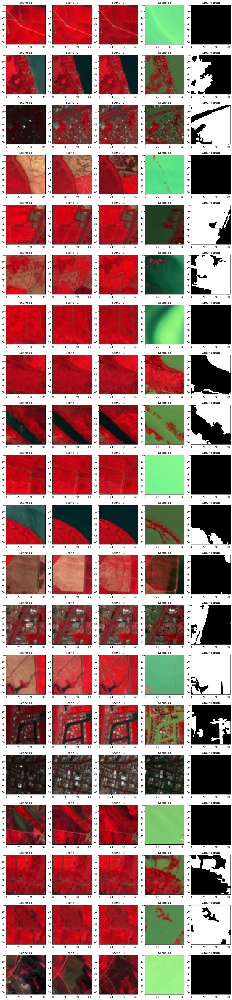

In [72]:
import matplotlib.pyplot as plt
import numpy as np

# Original
# Função para visualização das imagens
def visualize_images(num_rows, random_indices):
    fig, axes = plt.subplots(num_rows, 5, figsize=(14, 3*num_rows))

    for i in range(num_rows):
        idx = random_indices[i]

        # # Stack 
        image_t1 = np.stack([patche_cena[idx, :, :, 11], patche_cena[idx, :, :, 10],
                                 patche_cena[idx, :, :, 9]], axis=2)
        
        image_t2 = np.stack([patche_cena[idx, :, :, 8], patche_cena[idx, :, :, 7],
                                 patche_cena[idx, :, :, 6]], axis=2)

        image_t3 = np.stack([patche_cena[idx, :, :, 5], patche_cena[idx, :, :, 4],
                                 patche_cena[idx, :, :, 3]], axis=2)

        image_t4 = np.stack([patche_cena[idx, :, :, 2], patche_cena[idx, :, :, 1],
                                 patche_cena[idx, :, :, 0]], axis=2)

        # Normalização das imagens RGB
        image_t1 = image_t1 / image_t1.max()
        image_t2 = image_t2 / image_t2.max()
        image_t3 = image_t3 / image_t3.max()
        image_t4 = image_t4 / image_t4.max()

        # Predições
        ground_truth = np.squeeze(patche_classe[idx])

        # Plotar as imagens
        axes[i, 0].imshow(image_t1, cmap='gray')
        axes[i, 0].set_title('Scene T1')
        # axes[i, 0].axis('off')
        
        axes[i, 1].imshow(image_t2, cmap='gray')
        axes[i, 1].set_title('Scene T2')
        # axes[i, 0].axis('off')
        
        axes[i, 2].imshow(image_t3, cmap='gray')
        axes[i, 2].set_title('Scene T3')
        # axes[i, 2].axis('off')
        
        axes[i, 3].imshow(image_t4, cmap='gray')
        axes[i, 3].set_title('Scene T4')
        # axes[i, 3].axis('off')
        
        axes[i, 4].imshow(ground_truth, cmap='gray')
        axes[i, 4].set_title('Ground truth')
        # axes[i, 2].axis('off')


    plt.tight_layout()
    plt.show()

# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
indices = [31,32,33,34,35,36,40,41,42,43,45,46,47,48,55,56,57,58,59,88]
random_indices = np.random.randint(0, patche_cena.shape[0], num_samples)

# Visualizar as cenas e as classes lado a lado
visualize_images(num_samples, indices)


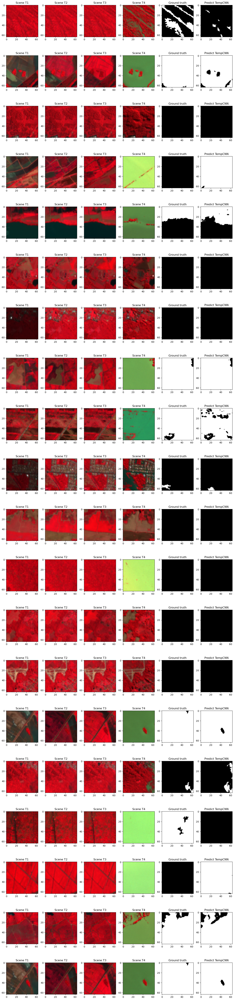

In [73]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['axes.grid'] = False

# Função para visualização das imagens
def visualize_images(pred_arg, num_rows, random_indices, name_model):
    fig, axes = plt.subplots(num_rows, 6, figsize=(14, 3*num_rows))

    for i in range(num_rows):
        idx = random_indices[i]

        # # Stack 
        image_t1 = np.stack([patche_cena_test[idx, :, :, 11], patche_cena_test[idx, :, :, 10],
                                 patche_cena_test[idx, :, :, 9]], axis=2)
        
        image_t2 = np.stack([patche_cena_test[idx, :, :, 8], patche_cena_test[idx, :, :, 7],
                                 patche_cena_test[idx, :, :, 6]], axis=2)

        image_t3 = np.stack([patche_cena_test[idx, :, :, 5], patche_cena_test[idx, :, :, 4],
                                 patche_cena_test[idx, :, :, 3]], axis=2)

        image_t4 = np.stack([patche_cena_test[idx, :, :, 2], patche_cena_test[idx, :, :, 1],
                                 patche_cena_test[idx, :, :, 0]], axis=2)

        # Normalização das imagens RGB
        image_t1 = image_t1 / image_t1.max()
        image_t2 = image_t2 / image_t2.max()
        image_t3 = image_t3 / image_t3.max()
        image_t4 = image_t4 / image_t4.max()

        # Predições
        ground_truth = np.squeeze(patche_classe_test[idx])
        predict = np.squeeze(pred_arg[idx])

        # Plotar as imagens
        axes[i, 0].imshow(image_t1, cmap='gray')
        axes[i, 0].set_title('Scene T1')
        # axes[i, 0].axis('off')

        axes[i, 1].imshow(image_t2, cmap='gray')
        axes[i, 1].set_title('Scene T2')
        # axes[i, 1].axis('off')

        axes[i, 2].imshow(image_t3, cmap='gray')
        axes[i, 2].set_title('Scene T3')
        # axes[i, 2].axis('off')

        axes[i, 3].imshow(image_t4, cmap='gray')
        axes[i, 3].set_title('Scene T4')
        # axes[i, 3].axis('off')

        axes[i, 4].imshow(ground_truth, cmap='gray')
        axes[i, 4].set_title('Ground truth')
        # axes[i, 4].axis('off')

        axes[i, 5].imshow(predict, cmap='gray')
        axes[i, 5].set_title(f'Predict {name_model}')
        # axes[i, 5].axis('off')

    plt.tight_layout()
    plt.show()

# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
random_indices = np.random.randint(0, patche_cena_test.shape[0], num_samples)

# Visualizar as cenas e as classes lado a lado
visualize_images(y_pred_argmax_tempcnn, num_samples, random_indices, 'TempCNN')


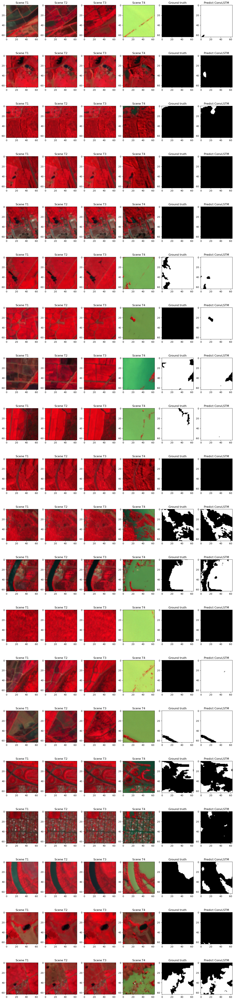

In [74]:
# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
random_indices = np.random.randint(0, patche_cena_test.shape[0], num_samples)

# Visualizar as cenas e as classes lado a lado
visualize_images(y_pred_argmax_tempcnn, num_samples, random_indices, 'ConvLSTM')


In [75]:
# random_indices):
#     fig, axes = plt.subplots(num_rows, 5, figsize=(14, 3*num_rows))

#     for i in range(num_rows):
#         idx = random_indices[i]
# # Escolha aleatoriamente algumas imagens para visualizar
# num_samples = 20
# indices = [32,33,34,35,40,41,42,43,44,45,46,47,48,49,56,57,58,59,88,89]
# random_indices = np.random.randint(0, patche_cena.shape[0], num_samples)

# # Visualizar as cenas e as classes lado a lado
# visualize_images(num_samples, indices)

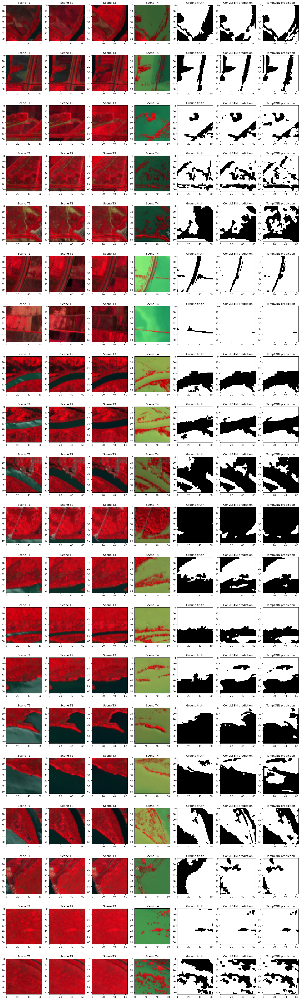

In [76]:
# Visualizar as duas predições
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['axes.grid'] = False

# Função para visualização das imagens
def visualize_images(pred_arg1, pred_arg2, num_rows, random_indices, name_model1, name_model2):
    fig, axes = plt.subplots(num_rows, 7, figsize=(18, 3*num_rows))

    for i in range(num_rows):
        idx = random_indices[i]

        # # Stack 
        image_t1 = np.stack([patche_cena_test[idx, :, :, 11], patche_cena_test[idx, :, :, 10],
                                 patche_cena_test[idx, :, :, 9]], axis=2)
        
        image_t2 = np.stack([patche_cena_test[idx, :, :, 8], patche_cena_test[idx, :, :, 7],
                                 patche_cena_test[idx, :, :, 6]], axis=2)

        image_t3 = np.stack([patche_cena_test[idx, :, :, 5], patche_cena_test[idx, :, :, 4],
                                 patche_cena_test[idx, :, :, 3]], axis=2)

        image_t4 = np.stack([patche_cena_test[idx, :, :, 2], patche_cena_test[idx, :, :, 1],
                                 patche_cena_test[idx, :, :, 0]], axis=2)

        # Normalização das imagens RGB
        image_t1 = image_t1 / image_t1.max()
        image_t2 = image_t2 / image_t2.max()
        image_t3 = image_t3 / image_t3.max()
        image_t4 = image_t4 / image_t4.max()

        # Predições
        ground_truth = np.squeeze(patche_classe_test[idx])
        predict1 = np.squeeze(pred_arg1[idx])
        predict2 = np.squeeze(pred_arg2[idx])

        # Plotar as imagens
        axes[i, 0].imshow(image_t1, cmap='gray')
        axes[i, 0].set_title('Scene T1')
        # axes[i, 0].axis('off')

        axes[i, 1].imshow(image_t2, cmap='gray')
        axes[i, 1].set_title('Scene T2')
        # axes[i, 1].axis('off')

        axes[i, 2].imshow(image_t3, cmap='gray')
        axes[i, 2].set_title('Scene T3')
        # axes[i, 2].axis('off')

        axes[i, 3].imshow(image_t4, cmap='gray')
        axes[i, 3].set_title('Scene T4')
        # axes[i, 3].axis('off')

        axes[i, 4].imshow(ground_truth, cmap='gray')
        axes[i, 4].set_title('Ground truth')
        # axes[i, 4].axis('off')

        axes[i, 5].imshow(predict1, cmap='gray')
        axes[i, 5].set_title(f'{name_model1} prediction')
        # axes[i, 5].axis('off')

        axes[i, 6].imshow(predict2, cmap='gray')
        axes[i, 6].set_title(f'{name_model2} prediction')
        # axes[i, 6].axis('off')


    plt.tight_layout()
    plt.show()

# # Escolha aleatoriamente algumas imagens para visualizar
# num_samples = 20
# random_indices = np.random.randint(0, patche_cena_test.shape[0], num_samples)


num_samples = 20
indices = [40,41,44,45,46,88,89,594,595,596,597,598,599,600,601,602,603,604,605,606]

# Visualizar as cenas e as classes lado a lado
visualize_images(y_pred_argmax_convlstm, y_pred_argmax_tempcnn, num_samples, indices, 'ConvLSTM', 'TempCNN')


In [77]:
############# merge patches
# train sem embaralhamento

print("Dataset train sem embaralhamento")
len_patches = int(len(patche_classe_) * 0.38)
# teste separado
patche_cena_test = patche_cena_[:len_patches]
patche_classe_test = patche_classe_[:len_patches]
print('Ds para teste: ', patche_classe_test.shape)

patche_cena = patche_cena_[len_patches:]
patche_classe = patche_classe_[len_patches:]
print('Ds para (treinamento) augmentation: ', patche_classe.shape)

Dataset train sem embaralhamento
Ds para teste:  (607, 64, 64, 1)
Ds para (treinamento) augmentation:  (991, 64, 64, 1)


In [78]:
n_bands = 12
# Apply the reshape function
patche_cena_test_reshaped = reshape_data(patche_cena_test, n_bands)

# ConvLSTM
y_pred_convlstm = model_conv_lstm.predict(patche_cena_test_reshaped)
y_pred_argmax_convlstm = np.argmax(y_pred_convlstm, axis=-1) 
y_pred_argmax_convlstm = y_pred_argmax_convlstm.astype('int16')
#train
patche_cena_train_reshaped = reshape_data(patche_cena, n_bands)

# ConvLSTM
y_pred_convlstm_train = model_conv_lstm.predict(patche_cena_train_reshaped)
y_pred_argmax_convlstm_train = np.argmax(y_pred_convlstm_train, axis=-1)  # Predictions in terms of class
y_pred_argmax_convlstm_train = y_pred_argmax_convlstm_train.astype('int16')


19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
31/31 ━━━━━━━━━━━━━━━━━━━━ 1s 28ms/step


In [79]:
n_bands = 12
# Apply the reshape function
patche_cena_test_reshaped = reshape_data(patche_cena_test, n_bands)

# tempcnn
y_pred_tempcnn = model_tempcnn.predict(patche_cena_test_reshaped)
y_pred_argmax_tempcnn = np.argmax(y_pred_tempcnn, axis=-1) 
y_pred_argmax_tempcnn = y_pred_argmax_tempcnn.astype('int16')
#train
patche_cena_train_reshaped = reshape_data(patche_cena, n_bands)

# tempcnn
y_pred_tempcnn_train = model_tempcnn.predict(patche_cena_train_reshaped)
y_pred_argmax_tempcnn_train = np.argmax(y_pred_tempcnn_train, axis=-1)  # Predictions in terms of class
y_pred_argmax_tempcnn_train = y_pred_argmax_tempcnn_train.astype('int16')

19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


In [80]:
patche_classe_.shape #(1598, 64, 64)

(1598, 64, 64, 1)

In [81]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import confusion_matrix
import warnings
import logging

logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

def calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test, global_iou_metric=None):
    img_teste = patche_cena_test[id_img_teste]
    ground_truth = patche_classe_test[id_img_teste]

    # Verificar formas
    logger.info(f"Imagem {id_img_teste} - Shape de img_teste: {img_teste.shape}")
    logger.info(f"Imagem {id_img_teste} - Shape de ground_truth: {ground_truth.shape}")

    # Converter ground truth
    if len(ground_truth.shape) == 3 and ground_truth.shape[-1] == 2:  # One-hot (64, 64, 2)
        ground_truth = np.argmax(ground_truth, axis=-1)  # Shape: (64, 64)
    else:
        ground_truth = np.squeeze(ground_truth)  # Shape: (64, 64)

    # Validar valores do ground truth
    unique_gt = np.unique(ground_truth)
    if not np.all(np.isin(unique_gt, [0, 1])):
        raise ValueError(f"Ground truth contains invalid values: {unique_gt}")
    logger.info(f"Imagem {id_img_teste} - Valores únicos em ground_truth: {unique_gt}")

    # Preparar entrada para o modelo
    img_test = np.expand_dims(img_teste, axis=0)  # Shape: (1, 64, 64, 12)
    img_test = np.expand_dims(img_test, axis=1)   # Shape: (1, 1, 64, 64, 12)
    
    # Fazer predição
    predictions = model.predict(img_test, verbose=0)  # Shape: (1, 1, 64, 64, 2)
    predictions = tf.argmax(predictions, axis=-1)  # Shape: (1, 1, 64, 64)
    predictions = np.squeeze(predictions)  # Shape: (64, 64)
    
    # Validar valores das predições
    unique_pred = np.unique(predictions)
    if not np.all(np.isin(unique_pred, [0, 1])):
        raise ValueError(f"Predictions contain invalid values: {unique_pred}")
    logger.info(f"Imagem {id_img_teste} - Valores únicos em predictions: {unique_pred}")

    # Verificar compatibilidade de formas
    if ground_truth.shape != predictions.shape:
        raise ValueError(f"Shape mismatch: ground_truth {ground_truth.shape} vs predictions {predictions.shape}")

    # Calcular matriz de confusão
    cm = confusion_matrix(ground_truth.flatten(), predictions.flatten(), labels=[0, 1])
    logger.info(f"Imagem {id_img_teste} - Matriz de confusão:\n{cm}")

    # Calcular IoU manualmente apenas para classes presentes no ground truth
    iou_values = []
    for cls in unique_gt:
        tp = cm[cls, cls]
        fp = cm[:, cls].sum() - tp
        fn = cm[cls, :].sum() - tp
        if tp + fp + fn == 0:
            logger.warning(f"Imagem {id_img_teste} - Classe {cls}: Nenhuma interseção ou união significativa. IoU = 0.")
        iou = tp / (tp + fp + fn + 1e-10)
        iou_values.append(iou)

    if not iou_values:
        warnings.warn(f"Imagem {id_img_teste} - Nenhuma classe válida encontrada no ground truth. Retornando IoU como None.")
        iou_mean = None
    else:
        iou_mean = np.mean(iou_values)
        logger.info(f'Imagem {id_img_teste} - Mean IoU: {iou_mean:.10f}')

    # Atualizar métrica global de IoU, se fornecida
    if global_iou_metric is not None:
        global_iou_metric.update_state(ground_truth, predictions)

    return iou_mean

def calcular_media_iou(model, patche_cena_test, patche_classe_test):
    valores_iou_mean = []
    
    # Inicializar métrica global de IoU
    global_iou_metric = tf.keras.metrics.MeanIoU(num_classes=2)
    # global_iou_metric.reset_states()  # Garantir estado limpo
    
    for id_img_teste in range(len(patche_cena_test)):
        iou_mean = calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test, global_iou_metric)
        if iou_mean is not None:
            valores_iou_mean.append(iou_mean)
    
    # Calcular média dos IoUs por patch
    media_iou_mean = np.mean(valores_iou_mean) if valores_iou_mean else 0.0
    
    # Calcular IoU global
    global_iou = global_iou_metric.result().numpy()
    
    logger.info(f'Média do Mean IoU para todas as imagens: {media_iou_mean:.10f}')
    logger.info(f'Global Mean IoU para todas as imagens: {global_iou:.10f}')
    logger.info(f"Primeiros 5 valores de iou_per_img_tempcnn: {valores_iou_mean[:5]}")
    
    return valores_iou_mean, global_iou

iou_per_img_convlstm, miou_convlstm = calcular_media_iou(model_conv_lstm, patche_cena_test, patche_classe_test)

INFO:__main__:Imagem 0 - Shape de img_teste: (64, 64, 12)


INFO:__main__:Imagem 0 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 0 - Valores únicos em ground_truth: [0]
INFO:__main__:Imagem 0 - Valores únicos em predictions: [0]
INFO:__main__:Imagem 0 - Matriz de confusão:
[[4096    0]
 [   0    0]]
INFO:__main__:Imagem 0 - Mean IoU: 1.0000000000
INFO:__main__:Imagem 1 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 1 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 1 - Valores únicos em ground_truth: [0]
INFO:__main__:Imagem 1 - Valores únicos em predictions: [0]
INFO:__main__:Imagem 1 - Matriz de confusão:
[[4096    0]
 [   0    0]]
INFO:__main__:Imagem 1 - Mean IoU: 1.0000000000
INFO:__main__:Imagem 2 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 2 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 2 - Valores únicos em ground_truth: [0]
INFO:__main__:Imagem 2 - Valores únicos em predictions: [0]
INFO:__main__:Imagem 2 - Matriz de confusão:
[[4096    0]
 [   0    0]]
INFO:__main__:Imagem 2 - Mean

In [82]:
iou_per_img_convlstm_train, miou_convlstm_train = calcular_media_iou(model_conv_lstm, patche_cena, patche_classe)

INFO:__main__:Imagem 0 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 0 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 0 - Valores únicos em ground_truth: [0 1]
INFO:__main__:Imagem 0 - Valores únicos em predictions: [0 1]
INFO:__main__:Imagem 0 - Matriz de confusão:
[[1346  244]
 [ 799 1707]]
INFO:__main__:Imagem 0 - Mean IoU: 0.5920714639
INFO:__main__:Imagem 1 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 1 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 1 - Valores únicos em ground_truth: [0 1]
INFO:__main__:Imagem 1 - Valores únicos em predictions: [0 1]
INFO:__main__:Imagem 1 - Matriz de confusão:
[[1692   26]
 [1033 1345]]
INFO:__main__:Imagem 1 - Mean IoU: 0.5872666330
INFO:__main__:Imagem 2 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 2 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 2 - Valores únicos em ground_truth: [0 1]
INFO:__main__:Imagem 2 - Valores únicos em predictions: [0 1]
INFO:__main__:Imagem 2 - Matriz

In [83]:
iou_per_img_tempcnn, miou_tempcnn = calcular_media_iou(model_tempcnn, patche_cena_test, patche_classe_test)

INFO:__main__:Imagem 0 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 0 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 0 - Valores únicos em ground_truth: [0]
INFO:__main__:Imagem 0 - Valores únicos em predictions: [0]
INFO:__main__:Imagem 0 - Matriz de confusão:
[[4096    0]
 [   0    0]]
INFO:__main__:Imagem 0 - Mean IoU: 1.0000000000
INFO:__main__:Imagem 1 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 1 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 1 - Valores únicos em ground_truth: [0]
INFO:__main__:Imagem 1 - Valores únicos em predictions: [0]
INFO:__main__:Imagem 1 - Matriz de confusão:
[[4096    0]
 [   0    0]]
INFO:__main__:Imagem 1 - Mean IoU: 1.0000000000
INFO:__main__:Imagem 2 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 2 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 2 - Valores únicos em ground_truth: [0]
INFO:__main__:Imagem 2 - Valores únicos em predictions: [0]
INFO:__main__:Imagem 2 - Matriz de confusão

In [84]:
iou_per_img_tempcnn_train, miou_tempcnn_train = calcular_media_iou(model_tempcnn, patche_cena, patche_classe)

INFO:__main__:Imagem 0 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 0 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 0 - Valores únicos em ground_truth: [0 1]
INFO:__main__:Imagem 0 - Valores únicos em predictions: [0 1]
INFO:__main__:Imagem 0 - Matriz de confusão:
[[1344  246]
 [ 459 2047]]
INFO:__main__:Imagem 0 - Mean IoU: 0.6998761981
INFO:__main__:Imagem 1 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 1 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 1 - Valores únicos em ground_truth: [0 1]
INFO:__main__:Imagem 1 - Valores únicos em predictions: [0 1]
INFO:__main__:Imagem 1 - Matriz de confusão:
[[1563  155]
 [ 627 1751]]
INFO:__main__:Imagem 1 - Mean IoU: 0.6788998440
INFO:__main__:Imagem 2 - Shape de img_teste: (64, 64, 12)
INFO:__main__:Imagem 2 - Shape de ground_truth: (64, 64, 1)
INFO:__main__:Imagem 2 - Valores únicos em ground_truth: [0 1]
INFO:__main__:Imagem 2 - Valores únicos em predictions: [0 1]
INFO:__main__:Imagem 2 - Matriz

In [85]:
# Arredonda os valores para 3 casas decimais
iou_per_img_convlstm = np.round(iou_per_img_convlstm, 3)
iou_per_img_convlstm_train = np.round(iou_per_img_convlstm_train, 3)

iou_per_img_tempcnn = np.round(iou_per_img_tempcnn, 3)
iou_per_img_tempcnn_train = np.round(iou_per_img_tempcnn_train, 3)



In [86]:
# import numpy as np
# import matplotlib.pyplot as plt
# import matplotlib.colors as mcolors
# import matplotlib.patches as mpatches
# from mpl_toolkits.axes_grid1 import make_axes_locatable

# # Escolha o modelo
# modelo_selecionado = "ConvLSTM"

# # Total de patches
# grid_rows = 34
# grid_cols = 47
# total_patches = grid_rows * grid_cols  # 1598

# # Quantidade de patches
# num_treino = 991
# num_teste = total_patches - num_treino  # 607

# # Verificação e concatenação
# if modelo_selecionado == "ConvLSTM":
#     if len(iou_per_img_convlstm_train) != num_treino or len(iou_per_img_convlstm) != num_teste:
#         raise ValueError(f"mIoU ConvLSTM (treino: {len(iou_per_img_convlstm_train)}, teste: {len(iou_per_img_convlstm)}) não corresponde a ({num_treino}, {num_teste}).")
#     miou_valores = np.concatenate((iou_per_img_convlstm, iou_per_img_convlstm_train))
#     plot_title = f"mIoU heatmap by Patch ({modelo_selecionado}"
# elif modelo_selecionado == "TempCNN":
#     if len(iou_per_img_tempcnn_train) != num_treino or len(iou_per_img_tempcnn) != num_teste:
#         raise ValueError(f"mIoU TempCNN (treino: {len(iou_per_img_tempcnn_train)}, teste: {len(iou_per_img_tempcnn)}) não corresponde a ({num_treino}, {num_teste}).")
#     miou_valores = np.concatenate((iou_per_img_tempcnn, iou_per_img_tempcnn_train))
#     plot_title = f"mIoU heatmap by Patch ({modelo_selecionado})"
# else:
#     raise ValueError(f"Modelo '{modelo_selecionado}' inválido. Escolha 'ConvLSTM' ou 'TempCNN'.")

# # Verifica o total
# assert len(miou_valores) == total_patches, f"mIoU total ({len(miou_valores)}) não corresponde a {total_patches}"

# # Reformatar para grade
# miou_grid = miou_valores.reshape((grid_rows, grid_cols))

# # Criar heatmap
# fig, ax = plt.subplots(figsize=(12, 9))
# cmap = plt.cm.viridis
# norm = mcolors.Normalize(vmin=0, vmax=1)

# im = ax.imshow(miou_grid, cmap=cmap, norm=norm, origin='upper', interpolation='none')

# # Colorbar
# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="2%", pad=0.05)
# cbar = plt.colorbar(im, cax=cax)
# cbar.set_label('mIoU')

# # Tira ticks
# ax.tick_params(which="both", bottom=False, left=False, labelbottom=False, labelleft=False)

# # Destacar patches de teste (índices 0 a 606)
# for idx in range(num_teste):
#     row = idx // grid_cols
#     col = idx % grid_cols
#     rect = mpatches.Rectangle((col - 0.5, row - 0.5), 1, 1, fill=False, hatch='//', edgecolor='red')
#     ax.add_patch(rect)

# # Legenda
# hatch_patch = mpatches.Patch(hatch='//', facecolor='none', edgecolor='red', label='Test Patches')
# ax.legend(handles=[hatch_patch], loc='upper right', bbox_to_anchor=(1.25, 1))

# # Título
# ax.set_title(f"{plot_title})")

# # Layout
# plt.tight_layout(rect=[0, 0, 0.92, 1])

# # Salvar
# output_filename = f"heatmap_miou_{modelo_selecionado.lower()}_corrected.png"
# plt.savefig(output_filename, dpi=300, bbox_inches='tight')
# print(f"Heatmap para {modelo_selecionado} salvo em: {output_filename}")
# # plt.close()

Heatmap para ConvLSTM salvo em: heatmap_miou_convlstm_corrected.png


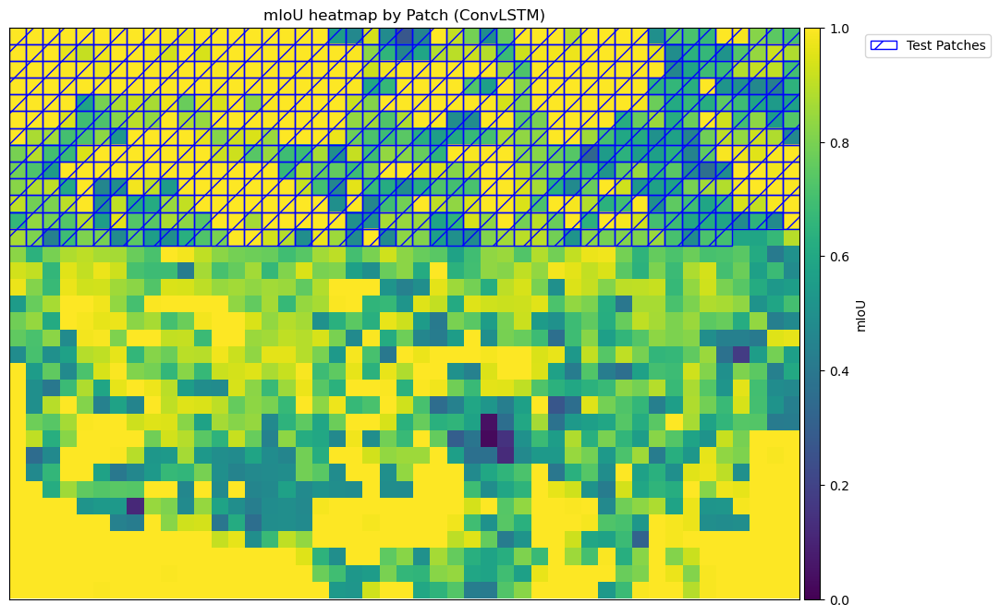

In [87]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Escolha o modelo
modelo_selecionado = "ConvLSTM"

# Total de patches
grid_rows = 34
grid_cols = 47
total_patches = grid_rows * grid_cols  # 1598

# Quantidade de patches
num_treino = 991
num_teste = total_patches - num_treino  # 607

# Verificação e concatenação
if modelo_selecionado == "ConvLSTM":
    if len(iou_per_img_convlstm_train) != num_treino or len(iou_per_img_convlstm) != num_teste:
        raise ValueError(f"mIoU ConvLSTM (treino: {len(iou_per_img_convlstm_train)}, teste: {len(iou_per_img_convlstm)}) não corresponde a ({num_treino}, {num_teste}).")
    miou_valores = np.concatenate((iou_per_img_convlstm, iou_per_img_convlstm_train))
    plot_title = f"mIoU heatmap by Patch ({modelo_selecionado}"
elif modelo_selecionado == "TempCNN":
    if len(iou_per_img_tempcnn_train) != num_treino or len(iou_per_img_tempcnn) != num_teste:
        raise ValueError(f"mIoU TempCNN (treino: {len(iou_per_img_tempcnn_train)}, teste: {len(iou_per_img_tempcnn)}) não corresponde a ({num_treino}, {num_teste}).")
    miou_valores = np.concatenate((iou_per_img_tempcnn, iou_per_img_tempcnn_train))
    plot_title = f"mIoU heatmap by Patch ({modelo_selecionado})"
else:
    raise ValueError(f"Modelo '{modelo_selecionado}' inválido. Escolha 'ConvLSTM' ou 'TempCNN'.")

# Verifica o total
assert len(miou_valores) == total_patches, f"mIoU total ({len(miou_valores)}) não corresponde a {total_patches}"

# Reformatar para grade
miou_grid = miou_valores.reshape((grid_rows, grid_cols))

# Criar heatmap
fig, ax = plt.subplots(figsize=(12, 9))
cmap = plt.cm.viridis
norm = mcolors.Normalize(vmin=0, vmax=1)

im = ax.imshow(miou_grid, cmap=cmap, norm=norm, origin='upper', interpolation='none')

# Colorbar
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="2%", pad=0.05)
cbar = plt.colorbar(im, cax=cax)
cbar.set_label('mIoU')

# Tira ticks
ax.tick_params(which="both", bottom=False, left=False, labelbottom=False, labelleft=False)

# Destacar patches de teste (índices 0 a 606)
for idx in range(num_teste):
    row = idx // grid_cols
    col = idx % grid_cols
    rect = mpatches.Rectangle((col - 0.52, row - 0.52), 1, 1, fill=False, hatch='/', edgecolor='blue')
    ax.add_patch(rect)

# Legenda
hatch_patch = mpatches.Patch(hatch='/', facecolor='none', edgecolor='blue', label='Test Patches')
ax.legend(handles=[hatch_patch], loc='upper right', bbox_to_anchor=(1.25, 1))

# Título
ax.set_title(f"{plot_title})")

# Layout
plt.tight_layout(rect=[0, 0, 0.92, 1])

# Salvar
output_filename = f"heatmap_miou_{modelo_selecionado.lower()}_corrected.png"
plt.savefig(output_filename, dpi=300, bbox_inches='tight')
print(f"Heatmap para {modelo_selecionado} salvo em: {output_filename}")
# plt.close()

Heatmap para TempCNN salvo em: heatmap_miou_tempcnn_corrected.png


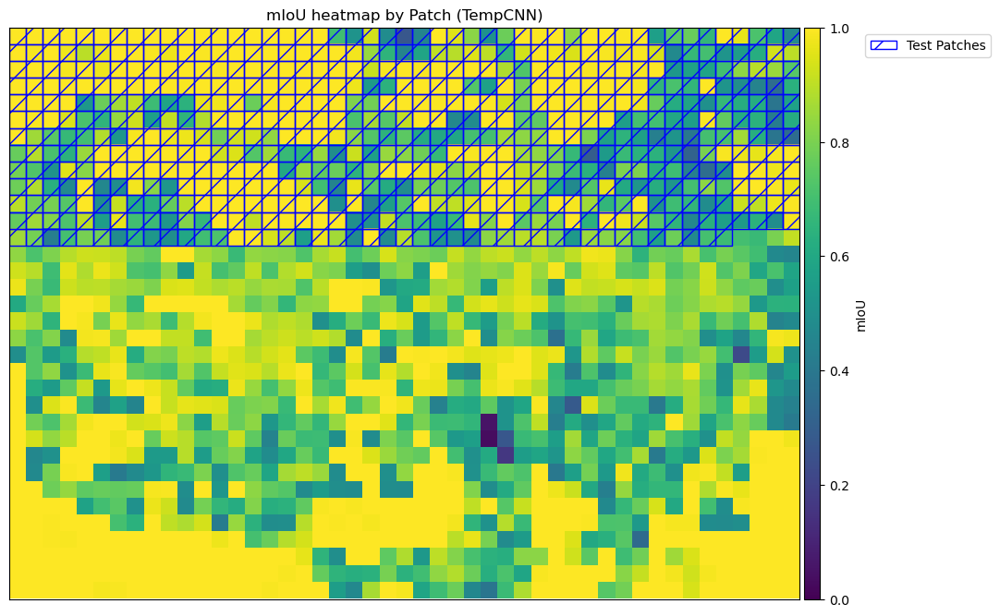

In [88]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Escolha o modelo
modelo_selecionado = "TempCNN"

# Total de patches
grid_rows = 34
grid_cols = 47
total_patches = grid_rows * grid_cols  # 1598

# Quantidade de patches
num_treino = 991
num_teste = total_patches - num_treino  # 607

# Verificação e concatenação
if modelo_selecionado == "ConvLSTM":
    if len(iou_per_img_convlstm_train) != num_treino or len(iou_per_img_convlstm) != num_teste:
        raise ValueError(f"mIoU ConvLSTM (treino: {len(iou_per_img_convlstm_train)}, teste: {len(iou_per_img_convlstm)}) não corresponde a ({num_treino}, {num_teste}).")
    miou_valores = np.concatenate((iou_per_img_convlstm, iou_per_img_convlstm_train))
    plot_title = f"mIoU heatmap by Patch ({modelo_selecionado}"
elif modelo_selecionado == "TempCNN":
    if len(iou_per_img_tempcnn_train) != num_treino or len(iou_per_img_tempcnn) != num_teste:
        raise ValueError(f"mIoU TempCNN (treino: {len(iou_per_img_tempcnn_train)}, teste: {len(iou_per_img_tempcnn)}) não corresponde a ({num_treino}, {num_teste}).")
    miou_valores = np.concatenate((iou_per_img_tempcnn, iou_per_img_tempcnn_train))
    plot_title = f"mIoU heatmap by Patch ({modelo_selecionado}"
else:
    raise ValueError(f"Modelo '{modelo_selecionado}' inválido. Escolha 'ConvLSTM' ou 'TempCNN'.")

# Verifica o total
assert len(miou_valores) == total_patches, f"mIoU total ({len(miou_valores)}) não corresponde a {total_patches}"

# Reformatar para grade
miou_grid = miou_valores.reshape((grid_rows, grid_cols))

# Criar heatmap
fig, ax = plt.subplots(figsize=(12, 9))
cmap = plt.cm.viridis
norm = mcolors.Normalize(vmin=0, vmax=1)

im = ax.imshow(miou_grid, cmap=cmap, norm=norm, origin='upper', interpolation='none')

# Colorbar
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="2%", pad=0.05)
cbar = plt.colorbar(im, cax=cax)
cbar.set_label('mIoU')

# Tira ticks
ax.tick_params(which="both", bottom=False, left=False, labelbottom=False, labelleft=False)

# Destacar patches de teste (índices 0 a 606)
for idx in range(num_teste):
    row = idx // grid_cols
    col = idx % grid_cols
    rect = mpatches.Rectangle((col - 0.52, row - 0.52), 1, 1, fill=False, hatch='/', edgecolor='blue')
    ax.add_patch(rect)

# Legenda
hatch_patch = mpatches.Patch(hatch='/', facecolor='none', edgecolor='blue', label='Test Patches')
ax.legend(handles=[hatch_patch], loc='upper right', bbox_to_anchor=(1.25, 1))

# Título
ax.set_title(f"{plot_title})")

# Layout
plt.tight_layout(rect=[0, 0, 0.92, 1])

# Salvar
output_filename = f"heatmap_miou_{modelo_selecionado.lower()}_corrected.png"
plt.savefig(output_filename, dpi=300, bbox_inches='tight')
print(f"Heatmap para {modelo_selecionado} salvo em: {output_filename}")
# plt.close()

### Reconstruct Patches

In [102]:
#ConvLSTM
import numpy as np
from skimage.io import imsave
import tensorflow as tf
import os

# Função para reshape (ajuste conforme sua implementação)
def reshape_data(data, n_bands):
    # Exemplo: adiciona dimensão temporal
    return np.expand_dims(data, axis=1)  # (N, 1, 64, 64, 12)

# Parâmetros
n_bands = 12
n_rows = 34
n_cols = 47
patch_size = 64
total_patches = n_rows * n_cols  # 1598
num_treino = 991
num_teste = 607

# Verificar dados
assert patche_cena.shape == (num_treino, patch_size, patch_size, n_bands), \
    f"patche_cena shape {patche_cena.shape} != ({num_treino}, {patch_size}, {patch_size}, {n_bands})"
assert patche_cena_test.shape == (num_teste, patch_size, patch_size, n_bands), \
    f"patche_cena_test shape {patche_cena_test.shape} != ({num_teste}, {patch_size}, {patch_size}, {n_bands})"

# Reshape dados
patche_cena_train_reshaped = reshape_data(patche_cena, n_bands)  # (991, 1, 64, 64, 12)
patche_cena_test_reshaped = reshape_data(patche_cena_test, n_bands)    # (607, 1, 64, 64, 12)

# Previsões convlstm
print("Gerando previsões para treino (convlstm)...")
y_pred_convlstm_train = model_conv_lstm.predict(patche_cena_train_reshaped, verbose=0)  # (991, 1, 64, 64, 2)
y_pred_convlstm_train = np.squeeze(y_pred_convlstm_train)  # (991, 64, 64, 2)
y_pred_argmax_convlstm_train = np.argmax(y_pred_convlstm_train, axis=-1).astype(np.int16)  # (991, 64, 64)

print("Gerando previsões para teste (convlstm)...")
y_pred_convlstm = model_conv_lstm.predict(patche_cena_test_reshaped, verbose=0)  # (607, 1, 64, 64, 2)
y_pred_convlstm = np.squeeze(y_pred_convlstm)  # (607, 64, 64, 2)
y_pred_argmax_convlstm = np.argmax(y_pred_convlstm, axis=-1).astype(np.int16)  # (607, 64, 64)

# Verificar shapes
print(f"Shape y_pred_argmax_convlstm_train: {y_pred_argmax_convlstm_train.shape}")
print(f"Shape y_pred_argmax_convlstm: {y_pred_argmax_convlstm.shape}")

# Concatenar patches (treino + teste)
patches_pred = np.concatenate([y_pred_argmax_convlstm, y_pred_argmax_convlstm_train], axis=0)  # (1598, 64, 64)
assert patches_pred.shape[0] == total_patches, \
    f"Total de patches {patches_pred.shape[0]} != {total_patches}"

# Função de reconstrução
def reconstruct_image_from_patches(patches, n_rows, n_cols, h_crop, w_crop):
    reconstructed = np.zeros((n_rows * h_crop, n_cols * w_crop), dtype=patches.dtype)
    idx = 0
    for i in range(n_rows):
        for j in range(n_cols):
            if idx < len(patches):
                reconstructed[i*h_crop:(i+1)*h_crop, j*w_crop:(j+1)*w_crop] = patches[idx]
                idx += 1
            else:
                break
    return reconstructed

# Reconstruir imagem
reconstructed = reconstruct_image_from_patches(patches_pred, n_rows, n_cols, patch_size, patch_size)
print(f"Shape da imagem reconstruída: {reconstructed.shape}")  # (2176, 3008)

# Salvar imagem
output_path = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_convlstm.tif'
imsave(output_path, reconstructed.astype(np.uint8))
print(f"Imagem reconstruída salva em: {output_path}")

Gerando previsões para treino (convlstm)...
Gerando previsões para teste (convlstm)...
Shape y_pred_argmax_convlstm_train: (991, 64, 64)
Shape y_pred_argmax_convlstm: (607, 64, 64)
Shape da imagem reconstruída: (2176, 3008)
Imagem reconstruída salva em: /home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_convlstm.tif


/tmp/ipykernel_786126/1329205709.py:70: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_convlstm.tif is a low contrast image
  imsave(output_path, reconstructed.astype(np.uint8))


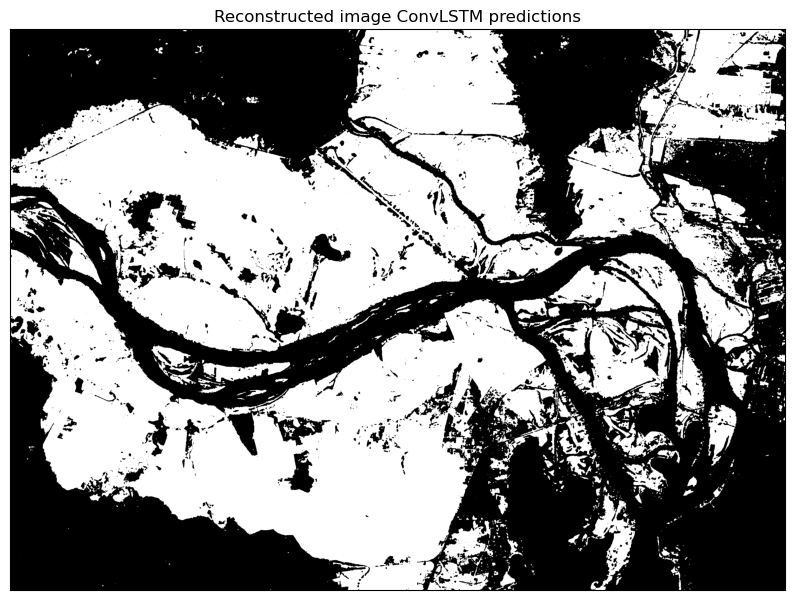

In [103]:
plt.figure(figsize=(10, 10))
plt.title('Reconstructed image ConvLSTM predictions')
# plt.xlabel('Columns')
# plt.ylabel('Rows')
# Remover a numeração dos eixos
plt.xticks([])
plt.yticks([])
plt.imshow(reconstructed, cmap='gray')

(1, 2176, 3008)

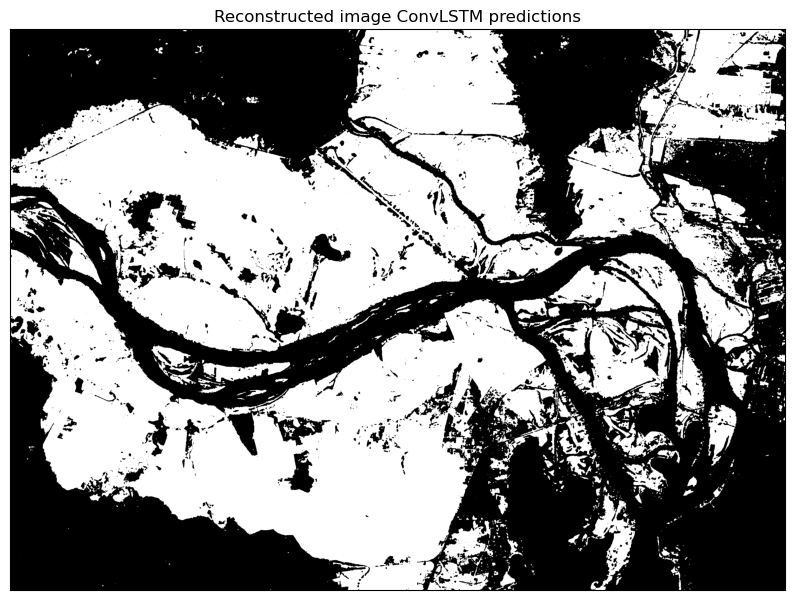

In [104]:
import rasterio
path = rasterio.open('/home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_convlstm.tif').read()

# img = rasterio.open('../aulas/dados/geoinformatic_floods_paper/Sentinel2_classes.tif').read()
# path = img[:,300:2500,5156:8192] ##[:,300:2500,5156:8192] <-melhor balanceado #path = img[:,10:3000,5000:8400] 
plt.figure(figsize=(10, 10))
plt.title('Reconstructed image ConvLSTM predictions')
# plt.xlabel('Columns')
# plt.ylabel('Rows')
# Remover a numeração dos eixos
plt.xticks([])
plt.yticks([])
plt.imshow(path[0,:,:], cmap='gray');
path.shape

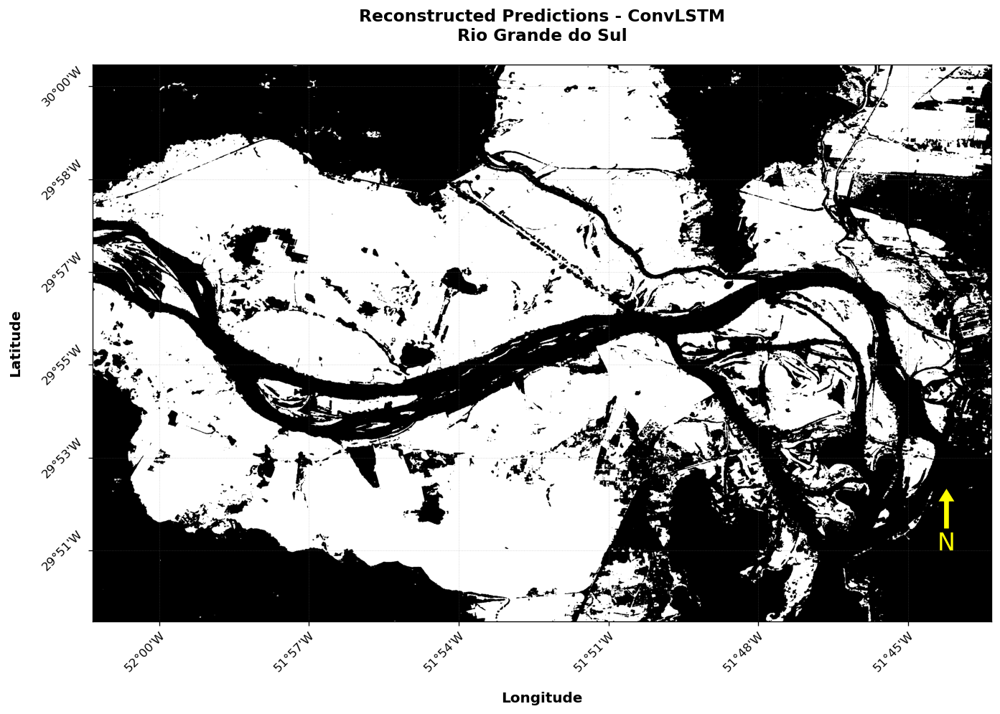

In [105]:
import numpy as np
import rasterio
from pyproj import CRS, Transformer
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator

# Funções de formatação de coordenadas melhoradas
def decimal_to_dms(value, coord_type):
    degrees = int(abs(value))
    minutes = int((abs(value) - degrees) * 60)
    hemisphere = 'W' if value < 0 else 'E' if coord_type == 'lon' else 'S' if value < 0 else 'N'
    return f"{degrees}°{minutes:02d}'{hemisphere}"  # :02d para minutos com dois dígitos

def lon_formatter(x, pos):
    return decimal_to_dms(x, 'lon')

def lat_formatter(y, pos):
    return decimal_to_dms(y, 'lat')

# Reconstrução da imagem (mantida igual)
reconstructed = reconstruct_image_from_patches(patches_pred, n_rows, n_cols, patch_size, patch_size)

ref_raster_path = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/raster_out_concatenate_charter_t4.tif'
# Obtenção das coordenadas (mantida igual)
with rasterio.open(ref_raster_path) as src:
    transform = src.transform
    crs_utm = CRS(src.crs)

transformer = Transformer.from_crs(crs_utm, CRS("EPSG:4674"), always_xy=True)
min_x, max_y = transform * (0, 0)
max_x, min_y = transform * (reconstructed.shape[1], reconstructed.shape[0])
min_lon, min_lat = transformer.transform(min_x, min_y)
max_lon, max_lat = transformer.transform(max_x, max_y)

# Configuração da figura com melhorias
plt.figure(figsize=(12, 8), dpi=120)  # Aumentando o DPI para melhor qualidade
ax = plt.gca()

# Visualização da imagem com contraste aprimorado
img = ax.imshow(reconstructed, 
                cmap='gray',
                vmin=np.percentile(reconstructed, 5),  # Ajuste automático de contraste
                vmax=np.percentile(reconstructed, 95),
                extent=[min_lon, max_lon, max_lat, min_lat])

# Configuração dos eixos melhorada
ax.xaxis.set_major_formatter(plt.FuncFormatter(lon_formatter))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lat_formatter))
ax.tick_params(axis='both', which='major', labelsize=10)

# Definir intervalos regulares para os ticks
ax.xaxis.set_major_locator(MultipleLocator(base=(max_lon-min_lon)/6))  # 6 divisões
ax.yaxis.set_major_locator(MultipleLocator(base=(max_lat-min_lat)/6))

# Rotação e alinhamento dos rótulos
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', rotation_mode='anchor')
plt.setp(ax.get_yticklabels(), rotation=45, va='center')

# Labels and title
plt.xlabel("Longitude", fontsize=12, labelpad=15, fontweight='bold')
plt.ylabel("Latitude", fontsize=12, labelpad=15, fontweight='bold')
plt.title('Reconstructed Predictions - ConvLSTM\nRio Grande do Sul',
          fontsize=14, pad=20, fontweight='bold')

# Grid mais sutil
ax.grid(True, linestyle=':', color='gray', alpha=0.4, linewidth=0.5)

# # Norte posicionado
# ax.annotate('N', xy=(0.98, 0.98), xytext=(0.98, 0.88),
#             arrowprops=dict(facecolor='yellow', width=4, headwidth=12),
#             ha='center', va='center', fontsize=18,
#             xycoords=ax.transAxes)
# Adicionar a orientação do norte
x, y, arrow_length = 0.95, 0.24, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length), color='yellow',
            arrowprops=dict(facecolor='yellow', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Adicionar escala gráfica
scale_length = 0.1 * (max_lon - min_lon)  # 10% da largura
ax.plot([min_lon + 0.05*(max_lon-min_lon), min_lon + 0.05*(max_lon-min_lon) + scale_length],
        [min_lat + 0.05*(max_lat-min_lat), min_lat + 0.05*(max_lat-min_lat)],
        color='black', linewidth=2)
ax.text(min_lon + 0.05*(max_lon-min_lon) + scale_length/2,
        min_lat + 0.06*(max_lat-min_lat),
        f"{scale_length:.3f}°", ha='center', fontsize=10)

plt.tight_layout()
plt.savefig('/home/cesar/geoinformatica/ConvLSTM_TempCNN/predicoes_reconstruidas_convlstm_coordenadas.png', 
            dpi=300, bbox_inches='tight')
plt.show()

In [106]:
#### TempCNN

In [107]:
import numpy as np
from skimage.io import imsave
import tensorflow as tf
import os

# Função para reshape (ajuste conforme sua implementação)
def reshape_data(data, n_bands):
    # Exemplo: adiciona dimensão temporal
    return np.expand_dims(data, axis=1)  # (N, 1, 64, 64, 12)

# Parâmetros
n_bands = 12
n_rows = 34
n_cols = 47
patch_size = 64
total_patches = n_rows * n_cols  # 1598
num_treino = 991
num_teste = 607

# Verificar dados
assert patche_cena.shape == (num_treino, patch_size, patch_size, n_bands), \
    f"patche_cena shape {patche_cena.shape} != ({num_treino}, {patch_size}, {patch_size}, {n_bands})"
assert patche_cena_test.shape == (num_teste, patch_size, patch_size, n_bands), \
    f"patche_cena_test shape {patche_cena_test.shape} != ({num_teste}, {patch_size}, {patch_size}, {n_bands})"

# Reshape dados
patche_cena_train_reshaped = reshape_data(patche_cena, n_bands)  # (991, 1, 64, 64, 12)
patche_cena_test_reshaped = reshape_data(patche_cena_test, n_bands)    # (607, 1, 64, 64, 12)

# Previsões TempCNN
print("Gerando previsões para treino (TempCNN)...")
y_pred_tempcnn_train = model_tempcnn.predict(patche_cena_train_reshaped, verbose=0)  # (991, 1, 64, 64, 2)
y_pred_tempcnn_train = np.squeeze(y_pred_tempcnn_train)  # (991, 64, 64, 2)
y_pred_argmax_tempcnn_train = np.argmax(y_pred_tempcnn_train, axis=-1).astype(np.int16)  # (991, 64, 64)

print("Gerando previsões para teste (TempCNN)...")
y_pred_tempcnn = model_tempcnn.predict(patche_cena_test_reshaped, verbose=0)  # (607, 1, 64, 64, 2)
y_pred_tempcnn = np.squeeze(y_pred_tempcnn)  # (607, 64, 64, 2)
y_pred_argmax_tempcnn = np.argmax(y_pred_tempcnn, axis=-1).astype(np.int16)  # (607, 64, 64)

# Verificar shapes
print(f"Shape y_pred_argmax_tempcnn_train: {y_pred_argmax_tempcnn_train.shape}")
print(f"Shape y_pred_argmax_tempcnn: {y_pred_argmax_tempcnn.shape}")

# Concatenar patches (treino + teste)
patches_pred = np.concatenate([y_pred_argmax_tempcnn, y_pred_argmax_tempcnn_train], axis=0)  # (1598, 64, 64)
assert patches_pred.shape[0] == total_patches, \
    f"Total de patches {patches_pred.shape[0]} != {total_patches}"

# Função de reconstrução
def reconstruct_image_from_patches(patches, n_rows, n_cols, h_crop, w_crop):
    reconstructed = np.zeros((n_rows * h_crop, n_cols * w_crop), dtype=patches.dtype)
    idx = 0
    for i in range(n_rows):
        for j in range(n_cols):
            if idx < len(patches):
                reconstructed[i*h_crop:(i+1)*h_crop, j*w_crop:(j+1)*w_crop] = patches[idx]
                idx += 1
            else:
                break
    return reconstructed

# Reconstruir imagem
reconstructed = reconstruct_image_from_patches(patches_pred, n_rows, n_cols, patch_size, patch_size)
print(f"Shape da imagem reconstruída: {reconstructed.shape}")  # (2176, 3008)

# Salvar imagem
output_path = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_tempcnn.tif'
imsave(output_path, reconstructed.astype(np.uint8))
print(f"Imagem reconstruída salva em: {output_path}")

Gerando previsões para treino (TempCNN)...
Gerando previsões para teste (TempCNN)...
Shape y_pred_argmax_tempcnn_train: (991, 64, 64)
Shape y_pred_argmax_tempcnn: (607, 64, 64)
Shape da imagem reconstruída: (2176, 3008)
Imagem reconstruída salva em: /home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_tempcnn.tif


/tmp/ipykernel_786126/1196872726.py:69: UserWarning: /home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_tempcnn.tif is a low contrast image
  imsave(output_path, reconstructed.astype(np.uint8))


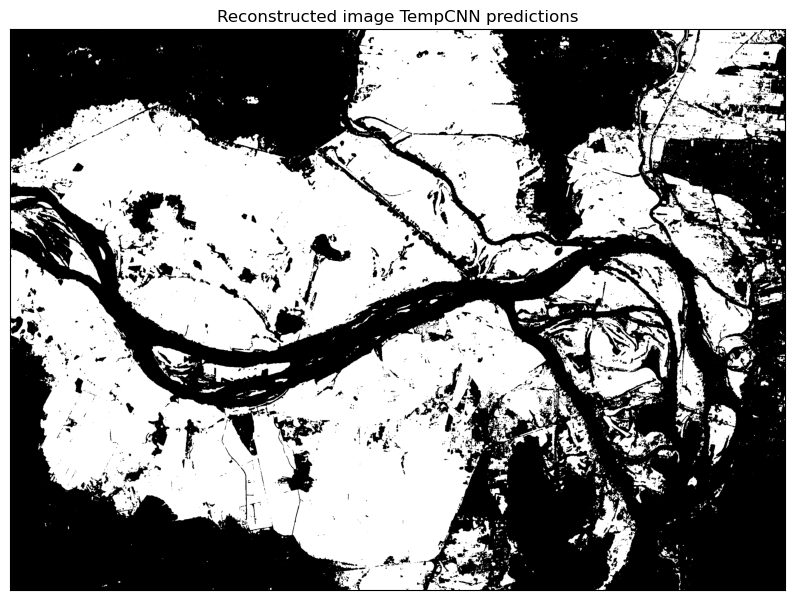

In [108]:
plt.figure(figsize=(10, 10))
plt.title('Reconstructed image TempCNN predictions')
# plt.xlabel('Columns')
# plt.ylabel('Rows')
# Remover a numeração dos eixos
plt.xticks([])
plt.yticks([])
plt.imshow(reconstructed, cmap='gray')

(1, 2176, 3008)

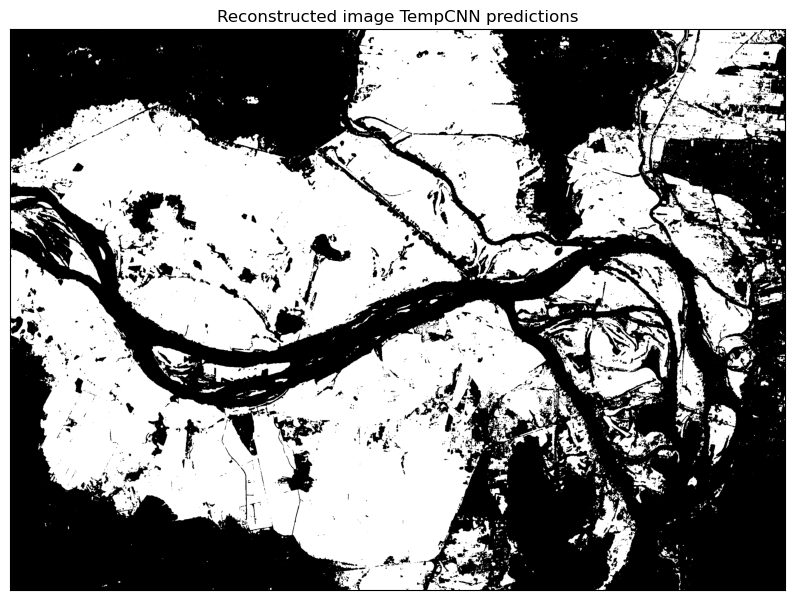

In [109]:
import rasterio
path = rasterio.open('/home/cesar/geoinformatica/ConvLSTM_TempCNN/predicts_reconstructed_tempcnn.tif').read()

# img = rasterio.open('../aulas/dados/geoinformatic_floods_paper/Sentinel2_classes.tif').read()
# path = img[:,300:2500,5156:8192] ##[:,300:2500,5156:8192] <-melhor balanceado #path = img[:,10:3000,5000:8400] 
plt.figure(figsize=(10, 10))
plt.title('Reconstructed image TempCNN predictions')
# plt.xlabel('Columns')
# plt.ylabel('Rows')
# Remover a numeração dos eixos
plt.xticks([])
plt.yticks([])
plt.imshow(path[0,:,:], cmap='gray');
path.shape

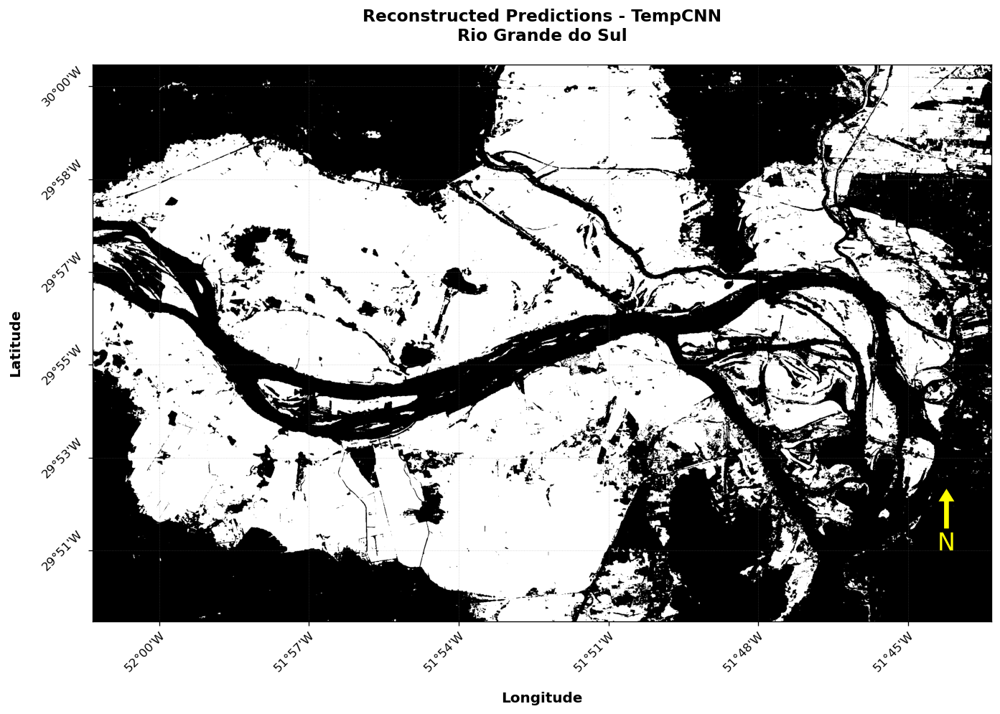

In [110]:
import numpy as np
import rasterio
from pyproj import CRS, Transformer
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator

# Funções de formatação de coordenadas melhoradas
def decimal_to_dms(value, coord_type):
    degrees = int(abs(value))
    minutes = int((abs(value) - degrees) * 60)
    hemisphere = 'W' if value < 0 else 'E' if coord_type == 'lon' else 'S' if value < 0 else 'N'
    return f"{degrees}°{minutes:02d}'{hemisphere}"  # :02d para minutos com dois dígitos

def lon_formatter(x, pos):
    return decimal_to_dms(x, 'lon')

def lat_formatter(y, pos):
    return decimal_to_dms(y, 'lat')

# Reconstrução da imagem (mantida igual)
reconstructed = reconstruct_image_from_patches(patches_pred, n_rows, n_cols, patch_size, patch_size)

ref_raster_path = '/home/cesar/geoinformatica/ConvLSTM_TempCNN/raster_out_concatenate_charter_t4.tif'
# Obtenção das coordenadas (mantida igual)
with rasterio.open(ref_raster_path) as src:
    transform = src.transform
    crs_utm = CRS(src.crs)

transformer = Transformer.from_crs(crs_utm, CRS("EPSG:4674"), always_xy=True)
min_x, max_y = transform * (0, 0)
max_x, min_y = transform * (reconstructed.shape[1], reconstructed.shape[0])
min_lon, min_lat = transformer.transform(min_x, min_y)
max_lon, max_lat = transformer.transform(max_x, max_y)

# Configuração da figura com melhorias
plt.figure(figsize=(12, 8), dpi=120)  # Aumentando o DPI para melhor qualidade
ax = plt.gca()

# Visualização da imagem com contraste aprimorado
img = ax.imshow(reconstructed, 
                cmap='gray',
                vmin=np.percentile(reconstructed, 5),  # Ajuste automático de contraste
                vmax=np.percentile(reconstructed, 95),
                extent=[min_lon, max_lon, max_lat, min_lat])

# Configuração dos eixos melhorada
ax.xaxis.set_major_formatter(plt.FuncFormatter(lon_formatter))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lat_formatter))
ax.tick_params(axis='both', which='major', labelsize=10)

# Definir intervalos regulares para os ticks
ax.xaxis.set_major_locator(MultipleLocator(base=(max_lon-min_lon)/6))  # 6 divisões
ax.yaxis.set_major_locator(MultipleLocator(base=(max_lat-min_lat)/6))

# Rotação e alinhamento dos rótulos
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', rotation_mode='anchor')
plt.setp(ax.get_yticklabels(), rotation=45, va='center')

# Labels and title
plt.xlabel("Longitude", fontsize=12, labelpad=15, fontweight='bold')
plt.ylabel("Latitude", fontsize=12, labelpad=15, fontweight='bold')
plt.title('Reconstructed Predictions - TempCNN\nRio Grande do Sul',
          fontsize=14, pad=20, fontweight='bold')

# Grid mais sutil
ax.grid(True, linestyle=':', color='gray', alpha=0.4, linewidth=0.5)

# # Norte posicionado
# ax.annotate('N', xy=(0.98, 0.98), xytext=(0.98, 0.88),
#             arrowprops=dict(facecolor='yellow', width=4, headwidth=12),
#             ha='center', va='center', fontsize=18,
#             xycoords=ax.transAxes)
# Adicionar a orientação do norte
x, y, arrow_length = 0.95, 0.24, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length), color='yellow',
            arrowprops=dict(facecolor='yellow', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Adicionar escala gráfica
scale_length = 0.1 * (max_lon - min_lon)  # 10% da largura
ax.plot([min_lon + 0.05*(max_lon-min_lon), min_lon + 0.05*(max_lon-min_lon) + scale_length],
        [min_lat + 0.05*(max_lat-min_lat), min_lat + 0.05*(max_lat-min_lat)],
        color='black', linewidth=2)
ax.text(min_lon + 0.05*(max_lon-min_lon) + scale_length/2,
        min_lat + 0.06*(max_lat-min_lat),
        f"{scale_length:.3f}°", ha='center', fontsize=10)

plt.tight_layout()
plt.savefig('/home/cesar/geoinformatica/ConvLSTM_TempCNN/predicoes_reconstruidas_tempcnn_Coordenadas.png', 
            dpi=300, bbox_inches='tight')
plt.show()

(1, 2200, 3036)

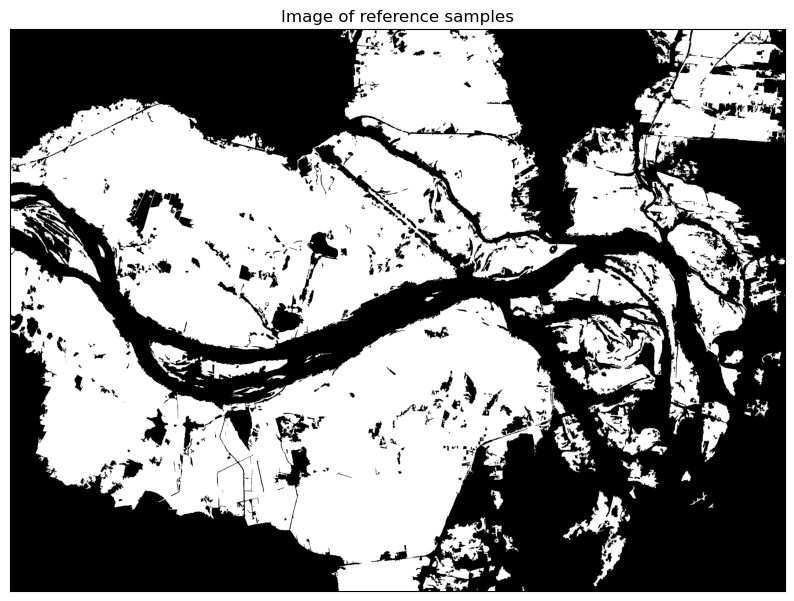

In [111]:
import rasterio
import matplotlib.pyplot as plt

path = rasterio.open('/home/cesar/geoinformatica/ConvLSTM_TempCNN/floods_classes.tif').read()

# img = rasterio.open('../aulas/dados/geoinformatic_floods_paper/Sentinel2_classes.tif').read()
# path = img[:,300:2500,5156:8192] ##[:,300:2500,5156:8192] <-melhor balanceado #path = img[:,10:3000,5000:8400] 
plt.figure(figsize=(10, 10))
plt.title('Image of reference samples')
# plt.xlabel('Columns')
# plt.ylabel('Rows')
# Remover a numeração dos eixos
plt.xticks([])
plt.yticks([])
plt.imshow(path[0,:,:], cmap='gray');
path.shape

CRS do Raster: PROJCS["WGS 84 / UTM zone 22S",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4326"]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",0],PARAMETER["central_meridian",-51],PARAMETER["scale_factor",0.9996],PARAMETER["false_easting",500000],PARAMETER["false_northing",10000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH],AUTHORITY["EPSG","32722"]]
Min Longitude: 52°2'W
Max Longitude: 51°43'W
Min Latitude: 29°49'S
Max Latitude: 30°1'S


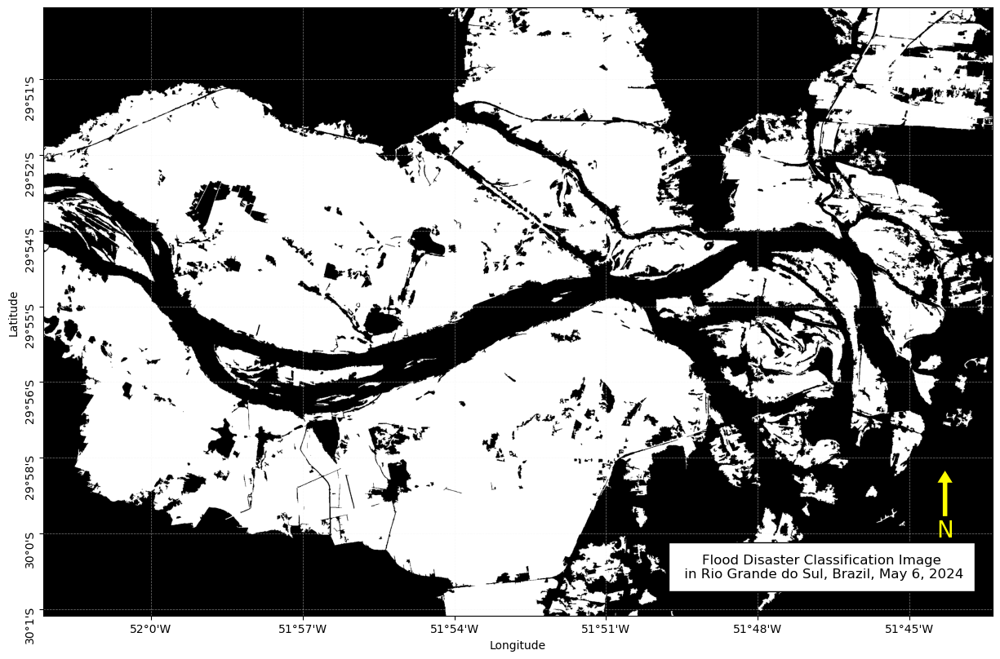

In [112]:
import rasterio
import matplotlib.pyplot as plt
from rasterio.warp import transform
from pyproj import CRS, Transformer

# Função para converter coordenadas de graus decimais para graus e minutos com hemisfério
def decimal_to_dms(value, coord_type):
    degrees = int(abs(value))
    minutes = int((abs(value) - degrees) * 60)
    hemisphere = ''
    if coord_type == 'lon':
        hemisphere = 'W' if value < 0 else 'E'
    elif coord_type == 'lat':
        hemisphere = 'S' if value < 0 else 'N'
    return f"{degrees}°{minutes}'{hemisphere}"

# Função para formatar coordenadas de longitude
def lon_formatter(x, pos):
    return decimal_to_dms(x, 'lon')

# Função para formatar coordenadas de latitude
def lat_formatter(y, pos):
    return decimal_to_dms(y, 'lat')

# Carregar a imagem raster com rasterio
path_to_raster = "/home/cesar/geoinformatica/ConvLSTM_TempCNN/floods_classes.tif"
dataset = rasterio.open(path_to_raster)

# Obter o sistema de referência de coordenadas do raster
crs_raster = CRS(dataset.crs)

# Verificar o CRS
print(f"CRS do Raster: {crs_raster}")

# Ler os dados e a transformação do raster
data = dataset.read(1)  # Assumindo que é uma banda de dados
transform = dataset.transform

# Obter coordenadas de latitude e longitude para as bordas do raster
min_x, min_y = transform * (0, 0)  # Canto inferior esquerdo
max_x, max_y = transform * (data.shape[1], data.shape[0])  # Canto superior direito

# Converter coordenadas para o sistema geográfico WGS84, se necessário
if not crs_raster.is_geographic:
    crs_wgs84 = CRS("EPSG:4674")  # WGS84 4326
    transformer = Transformer.from_crs(crs_raster, crs_wgs84, always_xy=True)
    min_x, min_y = transformer.transform(min_x, min_y)
    max_x, max_y = transformer.transform(max_x, max_y)

# Converter coordenadas para graus e minutos
min_lon_str = decimal_to_dms(min_x, 'lon')
max_lon_str = decimal_to_dms(max_x, 'lon')
min_lat_str = decimal_to_dms(min_y, 'lat')
max_lat_str = decimal_to_dms(max_y, 'lat')

print(f"Min Longitude: {min_lon_str}")
print(f"Max Longitude: {max_lon_str}")
print(f"Min Latitude: {min_lat_str}")
print(f"Max Latitude: {max_lat_str}")

# Plotar a imagem raster usando matplotlib
fig, ax = plt.subplots(1, figsize=(15, 10))

# # Plotar o raster com imshow e integração com o plt
# img = ax.imshow(data, cmap="gray", extent=[min_x, max_x, min_y, max_y])

# Plotar o raster com imshow e integração com o plt
img = ax.imshow(data, cmap="gray", extent=[min_x, max_x, max_y, min_y])  # Inverta max_lat e min_lat

# Personalizar rótulos e título do gráfico
plt.xlabel("Longitude")
plt.ylabel("Latitude")
# plt.title("Desastre de Inundação em Rio Grande do Sul, Brasil 06/05/2024")

# Adicionar coordenadas em graus e minutos nas bordas
ax.xaxis.set_major_formatter(plt.FuncFormatter(lon_formatter))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lat_formatter))

# Ajustar a rotação dos rótulos do eixo y (coordenadas de latitude)
ax.tick_params(axis='y', labelrotation=90)  # Girar rótulos do eixo y em 90 graus

# Inserir grids (opcional)
ax.grid(color='0.95', linestyle='dashed', linewidth=0.5, alpha=0.5)

# Plotar box de informações (pode ser ajustado conforme necessidade)
ax.text(0.82, 0.08, 'Flood Disaster Classification Image\n in Rio Grande do Sul, Brazil, May 6, 2024', fontsize=12, transform=ax.transAxes,
        ha='center', va='center', bbox={'facecolor': 'white', 'pad': 10})

# Adicionar a orientação do norte
x, y, arrow_length = 0.95, 0.24, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length), color='yellow',
            arrowprops=dict(facecolor='yellow', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Mostrar o gráfico na tela
plt.show()


In [100]:
##################################################################################

### Cross-validation K-fold
Verificação do desempenho em cada parte dos dados. Fazer novamente com mais GPU

In [ ]:
---

SyntaxError: invalid syntax (1947214667.py, line 1)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import TimeSeriesSplit
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

# Configuração
num_folds = 5
# Dimensões
nbclasses = 2  # Número de classes
n_bands = 12
l_patche = 64
input_shape = (1, l_patche, l_patche, n_bands)

# Função para preparar os dados
def preparar_dados(patche_cena, patche_classe, num_classes):
    y_onehot = one_hot_encode_labels(patche_classe, num_classes)
    X_reshaped = reshape_data(patche_cena, n_bands)
    return X_reshaped, y_onehot

# TimeSeriesSplit
tscv = TimeSeriesSplit(n_splits=num_folds)

# Armazenar resultados
all_scores = []
histories = []

# K-Fold Cross-Validation
for fold, (train_index, val_index) in enumerate(tscv.split(patche_cena_combined_reshape)):
    print(f'Fold {fold+1}/{num_folds}')
    # Total de dados - patche_cena_combined_reshape_, patche_classe_combined
    X_train, X_val = patche_cena_combined_reshape[train_index], patche_cena_combined_reshape[val_index]
    y_train, y_val = patche_classe_combined[train_index], patche_classe_combined[val_index]
    print(X_train.shape, y_train.shape, X_val.shape, y_val.shape)

    # Preparar os dados
    X_train_reshaped, y_train_onehot = preparar_dados(X_train, y_train, nbclasses)
    X_val_reshaped, y_val_onehot = preparar_dados(X_val, y_val, nbclasses)
    print(X_train_reshaped.shape, y_train_onehot.shape, X_val_reshaped.shape, y_val_onehot.shape)
    
    # Criar e compilar o modelo
    model = build_conv_lstm_classification_model(input_shape)
    model.compile(optimizer='adam',
                  loss='categorical_crossentropy', #combined_loss
                  metrics=['accuracy', iou_metric])

    # Definir callbacks
    callbacks = [
        EarlyStopping(monitor='val_loss', patience=10),
        ModelCheckpoint(f'model_fold_{fold+1}.keras', save_best_only=True)
    ]
    
    # Treinar o modelo
    history = model.fit(X_train_reshaped, y_train_onehot,
                        validation_data=(X_val_reshaped, y_val_onehot),
                        epochs=100,
                        batch_size=32,
                        callbacks=callbacks,
                        verbose=1)

    # Armazenar o histórico de treinamento
    histories.append(history.history)

    # Avaliar o modelo
    scores = model.evaluate(X_val_reshaped, y_val_onehot, verbose=0)
    print(f'Fold {fold+1} - Loss: {scores[0]}, Accuracy: {scores[1]}, IoU: {scores[2]}')
    all_scores.append(scores)

    # Limpar o modelo para o próximo fold
    K.clear_session()

# Calcular a média dos resultados após a validação cruzada
all_scores = np.array(all_scores)
media_loss = np.mean(all_scores[:, 0])
media_accuracy = np.mean(all_scores[:, 1])
media_iou = np.mean(all_scores[:, 2])

print(f'Média do Loss após validação cruzada: {media_loss}')
print(f'Média da Accuracy após validação cruzada: {media_accuracy}')
print(f'Média da IoU após validação cruzada: {media_iou}')

Fold 1/5
(960, 64, 64, 12) (960, 64, 64) (955, 64, 64, 12) (955, 64, 64)
(960, 1, 64, 64, 12) (960, 64, 64, 2) (955, 1, 64, 64, 12) (955, 64, 64, 2)


/home/cesar/anaconda3/envs/rsgislib/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 190ms/step - accuracy: 0.7189 - loss: 0.5298 - mean_io_u_2: 0.2514 - val_accuracy: 0.8955 - val_loss: 0.2787 - val_mean_io_u_2: 0.2500
Epoch 2/100
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 112ms/step - accuracy: 0.9130 - loss: 0.2432 - mean_io_u_2: 0.2500 - val_accuracy: 0.9168 - val_loss: 0.2464 - val_mean_io_u_2: 0.2500
Epoch 3/100
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.9313 - loss: 0.2032 - mean_io_u_2: 0.2500 - val_accuracy: 0.9224 - val_loss: 0.2314 - val_mean_io_u_2: 0.2500
Epoch 4/100
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9325 - loss: 0.1993 - mean_io_u_2: 0.2500 - val_accuracy: 0.9227 - val_loss: 0.2294 - val_mean_io_u_2: 0.2500
Epoch 5/100
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9346 - loss: 0.1947 - mean_io_u_2: 0.2500 - val_accuracy: 0.9229 - val_loss: 0.2271 - val_mean_io_u_2: 0.2500
Epoch 6/100
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.9353 - loss: 0.1922 - mean_io_u_2: 0.2500 - val

In [ ]:
history.history.keys()

## Salvar e carregar o modelo




In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
# copiando e salvando o ultimo modelo no drive - para novos treinamentos
# !cp /content/modelos/modelo_drive_08.h5 /content/drive/MyDrive/modelos/modelo_ssebastiao_aug_treina_8e.h5  # aug correto 01/08/2023

In [ ]:
# copiando modelo para colab
# !cp /content/drive/MyDrive/Models_Unet/modelo_ssebastiao_treina_25e.h5   modelo_ssebastiao_treina_25e.h5

In [ ]:
# from tensorflow.keras.utils import CustomObjectScope
# from tensorflow.keras.models import load_model
# model_ = load_model('modelo_ssebastiao_treina_25e.h5')

## Conclusão
### A avaliação dos resultados foi compreendida com a convergência do modelo de treinamento e a vizualização das segmentações dos rótudos, juntamente com a métrica IoU (*Intersection Over Union*), foi possível visualizar a melhora das predições com as máscaras de referência do conjunto de teste. Em trabalhos futuros o estudo continuará com comparações entre arquiteturas de modelos que implementem redes Convolucionais e Recorrentes conectadas. Além disso, o processamento das imagens deverão ser mais precisos, com registro (sem deslocamento) e um melhor segmento das máscaras de referência, considerando os mapas da *Charter* [3] como referência, e uma melhor segmentação das máscaras de referência pelo pacote RSGISLib [4].

## Referências
  - [1] [TensorFlow/Keras](https://www.tensorflow.org/api_docs/python/tf/keras/losses/SparseCategoricalCrossentropy)
  - [2] [Segmentação de Imagens com Python de A a Z](https://iaexpert.academy/cursos-online-assinatura/segmentacao-imagens-python-a-z/)
  - [3] [The International Charter Space and Major Disasters](https://disasterscharter.org/web/guest/activations/-/article/landslide-in-brazil-activation-758-)
  - [4] [RSGISLib Image Segmentation Module](http://rsgislib.org/rsgislib_segmentation.html)